# ML [SHIFT marathon + competition (winter_2023)](https://codalab.lisn.upsaclay.fr/competitions/10132)

## Описание и задача проекта

Задача кредитного скоринга возникает в банках и других кредитных организациях при принятии решений о выдаче кредитов. Задача заключается в том, чтобы на основе некоторой информации о заявителе обоснованно принять решение — стоит ли ему выдавать кредит, и если да, то на каких условиях. 

Необходимо провести разведочный анализ данных (EDA), придумать новые признаки на основе предложенных данных, поэкспериментировать с различными моделями машинного обучения, сделать с помощью этих моделей прогноз на тестовом датасете и загрузить ответы на страницу с результатами.

## Методология проекта
- Решить задачу **бинарной классификации, обучение с учителем**.
- Обучить несколько моделей машинного обучения (логистическая регрессия, деревья решений, рандомный лес).
- Подобрать гиперпараметры поиском по сетке или делением исходного датасета на обучающую и валидационную выборки.
- Выбрать наилучшую модель по метрике качества.
- Выполнить предсказания на тестовых данных, которые не видела модель в ходе обучения.

## Описание данных

- Данные представлены обучающей выборкой размером 29229 наблюдения и 121 признак, а также целевой признак находится в колонке *'target'*.
- Данные содержат пропуски, по природе пропусков пояснений нет.
- Также представлен тестовый датасет для проверки работы обученной модели.


## Команда: 
- **Иван**, телеграм *@jet0067*
- **Роман**, телеграм *@Renkr*
- **Юлия**, телеграм *@ybezginova*


In [12]:
pip install -q phik

Note: you may need to restart the kernel to use updated packages.


In [13]:
pip install -q pandas-profiling

Note: you may need to restart the kernel to use updated packages.


In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import lightgbm as lgb
import phik

from sklearn.dummy import DummyClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier, Pool
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from pandas_profiling import ProfileReport
from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder
from phik import resources, report

import warnings
warnings.simplefilter("ignore", category=RuntimeWarning)
pd.options.mode.chained_assignment = None

# 1 Загрузка данных

In [15]:
df = pd.read_csv('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift_ml_winter_2023/train.csv')

In [16]:
df.shape

(261384, 122)

In [17]:
df.keys()

Index(['reco_id_curr', 'target', 'contract_type_name', 'gender',
       'own_car_flag', 'own_realty_flag', 'children_count', 'income',
       'loan_body', 'annuity_payment',
       ...
       'document_18_flag', 'document_19_flag', 'document_20_flag',
       'document_21_flag', 'requests_bki_hour', 'requests_bki_day',
       'requests_bki_week', 'requests_bki_month', 'requests_bki_qrt',
       'requests_bki_year'],
      dtype='object', length=122)

In [18]:
df.head(40)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,annuity_payment,...,document_18_flag,document_19_flag,document_20_flag,document_21_flag,requests_bki_hour,requests_bki_day,requests_bki_week,requests_bki_month,requests_bki_qrt,requests_bki_year
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,0,0,0,0,0.0,0.0,0.0,1.0,0.0,1.0
1,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,48946.5,...,0,0,0,0,0.0,0.0,0.0,1.0,0.0,3.0
2,142232,0,Cash loans,F,Y,N,0,202500.0,495000.0,39109.5,...,0,0,0,0,0.0,0.0,0.0,1.0,0.0,3.0
3,389171,0,Cash loans,F,N,Y,0,247500.0,254700.0,24939.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
4,283617,0,Cash loans,M,N,Y,0,112500.0,308133.0,15862.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,4.0
5,362171,0,Cash loans,M,N,Y,0,85500.0,152820.0,16456.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
6,180689,0,Cash loans,F,N,N,1,112500.0,900000.0,24750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,2.0,0.0
7,310328,0,Cash loans,M,Y,Y,0,141606.0,810000.0,33120.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
8,233043,0,Cash loans,F,N,Y,0,130500.0,781920.0,34443.0,...,0,0,0,0,0.0,0.0,0.0,1.0,0.0,5.0
9,232220,0,Cash loans,F,N,Y,1,99000.0,900000.0,35824.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [313]:
df.shape

(261384, 122)

### *Вывод*:  данные содержат 122 колонки и 261384 наблюдения. Целевой признак находится в колонке *'target'*.

### Вспомогательные данные

In [19]:
previous_loan = pd.read_csv('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift_ml_winter_2023/previous_loan.csv')
previous_loan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 38 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   Unnamed: 0                          1670214 non-null  int64  
 1   reco_id_last                        1670214 non-null  int64  
 2   reco_id_curr                        1670214 non-null  int64  
 3   contract_type_name                  1670214 non-null  object 
 4   annuity_payment                     1297979 non-null  float64
 5   loan_body_requested                 1670214 non-null  float64
 6   loan_body                           1670213 non-null  float64
 7   first_payment                       774370 non-null   float64
 8   goods_price                         1284699 non-null  float64
 9   start_weekday_appr_process          1670214 non-null  object 
 10  hour_of_approval_process_start      1670214 non-null  int64  
 11  last_applic

In [20]:
prev = previous_loan[['down_payment_rate','interest_primary_rate',
'interest_privileged_rate', 'cash_loan_purpose_name', 'contract_status_name',
'days_decision',
'payment_type_name',
'reject_reason_code',
'type_suite_name',
'client_type_name',
'goods_category_name',
'portfolio_name',
'product_type_name',
'channel_type',
'area_seller_place',
'seller_industry_name',
'payment_count',
'yield_group_name',
'combination_of_product',
'days_first_drawing',
'days_first_due',
'first_due_date',
'last_due_date',
'termination_date',
'insured_last_f',
                     'reco_id_curr']]

In [21]:
df['target'].unique()

array([0, 1])

In [22]:
df['target'].describe().T

count    261384.000000
mean          0.080762
std           0.272470
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           1.000000
Name: target, dtype: float64

# 2 Предобработка данных

## 2.1 Уменьшение размерности матрицы признаков

### 2.1.1 Проверка на мультиколлинеарность

In [345]:
# панель
d = df.merge(prev)
d.tail(40)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,annuity_payment,...,seller_industry_name,payment_count,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
342422,143616,0,Cash loans,F,N,N,0,450000.0,225000.0,17905.5,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-925.0,-595.0,-895.0,-893.0,1.0
342423,143616,0,Cash loans,F,N,N,0,450000.0,225000.0,17905.5,...,XNA,18.0,middle,Cash X-Sell: middle,365243.0,-756.0,-246.0,-246.0,-235.0,1.0
342424,143616,0,Cash loans,F,N,N,0,450000.0,225000.0,17905.5,...,XNA,24.0,middle,Cash Street: middle,365243.0,-671.0,19.0,365243.0,365243.0,0.0
342425,143616,0,Cash loans,F,N,N,0,450000.0,225000.0,17905.5,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-1418.0,-1088.0,-1208.0,-1200.0,1.0
342426,143616,0,Cash loans,F,N,N,0,450000.0,225000.0,17905.5,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-1041.0,-711.0,-891.0,-886.0,1.0
342427,165695,1,Cash loans,F,N,Y,0,112500.0,715095.0,48109.5,...,Clothing,12.0,low_normal,POS industry with interest,365243.0,-1019.0,-689.0,-689.0,-683.0,0.0
342428,410536,0,Cash loans,M,Y,Y,0,225000.0,325282.5,16605.0,...,XNA,48.0,low_normal,Cash X-Sell: low,365243.0,-415.0,995.0,365243.0,365243.0,1.0
342429,410536,0,Cash loans,M,Y,Y,0,225000.0,325282.5,16605.0,...,XNA,24.0,middle,Cash X-Sell: middle,365243.0,-857.0,-167.0,-437.0,-422.0,1.0
342430,410536,0,Cash loans,M,Y,Y,0,225000.0,325282.5,16605.0,...,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN
342431,340068,0,Cash loans,M,N,Y,0,135000.0,265851.0,11394.0,...,Consumer electronics,12.0,low_normal,POS household with interest,365243.0,-318.0,12.0,365243.0,365243.0,0.0


In [23]:
data = df.merge(prev, on='reco_id_curr', how='left')
data

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,annuity_payment,...,seller_industry_name,payment_count,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,Consumer electronics,12.0,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,XNA,0.0,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,XNA,0.0,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,Consumer electronics,10.0,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,52641.0,...,XNA,6.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215947,291070,0,Cash loans,F,N,N,1,112500.0,315000.0,15151.5,...,XNA,48.0,middle,Cash X-Sell: middle,NaN,NaN,NaN,NaN,NaN,NaN
1215948,291070,0,Cash loans,F,N,N,1,112500.0,315000.0,15151.5,...,Furniture,24.0,middle,POS industry with interest,365243.0,-1188.0,-498.0,-888.0,-883.0,0.0
1215949,291070,0,Cash loans,F,N,N,1,112500.0,315000.0,15151.5,...,Consumer electronics,10.0,high,POS household with interest,365243.0,-2408.0,-2138.0,-2258.0,-2249.0,1.0
1215950,291070,0,Cash loans,F,N,N,1,112500.0,315000.0,15151.5,...,Connectivity,12.0,high,POS mobile with interest,365243.0,-2091.0,-1761.0,-1791.0,-1787.0,0.0


In [24]:
info = data[['contract_type_name', 
                 'own_realty_flag',
                 'children_count',
                 'income',
                 'loan_body',
                 'annuity_payment',
                 'goods_price',
                 'population_relative_region']]

In [25]:
info.corr()

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/3265620915.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  info.corr()


,children_count,income,loan_body,annuity_payment,goods_price,population_relative_region
children_count,1.000000,0.010949,0.002199,0.027673,-0.001596,-0.023476
income,0.010949,1.000000,0.158197,0.197654,0.159727,0.073935
loan_body,0.002199,0.158197,1.000000,0.759128,0.986321,0.087596
annuity_payment,0.027673,0.197654,0.759128,1.000000,0.763148,0.104916
goods_price,-0.001596,0.159727,0.986321,0.763148,1.000000,0.090350
population_relative_region,-0.023476,0.073935,0.087596,0.104916,0.090350,1.000000


In [26]:
(info.corr() > 0.8) | (info.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/2938189820.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (info.corr() > 0.8) | (info.corr() < - 0.8).columns


,children_count,income,loan_body,annuity_payment,goods_price,population_relative_region
children_count,True,True,True,True,True,True
income,True,True,True,True,True,True
loan_body,True,True,True,True,True,True
annuity_payment,True,True,True,True,True,True
goods_price,True,True,True,True,True,True
population_relative_region,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/3107957622.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (info.corr() > 0.8) | (info.corr() < - 0.8).columns,


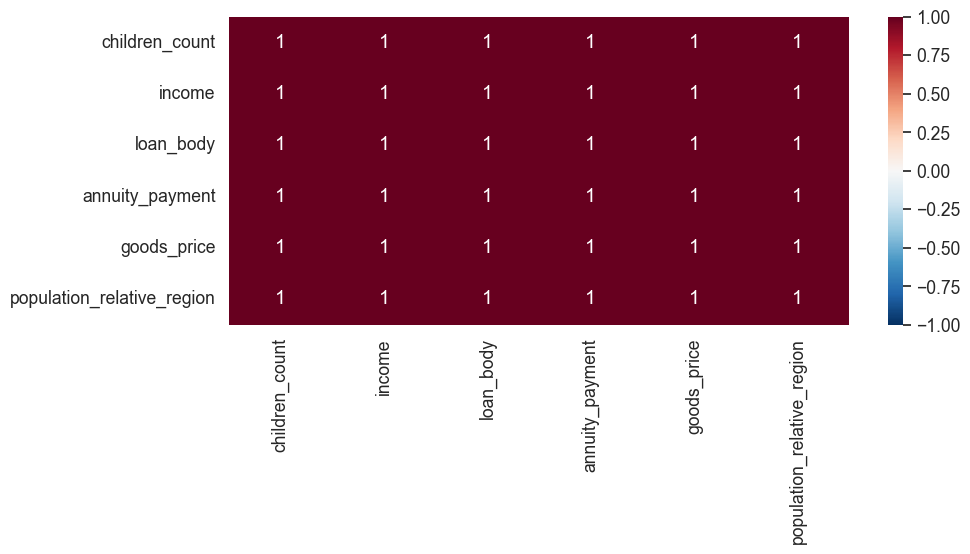

In [27]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,4))
sns.heatmap(
    (info.corr() > 0.8) | (info.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

### Исключить:
```
'goods_price',
'annuity_payment,
'population_relative_region'
```

In [28]:
social = data[['gender',
                'own_car_flag',
                 'days_birth',
                 'days_employed',
                 'registration_timestamp',
                 'publication_timestamp',
                 'age_own_car',
                  'mobile_flag']]

In [29]:
(social.corr() > 0.8) | (social.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/3661750310.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (social.corr() > 0.8) | (social.corr() < - 0.8).columns


,days_birth,days_employed,registration_timestamp,publication_timestamp,age_own_car,mobile_flag
days_birth,True,True,True,True,True,True
days_employed,True,True,True,True,True,True
registration_timestamp,True,True,True,True,True,True
publication_timestamp,True,True,True,True,True,True
age_own_car,True,True,True,True,True,True
mobile_flag,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/1640586573.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (social.corr() > 0.8) | (social.corr() < - 0.8).columns,


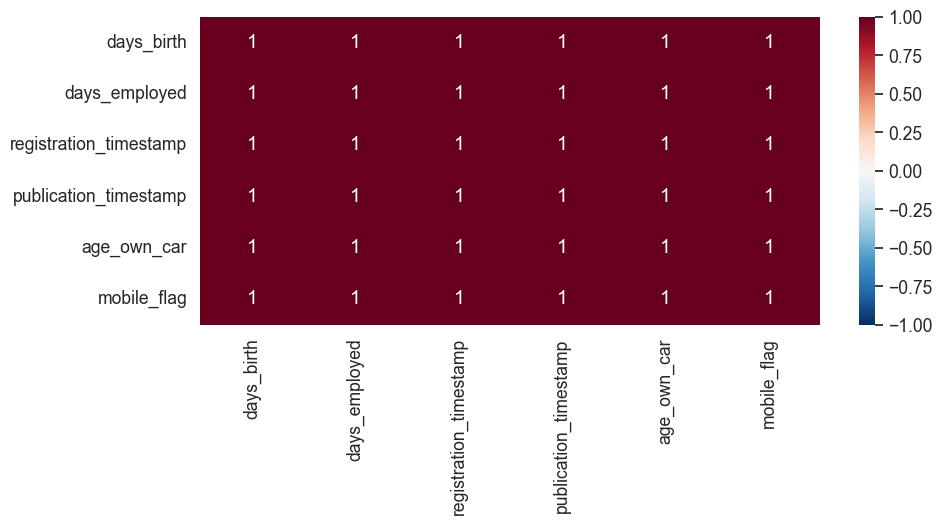

In [30]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,4))
sns.heatmap(
    (social.corr() > 0.8) | (social.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

### Исключить:
```
'publication_timestamp',
'registration_timestamp'

```

In [31]:
d1 = data[['employee_phone_flag',
                 'work_phone_flag',
                 'mobile_contact_flag',
                 'phone_flag',
                 'email_flag',
                 'type_of_occupation',
                 'family_members__count',
                 'rating_client_region',
                 'rating_client_w_city_region',
                 'start_weekday_appr_process',
                 'hour_of_approval_process_start',
                 'not_live_region_reg_region',
                 'not_work_region_reg_region',
                 'living_region_not_work_region_flag',
                 'not_live_city_reg_city',
                 'not_work_city_reg_city',
                 'external_source_1',
                 'external_source_2',
                 'external_source_3'
                ]]

In [32]:
(d1.corr() > 0.8) | (d1.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/2746260277.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d1.corr() > 0.8) | (d1.corr() < - 0.8).columns


,employee_phone_flag,work_phone_flag,mobile_contact_flag,phone_flag,email_flag,family_members__count,rating_client_region,rating_client_w_city_region,hour_of_approval_process_start,not_live_region_reg_region,not_work_region_reg_region,living_region_not_work_region_flag,not_live_city_reg_city,not_work_city_reg_city,external_source_1,external_source_2,external_source_3
employee_phone_flag,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
work_phone_flag,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
mobile_contact_flag,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
phone_flag,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
email_flag,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
family_members__count,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
rating_client_region,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
rating_client_w_city_region,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
hour_of_approval_process_start,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
not_live_region_reg_region,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/3570976631.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d1.corr() > 0.8) | (d1.corr() < - 0.8).columns,


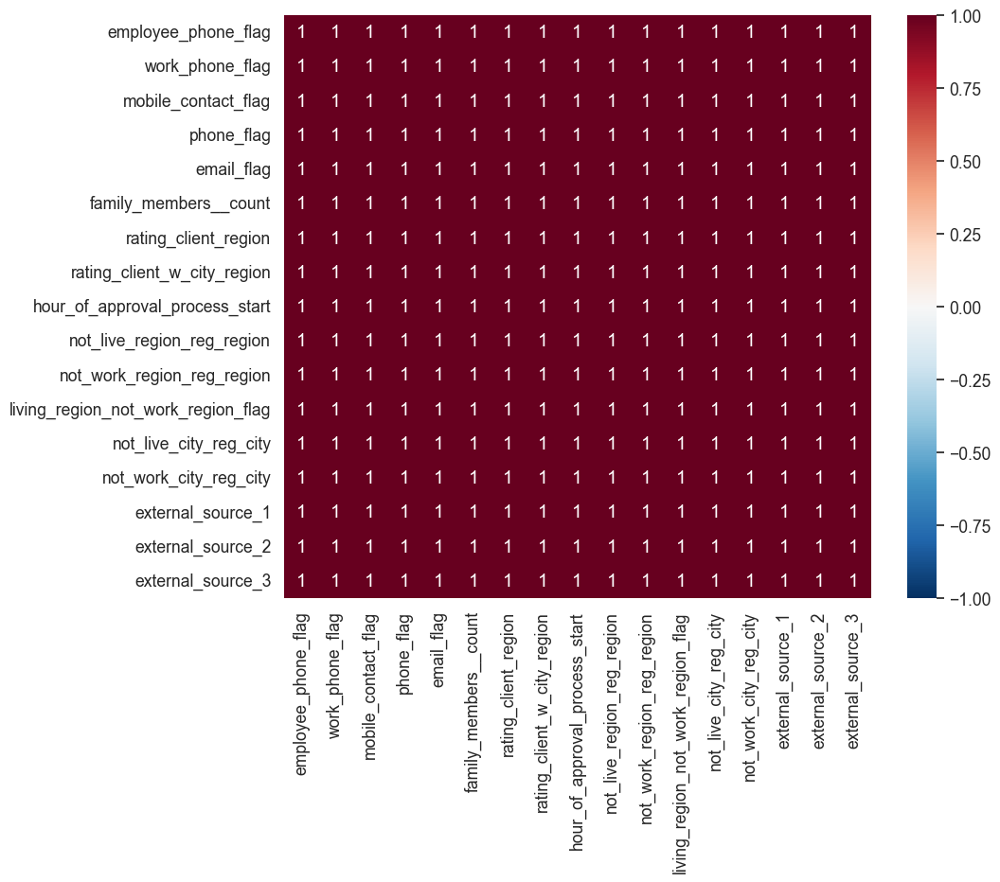

In [33]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,8))
sns.heatmap(
    (d1.corr() > 0.8) | (d1.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

### Исключить:
```
'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city'

```

In [34]:
d2 = data[['living_city_not_work_city_flag',
                 'average_apartments',
                 'average_basementarea',
                 'average_years_beginexpluatation',
                 'average_years_building',
                 'average_commonarea',
                 'average_elevator_count',
                 'average_entrance_count',
                 'average_max_floors',
                 'average_min_floors',
                 'average_land_area',
                 'average_living_apartments',
                 'average_living_area',
                 'non_living_apartments_avg',
                 'non_living_area_avg',
                 'mode_apartments',
                 'mode_basementarea',
                 'mode_years_beginexpluatation',
                 'mode_years_building',
                 'mode_commonarea',
                 'mode_elevator_count',
                 'mode_entrance_count',
                 'mode_max_floors',
                 'mode_min_floors'
                ]]

In [35]:
(d2.corr() > 0.8) | (d2.corr() < - 0.8).columns

,living_city_not_work_city_flag,average_apartments,average_basementarea,average_years_beginexpluatation,average_years_building,average_commonarea,average_elevator_count,average_entrance_count,average_max_floors,average_min_floors,...,non_living_area_avg,mode_apartments,mode_basementarea,mode_years_beginexpluatation,mode_years_building,mode_commonarea,mode_elevator_count,mode_entrance_count,mode_max_floors,mode_min_floors
living_city_not_work_city_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_apartments,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_basementarea,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_years_beginexpluatation,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_years_building,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_commonarea,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_elevator_count,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_entrance_count,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_max_floors,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
average_min_floors,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


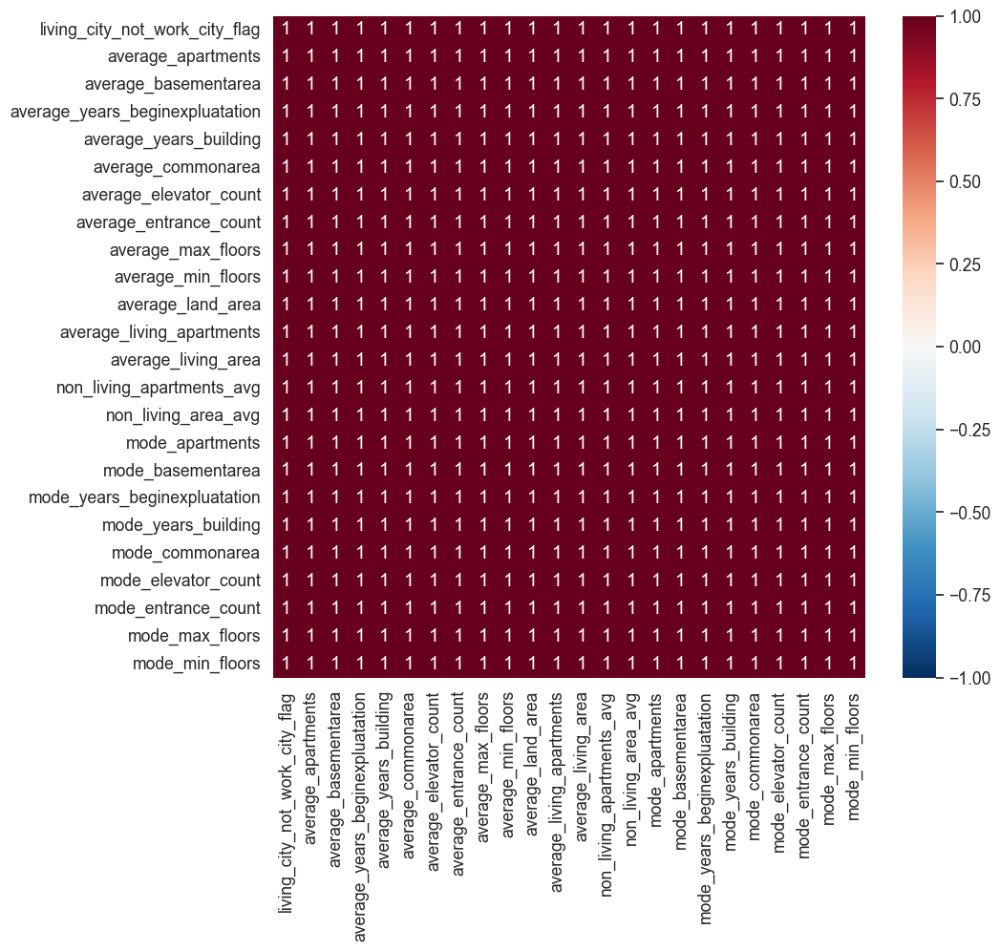

In [36]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,9))
sns.heatmap(
    (d2.corr() > 0.8) | (d2.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

Исключить:
```
'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors'


```

In [37]:
d3 = data[[ 'mode_land_area',
                 'mode_living_apartments',
                 'mode_living_area',
                 'non_living_apartments_mode',
                 'non_living_area_mode',
                 'median_apartments',
                 'median_basementarea',
                 'median_years_beginexpluatation',
                 'median_years_building',
                 'median_commonarea',
                 'median_elevator_count',
                 'median_entrance_count',
                 'median_max_floors',
                 'median_min_floors'
                 ]]

In [38]:
(d3.corr() > 0.8) | (d3.corr() < - 0.8) .columns

,mode_land_area,mode_living_apartments,mode_living_area,non_living_apartments_mode,non_living_area_mode,median_apartments,median_basementarea,median_years_beginexpluatation,median_years_building,median_commonarea,median_elevator_count,median_entrance_count,median_max_floors,median_min_floors
mode_land_area,True,True,True,True,True,True,True,True,True,True,True,True,True,True
mode_living_apartments,True,True,True,True,True,True,True,True,True,True,True,True,True,True
mode_living_area,True,True,True,True,True,True,True,True,True,True,True,True,True,True
non_living_apartments_mode,True,True,True,True,True,True,True,True,True,True,True,True,True,True
non_living_area_mode,True,True,True,True,True,True,True,True,True,True,True,True,True,True
median_apartments,True,True,True,True,True,True,True,True,True,True,True,True,True,True
median_basementarea,True,True,True,True,True,True,True,True,True,True,True,True,True,True
median_years_beginexpluatation,True,True,True,True,True,True,True,True,True,True,True,True,True,True
median_years_building,True,True,True,True,True,True,True,True,True,True,True,True,True,True
median_commonarea,True,True,True,True,True,True,True,True,True,True,True,True,True,True


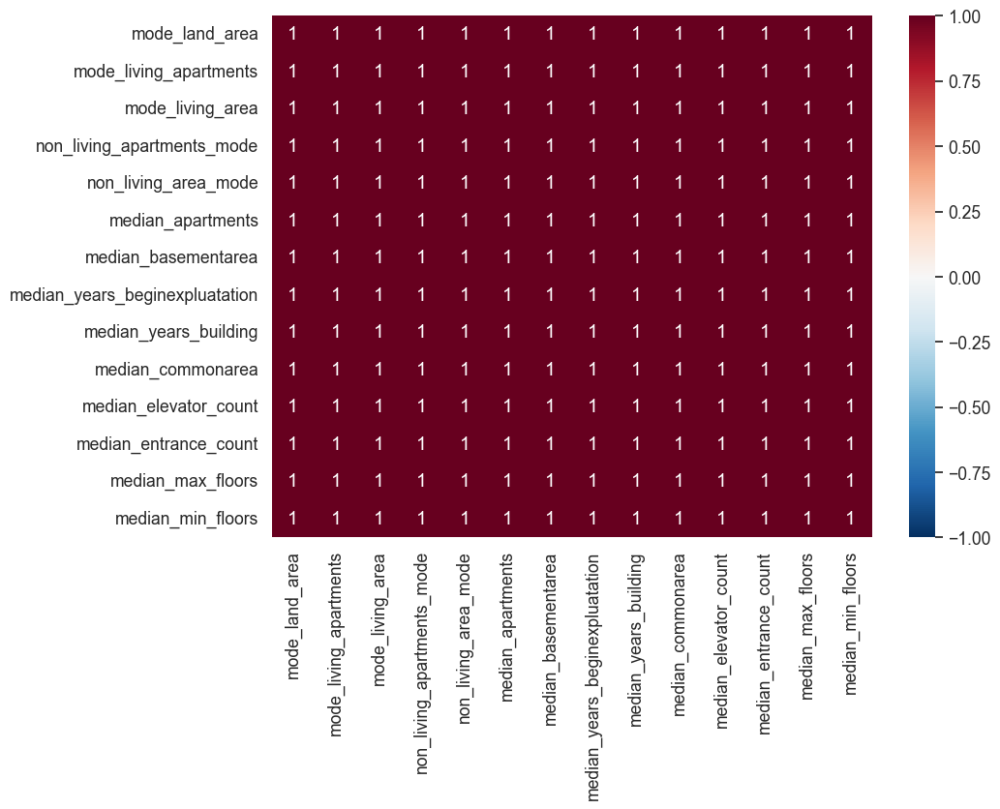

In [39]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,7))
sns.heatmap(
    (d3.corr() > 0.8) | (d3.corr() < - 0.8) .columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

Исключить:
```
'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors'

```

In [40]:
d4 = data[['median_land_area',
                 'median_living_apartments',
                 'median_living_area',
                 'non_living_apartments_medi',
                 'non_living_area_medi',
                 'fondkapremon_mode',
                 'mode_house_type',
                 'mode_total_area',
                 'mode_walls_material',
                 'emergency_state_mode',
                 'observes_30_count_social_circle',
                 'social_circle_defaults_30_days',
                 'observes_60_count_social_circle',
                 'social_circle_defaults_60_days',
                 'last_phone_number_change']]

In [41]:
(d4.corr() > 0.8) | (d4.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/4004357774.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d4.corr() > 0.8) | (d4.corr() < - 0.8).columns


,median_land_area,median_living_apartments,median_living_area,non_living_apartments_medi,non_living_area_medi,mode_total_area,observes_30_count_social_circle,social_circle_defaults_30_days,observes_60_count_social_circle,social_circle_defaults_60_days,last_phone_number_change
median_land_area,True,True,True,True,True,True,True,True,True,True,True
median_living_apartments,True,True,True,True,True,True,True,True,True,True,True
median_living_area,True,True,True,True,True,True,True,True,True,True,True
non_living_apartments_medi,True,True,True,True,True,True,True,True,True,True,True
non_living_area_medi,True,True,True,True,True,True,True,True,True,True,True
mode_total_area,True,True,True,True,True,True,True,True,True,True,True
observes_30_count_social_circle,True,True,True,True,True,True,True,True,True,True,True
social_circle_defaults_30_days,True,True,True,True,True,True,True,True,True,True,True
observes_60_count_social_circle,True,True,True,True,True,True,True,True,True,True,True
social_circle_defaults_60_days,True,True,True,True,True,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/1517785958.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d4.corr() > 0.8) | (d4.corr() < - 0.8).columns,


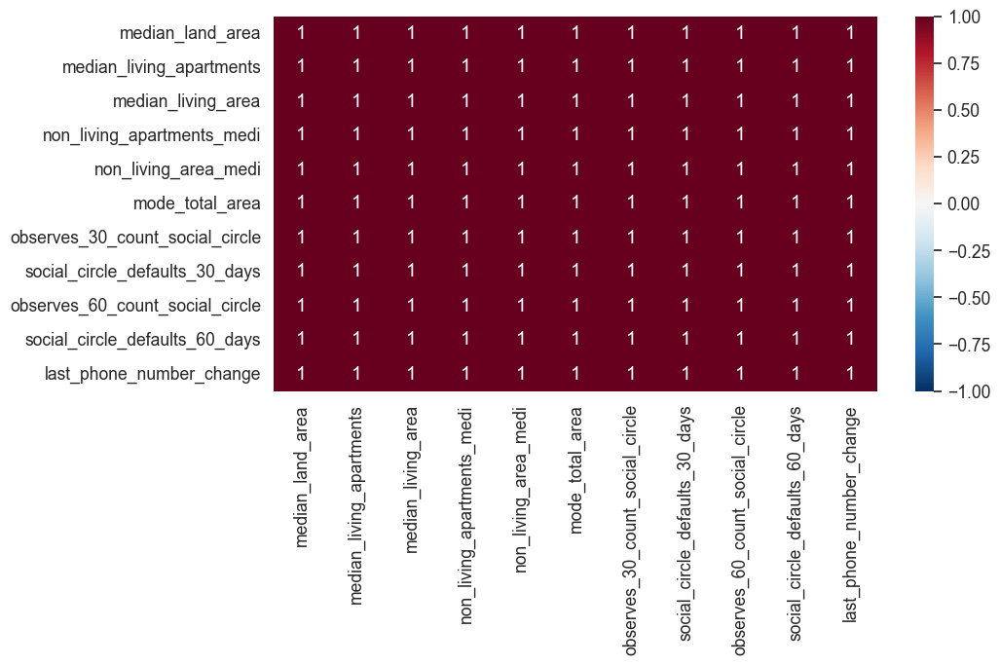

In [42]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,5))
sns.heatmap(
    (d4.corr() > 0.8) | (d4.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

Исключить:
```
'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle'


```

In [43]:
d5 = data[['down_payment_rate','interest_primary_rate',
'interest_privileged_rate', 'cash_loan_purpose_name', 'contract_status_name',
'days_decision',
'payment_type_name',
'reject_reason_code',
'type_suite_name_x',
'client_type_name',
'goods_category_name',
'portfolio_name',
'product_type_name',
'channel_type',
'area_seller_place',
'seller_industry_name',
'payment_count',
'yield_group_name',
'combination_of_product',
'days_first_drawing',
           
'days_first_due',
'first_due_date',
'last_due_date',
'termination_date',
'insured_last_f']]

In [44]:
(d5.corr() > 0.8) | (d5.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/125322977.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d5.corr() > 0.8) | (d5.corr() < - 0.8).columns


,down_payment_rate,interest_primary_rate,interest_privileged_rate,days_decision,area_seller_place,payment_count,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
down_payment_rate,True,True,True,True,True,True,True,True,True,True,True,True
interest_primary_rate,True,True,True,True,True,True,True,True,True,True,True,True
interest_privileged_rate,True,True,True,True,True,True,True,True,True,True,True,True
days_decision,True,True,True,True,True,True,True,True,True,True,True,True
area_seller_place,True,True,True,True,True,True,True,True,True,True,True,True
payment_count,True,True,True,True,True,True,True,True,True,True,True,True
days_first_drawing,True,True,True,True,True,True,True,True,True,True,True,True
days_first_due,True,True,True,True,True,True,True,True,True,True,True,True
first_due_date,True,True,True,True,True,True,True,True,True,True,True,True
last_due_date,True,True,True,True,True,True,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/2692931076.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d5.corr() > 0.8) | (d5.corr() < - 0.8).columns,


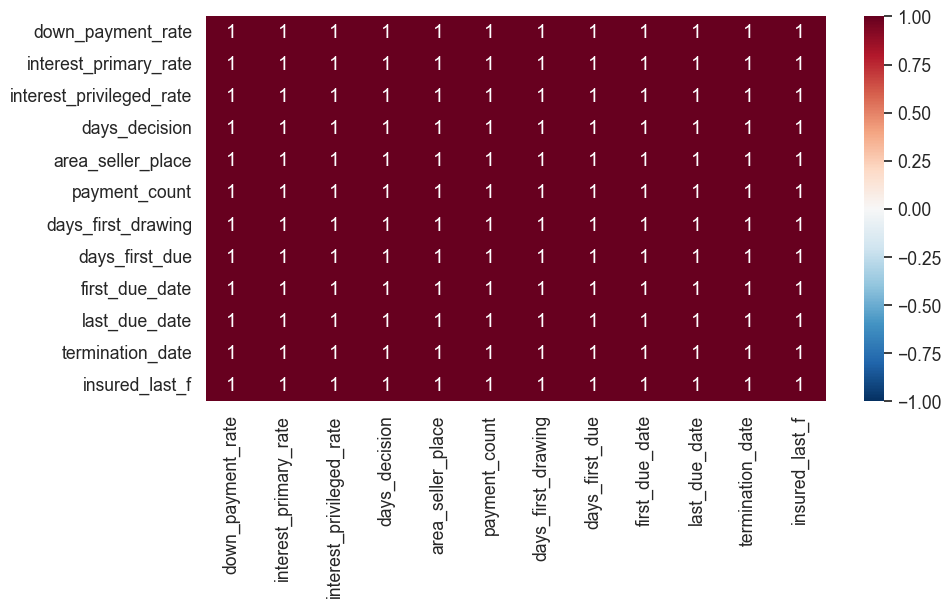

In [45]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,5))
sns.heatmap(
    (d5.corr() > 0.8) | (d5.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

Исключить:
```
'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count'

```

In [46]:
d6 = data[['mode_walls_material', 'emergency_state_mode', 'document_2_flag',
       'document_3_flag', 'document_4_flag', 'document_5_flag',
       'document_6_flag', 'document_7_flag', 'document_8_flag',
       'document_9_flag', 'document_10_flag', 'document_11_flag',
       'document_12_flag', 'document_13_flag', 'document_14_flag',
       'document_15_flag', 'document_16_flag', 'document_17_flag',
       'document_18_flag', 'document_19_flag', 'document_20_flag',
       'document_21_flag', 'requests_bki_hour', 'requests_bki_day',
       'requests_bki_week', 'requests_bki_month', 'requests_bki_qrt',
       'requests_bki_year', 'cash_loan_purpose_name', 'contract_status_name',
       'payment_type_name', 'reject_reason_code', 'type_suite_name_y',
       'client_type_name', 'goods_category_name', 'portfolio_name',
       'product_type_name', 'channel_type', 'seller_industry_name',
       'yield_group_name', 'combination_of_product']]

In [47]:
(d6.corr() > 0.8) | (d6.corr() < - 0.8).columns

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/3217161888.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d6.corr() > 0.8) | (d6.corr() < - 0.8).columns


,document_2_flag,document_3_flag,document_4_flag,document_5_flag,document_6_flag,document_7_flag,document_8_flag,document_9_flag,document_10_flag,document_11_flag,...,document_18_flag,document_19_flag,document_20_flag,document_21_flag,requests_bki_hour,requests_bki_day,requests_bki_week,requests_bki_month,requests_bki_qrt,requests_bki_year
document_2_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_3_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_4_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_5_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_6_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_7_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_8_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_9_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_10_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True
document_11_flag,True,True,True,True,True,True,True,True,True,True,...,True,True,True,True,True,True,True,True,True,True


/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/798470473.py:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  (d6.corr() > 0.8) | (d6.corr() < - 0.8).columns,


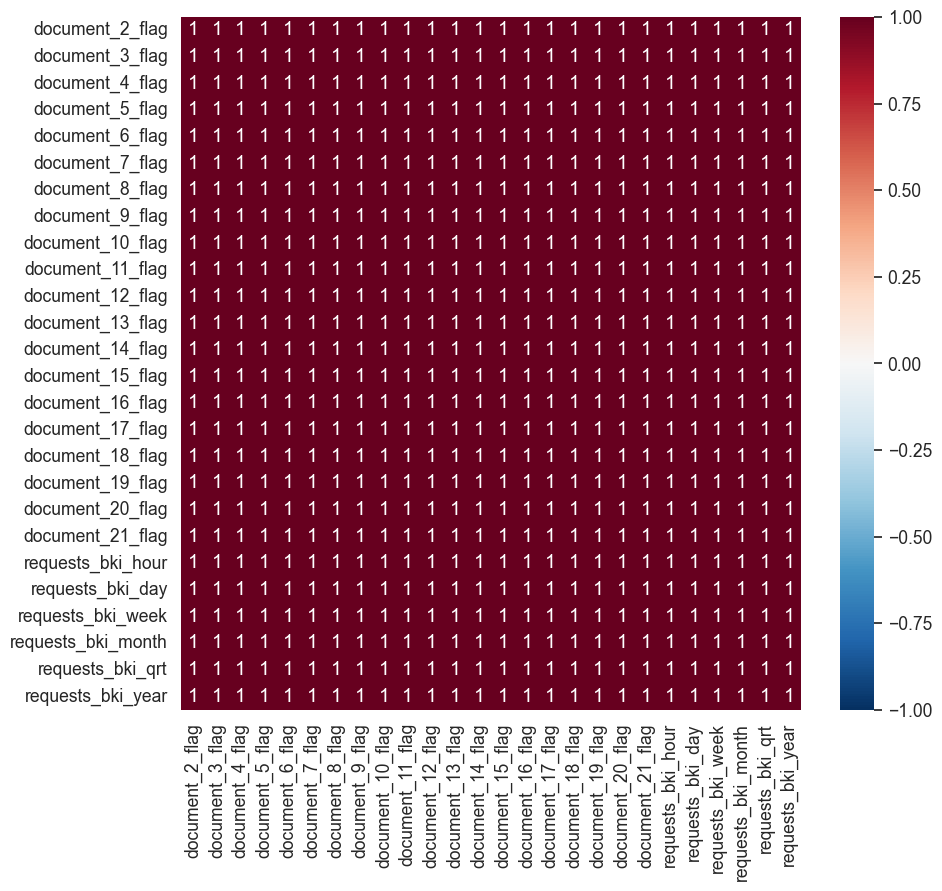

In [48]:
%matplotlib inline
sns.set(font_scale=1.15)
plt.figure(figsize=(10,9))
sns.heatmap(
    (d6.corr() > 0.8) | (d6.corr() < - 0.8).columns,        
    cmap='RdBu_r', # задаёт цветовую схему
    annot=True, # рисует значения внутри ячеек
    vmin=-1, vmax=1); # указывает начало цветовых кодов от -1 до 1.

Исключить:
```

'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt'

```

### *Вывод:* Таким образом, по результатам анализа корреляции Пирсона, следующие признаки мультиколлинеарны и должны быть исключены:

```

'goods_price',
'annuity_payment',
'population_relative_region',

'days_birth',
'publication_timestamp',
'registration_timestamp',

'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city',

'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors',

'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors',

'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle',

'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count',


'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt'

```

In [49]:
to_drop = data[[

'goods_price',
'annuity_payment',
'population_relative_region',

'publication_timestamp',
'registration_timestamp',

'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city',

'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors',

'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors',

'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle',

'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count',


'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt']]

In [50]:
to_drop.head()

,goods_price,annuity_payment,population_relative_region,publication_timestamp,registration_timestamp,external_source_1,external_source_2,not_work_region_reg_region,rating_client_region,work_phone_flag,...,document_17_flag,document_18_flag,document_19_flag,document_20_flag,document_21_flag,requests_bki_hour,requests_bki_day,requests_bki_week,requests_bki_month,requests_bki_qrt
0,418500.0,52641.0,0.00963,-4307,-637.0,0.675878,0.604894,0,2,0,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0
1,418500.0,52641.0,0.00963,-4307,-637.0,0.675878,0.604894,0,2,0,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0
2,418500.0,52641.0,0.00963,-4307,-637.0,0.675878,0.604894,0,2,0,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0
3,418500.0,52641.0,0.00963,-4307,-637.0,0.675878,0.604894,0,2,0,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0
4,418500.0,52641.0,0.00963,-4307,-637.0,0.675878,0.604894,0,2,0,...,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0


#### Удалим выбранные признаки и изучим уменьшенный датасет.

In [51]:
data_dropped = data.drop(columns=[

'goods_price',
'annuity_payment',
'population_relative_region',

'publication_timestamp',
'registration_timestamp',

'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city',

'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors',

'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors',

'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle',

'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count',

'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt'])

In [52]:
data_dropped.head()

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,type_suite_name_x,...,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Country-wide,Consumer electronics,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Country-wide,Consumer electronics,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [53]:
data_dropped.columns

Index(['reco_id_curr', 'target', 'contract_type_name', 'gender',
       'own_car_flag', 'own_realty_flag', 'children_count', 'income',
       'loan_body', 'type_suite_name_x', 'income_type_name',
       'education_type_name', 'family_status_name', 'housing_type_name',
       'days_birth', 'days_employed', 'age_own_car', 'mobile_flag',
       'employee_phone_flag', 'email_flag', 'type_of_occupation',
       'family_members__count', 'rating_client_w_city_region',
       'start_weekday_appr_process', 'hour_of_approval_process_start',
       'not_live_region_reg_region', 'living_region_not_work_region_flag',
       'not_live_city_reg_city', 'type_of_organization', 'external_source_3',
       'average_max_floors', 'average_living_apartments', 'median_apartments',
       'median_years_building', 'fondkapremon_mode', 'mode_house_type',
       'mode_walls_material', 'emergency_state_mode',
       'last_phone_number_change', 'requests_bki_year',
       'interest_primary_rate', 'cash_loan_purpos

In [54]:
data_dropped.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1215952 entries, 0 to 1215951
Data columns (total 60 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   reco_id_curr                        1215952 non-null  int64  
 1   target                              1215952 non-null  int64  
 2   contract_type_name                  1215952 non-null  object 
 3   gender                              1215952 non-null  object 
 4   own_car_flag                        1215952 non-null  object 
 5   own_realty_flag                     1215952 non-null  object 
 6   children_count                      1215952 non-null  int64  
 7   income                              1215952 non-null  float64
 8   loan_body                           1215952 non-null  float64
 9   type_suite_name_x                   1212549 non-null  object 
 10  income_type_name                    1215952 non-null  object 
 11  education_t

In [55]:
data_dr = data_dropped.drop(columns=['client_type_name',
'average_max_floors',
'median_years_building',
                                     'interest_primary_rate',
'type_suite_name_y',
'days_first_drawing'])

In [56]:
data_dr.head()

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,type_suite_name_x,...,product_type_name,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,XNA,Country-wide,Consumer electronics,high,POS household with interest,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,XNA,Country-wide,Consumer electronics,middle,POS household with interest,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,walk-in,Credit and cash offices,XNA,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN


### *Вывод:* По итогам анализа мультиколлинеаности кэффициоентом Пирсона в итоговом датасете остались 53 признака, из них - один целевой и один - уникальный ID клиента. Однако, в рамках анализа коэффициентов корреляции Пирсона были изучены только числовые признаки. Для анализа мультиколлинеарности категориальных переменных используем техники ниже.

### 2.1.2 Проверка на мультиколлинеарность c использованием иных техник

In [57]:
considered_features = data_dr.drop(columns=['reco_id_curr', 'target'])

In [58]:
considered_features.head()

,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,type_suite_name_x,income_type_name,education_type_name,...,product_type_name,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,Commercial associate,Secondary / secondary special,...,XNA,Country-wide,Consumer electronics,high,POS household with interest,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,Commercial associate,Secondary / secondary special,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN
2,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,Commercial associate,Secondary / secondary special,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN
3,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,Commercial associate,Secondary / secondary special,...,XNA,Country-wide,Consumer electronics,middle,POS household with interest,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,Commercial associate,Secondary / secondary special,...,walk-in,Credit and cash offices,XNA,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN


In [59]:
pd.DataFrame(round(considered_features.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
type_suite_name_x,0.000000
income_type_name,0.000000
education_type_name,0.000000


In [60]:
considered_features.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1215952 entries, 0 to 1215951
Data columns (total 52 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   contract_type_name                  1215952 non-null  object 
 1   gender                              1215952 non-null  object 
 2   own_car_flag                        1215952 non-null  object 
 3   own_realty_flag                     1215952 non-null  object 
 4   children_count                      1215952 non-null  int64  
 5   income                              1215952 non-null  float64
 6   loan_body                           1215952 non-null  float64
 7   type_suite_name_x                   1212549 non-null  object 
 8   income_type_name                    1215952 non-null  object 
 9   education_type_name                 1215952 non-null  object 
 10  family_status_name                  1215952 non-null  object 
 11  housing_typ

In [61]:
considered_features.columns

Index(['contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag',
       'children_count', 'income', 'loan_body', 'type_suite_name_x',
       'income_type_name', 'education_type_name', 'family_status_name',
       'housing_type_name', 'days_birth', 'days_employed', 'age_own_car',
       'mobile_flag', 'employee_phone_flag', 'email_flag',
       'type_of_occupation', 'family_members__count',
       'rating_client_w_city_region', 'start_weekday_appr_process',
       'hour_of_approval_process_start', 'not_live_region_reg_region',
       'living_region_not_work_region_flag', 'not_live_city_reg_city',
       'type_of_organization', 'external_source_3',
       'average_living_apartments', 'median_apartments', 'fondkapremon_mode',
       'mode_house_type', 'mode_walls_material', 'emergency_state_mode',
       'last_phone_number_change', 'requests_bki_year',
       'cash_loan_purpose_name', 'contract_status_name', 'payment_type_name',
       'reject_reason_code', 'goods_category_name',

In [62]:
considered_features['housing_type_name'].value_counts()

House / apartment      1088001
With parents             53062
Municipal apartment      44272
Rented apartment         16954
Office apartment          9831
Co-op apartment           3832
Name: housing_type_name, dtype: int64

In [63]:
considered_features['type_of_occupation'].value_counts()

Laborers                 215224
Sales staff              129895
Core staff               102384
Managers                  82051
Drivers                   71909
High skill tech staff     42327
Accountants               36349
Medicine staff            34265
Security staff            27202
Cooking staff             24640
Cleaning staff            20670
Private service staff     10321
Low-skill Laborers         7835
Waiters/barmen staff       5275
Secretaries                4943
Realty agents              3127
HR staff                   2037
IT staff                   1540
Name: type_of_occupation, dtype: int64

In [64]:
considered_features['start_weekday_appr_process'].value_counts()

TUESDAY      214005
WEDNESDAY    203156
MONDAY       201623
THURSDAY     198147
FRIDAY       197615
SATURDAY     135672
SUNDAY        65734
Name: start_weekday_appr_process, dtype: int64

In [65]:
considered_features['mode_house_type'].value_counts()

block of flats      600476
specific housing      6213
terraced house        4847
Name: mode_house_type, dtype: int64

In [66]:
considered_features['mode_walls_material'].value_counts()

Panel           262725
Stone, brick    258708
Block            37590
Wooden           21600
Mixed             9991
Others            6599
Monolithic        6597
Name: mode_walls_material, dtype: int64

In [67]:
considered_features['emergency_state_mode'].value_counts()

No     635349
Yes      9704
Name: emergency_state_mode, dtype: int64

In [68]:
considered_features['income_type_name'].value_counts()

Working                 621531
Commercial associate    277944
Pensioner               235217
State servant            81097
Unemployed                 113
Student                     23
Maternity leave             18
Businessman                  9
Name: income_type_name, dtype: int64

In [69]:
considered_features['education_type_name'].value_counts()

Secondary / secondary special    890423
Higher education                 271093
Incomplete higher                 39169
Lower secondary                   14745
Academic degree                     522
Name: education_type_name, dtype: int64

In [70]:
considered_features['family_status_name'].value_counts()

Married                 783437
Single / not married    160662
Civil marriage          122715
Separated                78800
Widow                    70336
Unknown                      2
Name: family_status_name, dtype: int64

In [71]:
considered_features['own_realty_flag'].value_counts()

Y    875746
N    340206
Name: own_realty_flag, dtype: int64

In [72]:
considered_features['type_suite_name_x'].value_counts()

Unaccompanied      992555
Family             158030
Spouse, partner     40190
Children            12111
Other_B              6057
Other_A              2576
Group of people      1030
Name: type_suite_name_x, dtype: int64

In [73]:
considered_features['own_car_flag'].value_counts()

N    806510
Y    409442
Name: own_car_flag, dtype: int64

In [74]:
considered_features['contract_type_name'].value_counts()

Cash loans         1122833
Revolving loans      93119
Name: contract_type_name, dtype: int64

In [75]:
considered_features['type_of_occupation'].unique()

array(['Sales staff', 'Managers', 'High skill tech staff', 'Laborers',
       nan, 'Core staff', 'Accountants', 'Low-skill Laborers', 'Drivers',
       'Medicine staff', 'Secretaries', 'Security staff', 'Cooking staff',
       'Cleaning staff', 'IT staff', 'Private service staff',
       'Waiters/barmen staff', 'HR staff', 'Realty agents'], dtype=object)

In [76]:
considered_features['fondkapremon_mode'].unique()

array([nan, 'reg oper account', 'org spec account',
       'reg oper spec account', 'not specified'], dtype=object)

In [77]:
considered_features['fondkapremon_mode'] = considered_features['fondkapremon_mode'].fillna('not specified')

In [78]:
considered_features['gender'].value_counts()

F      820257
M      395640
XNA        55
Name: gender, dtype: int64

In [79]:
# sing drop() to delete rows based on column value
considered_features.drop(considered_features[considered_features['gender'] == 'XNA'].index, inplace = True)

In [80]:
considered_features['gender'].value_counts()

F    820257
M    395640
Name: gender, dtype: int64

In [81]:
considered_features['gender'] = considered_features['gender'].dropna()

In [82]:
considered_features['mode_house_type'].unique()

array([nan, 'block of flats', 'terraced house', 'specific housing'],
      dtype=object)

In [83]:
considered_features['emergency_state_mode'] = considered_features['emergency_state_mode'].fillna('No')

In [84]:
considered_features['mode_walls_material'].unique()

array([nan, 'Monolithic', 'Panel', 'Stone, brick', 'Block', 'Wooden',
       'Mixed', 'Others'], dtype=object)

In [85]:
considered_features['emergency_state_mode'].unique()

array(['No', 'Yes'], dtype=object)

In [86]:
considered_features['emergency_state_mode'] = considered_features['emergency_state_mode'].fillna('No')

In [87]:
# filling with most common class
considered_features = considered_features.apply(lambda x: x.fillna(x.value_counts().index[0]))

In [88]:
pd.DataFrame(round(considered_features.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
type_suite_name_x,0.000000
income_type_name,0.000000
education_type_name,0.000000


In [89]:
considered_features.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1215897 entries, 0 to 1215951
Data columns (total 52 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   contract_type_name                  1215897 non-null  object 
 1   gender                              1215897 non-null  object 
 2   own_car_flag                        1215897 non-null  object 
 3   own_realty_flag                     1215897 non-null  object 
 4   children_count                      1215897 non-null  int64  
 5   income                              1215897 non-null  float64
 6   loan_body                           1215897 non-null  float64
 7   type_suite_name_x                   1215897 non-null  object 
 8   income_type_name                    1215897 non-null  object 
 9   education_type_name                 1215897 non-null  object 
 10  family_status_name                  1215897 non-null  object 
 11  housing_typ

### *Кодирование признаков ниже никак не связано с обучением модели и проводится исключительно для того, чтобы уменьшить размерность матрицы признаков.*

In [90]:
# define ordinal encoding
ordinalencoder = OrdinalEncoder()

# transform data
result = ordinalencoder.fit_transform(considered_features[['contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag',
       'type_suite_name_x', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'type_of_occupation', 'type_of_organization',
'fondkapremon_mode', 'mode_house_type',
       'mode_walls_material', 'emergency_state_mode']])

result = pd.DataFrame(result, columns = ['contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag',
       'type_suite_name_x', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'type_of_occupation', 'type_of_organization',
'fondkapremon_mode', 'mode_house_type',
       'mode_walls_material', 'emergency_state_mode'])

print(type(result))

<class 'pandas.core.frame.DataFrame'>


In [91]:
# удалим колонки, которые хотим кодировать
df_dropped = considered_features.drop(['contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag',
       'type_suite_name_x', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'type_of_occupation', 'type_of_organization',
'fondkapremon_mode', 'mode_house_type',
       'mode_walls_material', 'emergency_state_mode'], axis=1)

df_dropped

,children_count,income,loan_body,days_birth,days_employed,age_own_car,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,product_type_name,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,XNA,Country-wide,Consumer electronics,high,POS household with interest,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,365243.0,365243.0,365243.0,365243.0,0.0
2,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,walk-in,Credit and cash offices,XNA,XNA,Card Street,365243.0,365243.0,365243.0,365243.0,0.0
3,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,XNA,Country-wide,Consumer electronics,middle,POS household with interest,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,walk-in,Credit and cash offices,XNA,high,Cash Street: high,365243.0,365243.0,365243.0,365243.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215947,1,112500.0,315000.0,-15659,-5143,7.0,1,1,0,3.0,...,x-sell,AP+ (Cash loan),XNA,middle,Cash X-Sell: middle,365243.0,365243.0,365243.0,365243.0,0.0
1215948,1,112500.0,315000.0,-15659,-5143,7.0,1,1,0,3.0,...,XNA,Stone,Furniture,middle,POS industry with interest,-1188.0,-498.0,-888.0,-883.0,0.0
1215949,1,112500.0,315000.0,-15659,-5143,7.0,1,1,0,3.0,...,XNA,Stone,Consumer electronics,high,POS household with interest,-2408.0,-2138.0,-2258.0,-2249.0,1.0
1215950,1,112500.0,315000.0,-15659,-5143,7.0,1,1,0,3.0,...,XNA,Regional / Local,Connectivity,high,POS mobile with interest,-2091.0,-1761.0,-1791.0,-1787.0,0.0


In [92]:
# объединим закодированные колонки и наш основной датасет (с удаленными категориальными признаками)
df_final = df_dropped.join(result)
df_final.dropna()

,children_count,income,loan_body,days_birth,days_employed,age_own_car,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,income_type_name,education_type_name,family_status_name,housing_type_name,type_of_occupation,type_of_organization,fondkapremon_mode,mode_house_type,mode_walls_material,emergency_state_mode
0,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
1,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
2,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
3,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
4,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215892,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215893,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215894,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215895,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0


In [93]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1215897 entries, 0 to 1215951
Data columns (total 52 columns):
 #   Column                              Non-Null Count    Dtype  
---  ------                              --------------    -----  
 0   children_count                      1215897 non-null  int64  
 1   income                              1215897 non-null  float64
 2   loan_body                           1215897 non-null  float64
 3   days_birth                          1215897 non-null  int64  
 4   days_employed                       1215897 non-null  int64  
 5   age_own_car                         1215897 non-null  float64
 6   mobile_flag                         1215897 non-null  int64  
 7   employee_phone_flag                 1215897 non-null  int64  
 8   email_flag                          1215897 non-null  int64  
 9   family_members__count               1215897 non-null  float64
 10  rating_client_w_city_region         1215897 non-null  int64  
 11  start_weekd

In [94]:
df_final = df_final.dropna()
df_final

,children_count,income,loan_body,days_birth,days_employed,age_own_car,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,income_type_name,education_type_name,family_status_name,housing_type_name,type_of_occupation,type_of_organization,fondkapremon_mode,mode_house_type,mode_walls_material,emergency_state_mode
0,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
1,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
2,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
3,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
4,2,207000.0,465457.5,-13297,-762,19.0,1,1,0,4.0,...,1.0,4.0,1.0,1.0,14.0,5.0,0.0,0.0,4.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215892,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215893,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215894,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0
1215895,1,67500.0,189000.0,-10615,-962,7.0,1,1,1,3.0,...,7.0,4.0,0.0,1.0,6.0,5.0,2.0,0.0,4.0,0.0


### 2.1.3 VIF, Variance Inflation Factor

### Поиск зависимостей между категориальными признаками проводим с помощью [коэффициента VIF](https://towardsdatascience.com/targeting-multicollinearity-with-python-3bd3b4088d0b).

In [95]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

In [96]:
# compute the vif for all given features
def calc_vif(data, columns):
    
    X = data[columns]
    # the calculation of variance inflation requires a constant
    X['intercept'] = 1
    
    # create dataframe to store vif values
    vif = pd.DataFrame()
    vif["Variable"] = X.columns
    vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    vif = vif[vif['Variable']!='intercept']
    return vif

In [97]:
calc_vif(df_final, ['contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag',
       'type_suite_name_x', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'type_of_occupation', 'type_of_organization',
'fondkapremon_mode', 'mode_house_type', 'mode_walls_material', 'emergency_state_mode'])

,Variable,VIF
0,contract_type_name,1.005789
1,gender,1.174454
2,own_car_flag,1.167194
3,own_realty_flag,1.050621
4,type_suite_name_x,1.007374
5,income_type_name,1.052526
6,education_type_name,1.042397
7,family_status_name,1.038007
8,housing_type_name,1.053469
9,type_of_occupation,1.016449


### *Вывод:* Техника VIF не привела к существенным результатам, так как все показатели < 5, а значит, принять решение, какую колонку исключить, нельзя. Однако категориальных признаков по-прежнему много, обратимся к показателю Phi_K, который анализирует categorical, ordinal и интервальные переменные, демонстрируя не только линейные, но и нелинейные зависимости между признаками.

### 2.1.4 Поиск зависимостей между категориальными переменными с использованием [анализатора Phi_K](https://phik.readthedocs.io/en/latest/introduction.html)

In [98]:
pip install -q --upgrade pip

Note: you may need to restart the kernel to use updated packages.


In [99]:
pip install -q dill

Note: you may need to restart the kernel to use updated packages.


In [100]:
import dill as pickle
from joblib import Parallel, delayed

In [101]:
# get the significance matrix (expressed as one-sided Z)
# of the hypothesis test of each variable-pair dependency
# get the phi_k correlation matrix between all variables
df_final.significance_matrix()

interval columns not set, guessing: ['children_count', 'income', 'loan_body', 'days_birth', 'days_employed', 'age_own_car', 'mobile_flag', 'employee_phone_flag', 'email_flag', 'family_members__count', 'rating_client_w_city_region', 'hour_of_approval_process_start', 'not_live_region_reg_region', 'living_region_not_work_region_flag', 'not_live_city_reg_city', 'external_source_3', 'average_living_apartments', 'median_apartments', 'last_phone_number_change', 'requests_bki_year', 'days_first_due', 'first_due_date', 'last_due_date', 'termination_date', 'insured_last_f', 'contract_type_name', 'gender', 'own_car_flag', 'own_realty_flag', 'type_suite_name_x', 'income_type_name', 'education_type_name', 'family_status_name', 'housing_type_name', 'type_of_occupation', 'type_of_organization', 'fondkapremon_mode', 'mode_house_type', 'mode_walls_material', 'emergency_state_mode']


,children_count,income,loan_body,days_birth,days_employed,age_own_car,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,income_type_name,education_type_name,family_status_name,housing_type_name,type_of_occupation,type_of_organization,fondkapremon_mode,mode_house_type,mode_walls_material,emergency_state_mode
children_count,899.539695,0.940925,11.640414,363.449901,200.234959,60.390250,0.297448,200.195156,15.302816,643.176120,...,79.468492,9.178953,73.070275,10.478985,33.797518,71.233960,16.268656,2.988756,14.739006,-0.611065
income,0.940925,18.919624,4.639596,3.079534,1.420293,3.175481,3.684115,1.427466,0.422291,1.799370,...,0.344972,3.217007,1.047290,3.659549,0.849635,1.872662,1.358099,-0.127659,1.359050,0.232249
loan_body,11.640414,4.639596,1745.808440,224.910569,79.336433,34.521150,0.347270,79.241582,16.850936,20.384967,...,51.943335,42.469635,62.949752,18.654045,46.730746,35.465234,17.697803,6.721117,10.662321,4.162624
days_birth,363.449901,3.079534,224.910569,2333.720619,807.053091,127.908323,1.271908,806.955911,111.966793,535.548136,...,354.073942,97.925222,169.652438,112.033784,190.281376,331.298706,23.407494,10.269962,19.163744,5.613170
days_employed,200.234959,1.420293,79.336433,807.053091,1092.956210,110.957206,-inf,1092.518859,84.565387,336.587793,...,459.136075,67.464313,117.287768,55.943358,249.788636,423.577874,4.435067,5.276611,9.636642,1.474771
age_own_car,60.390250,3.175481,34.521150,127.908323,110.957206,1204.429174,2.489939,110.796664,12.362102,92.643967,...,51.392848,18.507934,49.875222,23.118268,64.724626,43.242787,22.455439,6.929035,26.169708,3.356645
mobile_flag,0.297448,3.684115,0.347270,1.271908,-inf,2.489939,NaN,-inf,-inf,0.334229,...,1.088823,0.155243,-0.169870,-0.051458,-0.352523,0.265495,1.204725,0.841910,1.220662,-inf
employee_phone_flag,200.195156,1.427466,79.241582,806.955911,1092.518859,110.796664,-inf,1093.023519,84.585584,336.593558,...,459.080344,67.456430,117.309984,55.909699,249.705894,423.519775,4.344543,5.295088,9.649647,1.494716
email_flag,15.302816,0.422291,16.850936,111.966793,84.565387,12.362102,-inf,84.585584,792.051527,30.589074,...,47.060442,52.643947,18.940460,9.211638,34.914632,36.822941,14.799315,2.057406,18.279924,2.596236
family_members__count,643.176120,1.799370,20.384967,535.548136,336.587793,92.643967,0.334229,336.593558,30.589074,1231.138874,...,135.599299,27.434920,145.363569,18.373263,62.695705,121.655193,15.036380,0.718268,16.399846,-1.337238


### *Вывод*: На основании результатов, следующие признаки можно исключить, однако, в финальном датасете мы будем использовать снова незакодированные категории, а кодировать признаки позже, чтобы избежать утечки данных.

```
'housing_type_name',
'gender',
'mode_walls_material',
'type_of_occupation',
'last_due_date',
'termination_date',
'insured_last_f',
'contract_type_name',
'gender',
'emergency_state_mode',
'own_realty_flag',
'not_live_region_reg_region',
'living_region_not_work_region_flag',
'not_live_city_reg_city',
'days_employed',
'mobile_flag',
'employee_phone_flag',
'email_flag'
```


### *Вывод:* Финальный датасет получаем путем исключения следующих признаков:

#### после изучения корреляции, исключаем признаки со значением коэффициента корреляции Пирсона > 0.8:
```
'goods_price',
'annuity_payment',
'population_relative_region',

'days_birth',
'publication_timestamp',
'registration_timestamp',

'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city',

'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors',

'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors',

'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle',

'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count',


'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt'
```


#### после изучения мульколлинеарности категориальных признаков c помощью коэффициента VIF и анализатора Phi_K:
```
'housing_type_name',
'mode_walls_material',
'type_of_occupation',
'last_due_date',
'termination_date',
'insured_last_f',
'contract_type_name',
'emergency_state_mode',
'own_realty_flag',
'not_live_region_reg_region',
'living_region_not_work_region_flag',
'not_live_city_reg_city',
'days_employed',
'mobile_flag',
'employee_phone_flag',
'email_flag'

```

### Формируем финальный датасет:

In [314]:
data_final = data.drop(columns=['goods_price',
'annuity_payment',
'population_relative_region',

'publication_timestamp',
'registration_timestamp',

'external_source_1',
'external_source_2',
'not_work_region_reg_region',
'rating_client_region',
'work_phone_flag',
'mobile_contact_flag',
'phone_flag',
'not_work_city_reg_city',

'living_city_not_work_city_flag',
'average_apartments',
'average_basementarea',
'average_years_beginexpluatation',
'average_years_building',
'average_commonarea',
'average_elevator_count',
'average_entrance_count',
'average_min_floors',
'average_land_area',
'average_living_area',
'non_living_apartments_avg',
'non_living_area_avg',
'mode_apartments',
'mode_basementarea',
'mode_years_beginexpluatation',
'mode_years_building',
'mode_commonarea',
'mode_elevator_count',
'mode_entrance_count',
'mode_max_floors',
'mode_min_floors',

'mode_land_area',
'mode_living_apartments',
'mode_living_area',
'non_living_apartments_mode',
'non_living_area_mode',
'median_basementarea',
'median_years_beginexpluatation',
'median_commonarea',
'median_elevator_count',
'median_entrance_count',
'median_max_floors',
'median_min_floors',

'social_circle_defaults_60_days',
'median_land_area',
'median_living_apartments',
'median_living_area',
'non_living_apartments_medi',
'non_living_area_medi',
'mode_total_area',
'observes_30_count_social_circle',
'social_circle_defaults_30_days',
'observes_60_count_social_circle',

'down_payment_rate',
'interest_privileged_rate',
'days_decision',
'area_seller_place',
'payment_count',
'start_weekday_appr_process', 
'hour_of_approval_process_start',

'document_2_flag',
'document_3_flag',
'document_4_flag',
'document_5_flag',
'document_6_flag',
'document_7_flag',
'document_8_flag',
'document_9_flag',
'document_10_flag',
'document_11_flag',
'document_12_flag',
'document_13_flag',
'document_14_flag',
'document_15_flag',
'document_16_flag',
'document_17_flag',
'document_18_flag',
'document_19_flag',
'document_20_flag',
'document_21_flag',
'requests_bki_hour',
'requests_bki_day',
'requests_bki_week',
'requests_bki_month',
'requests_bki_qrt',
    
'mode_walls_material',
'not_live_region_reg_region',
'living_region_not_work_region_flag'])

In [103]:
data_final.head()

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,type_suite_name_x,...,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Country-wide,Consumer electronics,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Country-wide,Consumer electronics,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Unaccompanied,...,Credit and cash offices,XNA,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


#### Продолжаем работать с обновленными данными ```data_final```.

In [104]:
dtemp = df.merge(prev, on='reco_id_curr', how='left') 

In [105]:
df_new = dtemp[['reco_id_curr', 'target', 'contract_type_name', 'gender',
       'own_car_flag', 'own_realty_flag', 'children_count', 'income',
       'loan_body', 'income_type_name',
       'education_type_name', 'family_status_name', 'housing_type_name',
       'days_birth', 'days_employed', 'age_own_car', 'mobile_flag',
       'employee_phone_flag', 'email_flag', 'type_of_occupation',
       'family_members__count', 'rating_client_w_city_region',
       'not_live_city_reg_city', 'type_of_organization', 'external_source_3',
       'average_max_floors', 'average_living_apartments', 'median_apartments',
       'median_years_building', 'fondkapremon_mode', 'mode_house_type',
       'emergency_state_mode', 'last_phone_number_change', 'requests_bki_year',
       'down_payment_rate', 'cash_loan_purpose_name',
       'contract_status_name', 'payment_type_name', 'reject_reason_code',
                'client_type_name', 'goods_category_name',
       'portfolio_name', 'product_type_name', 'channel_type',
       'seller_industry_name', 'yield_group_name', 'combination_of_product',
       'days_first_drawing', 'days_first_due', 'first_due_date',
       'last_due_date', 'termination_date', 'insured_last_f']].copy()

In [106]:
df_new.head()

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,channel_type,seller_industry_name,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Country-wide,Consumer electronics,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Credit and cash offices,XNA,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Country-wide,Consumer electronics,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Credit and cash offices,XNA,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


### *Вывод:* Получили датасет с 53 признаками, который подлежит дальнейшей обработке.

## 2.2 Обработка пропусков в финальном датасете

### Стратегия работы с пропусками
1. По логике - выкидываем ненужное. Вряд ли индекс региона влияет на уровень свинца в металле
2. Корреляции - матрицами; выбираем самые НЕкоррелирующие фичи
3. Обучаем на всех фичах, из модели тянем веса - соответственно, берём самые большие по модулю (сколько нужно)
4. Обучаем на 1 фиче, потом на 2 - и так далее по 1 добавляем, смотрим динамику качества. Для этого есть в sklearn функции
5. В обратную сторону - обучаем на всех, потом начинаем по 1 выкидывать. Тоже смотрим динамику качества; тоже есть в sklearn


*В рамках данного проекта заполнение пропусков в целочисленных признаках будет выполнено медианой.*

In [107]:
pd.DataFrame(round(df_new.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
reco_id_curr,0.000000
target,0.000000
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
income_type_name,0.000000


### *Вывод:* Признаки, которые содержат пропуски < 10%, не заполняем, а пропущенные значения - заполняем. Признаки, которые содержат > 10%, анализируем и принимаем решение, как будет заполнять.

In [108]:
# удаляем пропуски < 10%
df_v1 = df_new.dropna(subset=['cash_loan_purpose_name',
       'contract_status_name', 'payment_type_name', 'reject_reason_code',
                             'client_type_name', 'goods_category_name',
       'portfolio_name', 'product_type_name', 'channel_type',
       'seller_industry_name', 'yield_group_name', 'combination_of_product'])

In [109]:
pd.DataFrame(round(df_v1.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
reco_id_curr,0.000000
target,0.000000
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
income_type_name,0.000000


In [110]:
# выделим колонки, которые содержат пропуски
df_v1.columns[df_v1.isnull().any()]

Index(['age_own_car', 'type_of_occupation', 'external_source_3',
       'average_max_floors', 'average_living_apartments', 'median_apartments',
       'median_years_building', 'fondkapremon_mode', 'mode_house_type',
       'emergency_state_mode', 'requests_bki_year', 'down_payment_rate',
       'days_first_drawing', 'days_first_due', 'first_due_date',
       'last_due_date', 'termination_date', 'insured_last_f'],
      dtype='object')

In [111]:
# колонку возраста переведем в годы
df_v1['age'] = -1 * df_v1['days_birth'] / 365

In [112]:
df_v1 = df_v1.drop(columns='days_birth')

In [113]:
df_v1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1201775 entries, 0 to 1215951
Data columns (total 53 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1201775 non-null  int64  
 1   target                       1201775 non-null  int64  
 2   contract_type_name           1201775 non-null  object 
 3   gender                       1201775 non-null  object 
 4   own_car_flag                 1201775 non-null  object 
 5   own_realty_flag              1201775 non-null  object 
 6   children_count               1201775 non-null  int64  
 7   income                       1201775 non-null  float64
 8   loan_body                    1201775 non-null  float64
 9   income_type_name             1201775 non-null  object 
 10  education_type_name          1201775 non-null  object 
 11  family_status_name           1201775 non-null  object 
 12  housing_type_name            1201775 non-n

```
 6   children_count               1201775 non-null  int64  
 7   income                       1201775 non-null  float64
 8   loan_body                    1201775 non-null  float64
 14  days_employed                1201775 non-null  int64  
 15  age_own_car                  404157 non-null   float64
 16  mobile_flag                  1201775 non-null  int64  
 17  employee_phone_flag          1201775 non-null  int64  
 18  email_flag                   1201775 non-null  int64
 20  family_members__count        1201775 non-null  float64
 21  rating_client_w_city_region  1201775 non-null  int64  
 22  not_live_city_reg_city       1201775 non-null  int64
 24  external_source_3            996594 non-null   float64
 25  average_max_floors           608042 non-null   float64
 26  average_living_apartments    380959 non-null   float64
 27  median_apartments            596371 non-null   float64
 28  median_years_building        403976 non-null   float64
 32  last_phone_number_change     1201775 non-null  float64
 33  requests_bki_year            1062940 non-null  float64
 34  down_payment_rate            564685 non-null   float64
 35  down_payment_rate.1          564685 non-null   float64
 48  days_first_drawing           725058 non-null   float64
 49  days_first_due               725058 non-null   float64
 50  first_due_date               725058 non-null   float64
 51  last_due_date                725058 non-null   float64
 52  termination_date             725058 non-null   float64
 53  insured_last_f               725058 non-null   float64
 54  age                          1201775 non-null  float64
```

In [114]:
# создадим копию файла для продолжения заполнения пропусков
df_v2 = df_v1.copy()

In [115]:
# заполнение медианой каждого признака int64, float64
df_v2['children_count'] = df_v2['children_count'].fillna(df_v2.groupby(['reco_id_curr'])['children_count'].transform('median'))

# проверка
df_v2['children_count'].isna().sum() / len(df_v2)

0.0

In [116]:
# заполнение медианой каждого признака int64, float64
df_v2['income'] = df_v2['income'].fillna(df_v2.groupby('reco_id_curr')['income'].transform('median'))

# проверка
df_v2['income'].isna().sum() / len(df_v2)

0.0

In [117]:
# заполнение медианой каждого признака int64, float64
df_v2['loan_body'] = df_v2['loan_body'].fillna(df_v2.groupby('reco_id_curr')['loan_body'].transform('median'))

# проверка
df_v2['loan_body'].isna().sum() / len(df_v2)

0.0

In [118]:
# заполнение медианой каждого признака int64, float64
df_v2['days_employed'] = df_v2['days_employed'].fillna(df_v2.groupby('reco_id_curr')['days_employed'].transform('median'))

# проверка
df_v2['days_employed'].isna().sum() / len(df_v2)

0.0

In [119]:
# заполнение медианой каждого признака int64, float64
df_v2['age_own_car'] = df_v2['age_own_car'].fillna(df_v2.groupby(['income_type_name', 'reco_id_curr'])['age_own_car'].transform('median'))

# проверка
df_v2['age_own_car'].isna().sum() / len(df_v2)

0.6636999438330803

Признак ```'age_own_car'``` остается незаполненным на 66%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [120]:
# заполнение медианой каждого признака int64, float64
df_v2['mobile_flag'] = df_v2['mobile_flag'].fillna(df_v2.groupby('reco_id_curr')['mobile_flag'].transform('median'))

# проверка
df_v2['mobile_flag'].isna().sum() / len(df_v2)

0.0

In [121]:
# заполнение медианой каждого признака int64, float64
df_v2['employee_phone_flag'] = df_v2['employee_phone_flag'].fillna(df_v2.groupby('reco_id_curr')['employee_phone_flag'].transform('median'))

# проверка
df_v2['employee_phone_flag'].isna().sum() / len(df_v2)

0.0

In [122]:
# заполнение медианой каждого признака int64, float64
df_v2['email_flag'] = df_v2['email_flag'].fillna(df_v2.groupby('reco_id_curr')['email_flag'].transform('median'))

# проверка
df_v2['email_flag'].isna().sum() / len(df_v2)

0.0

In [123]:
# заполнение медианой каждого признака int64, float64
df_v2['family_members__count'] = df_v2['family_members__count'].fillna(df_v2.groupby('reco_id_curr')['family_members__count'].transform('median'))

# проверка
df_v2['family_members__count'].isna().sum() / len(df_v2)

0.0

In [124]:
# заполнение медианой каждого признака int64, float64
df_v2['rating_client_w_city_region'] = df_v2['rating_client_w_city_region'].fillna(df_v2.groupby('reco_id_curr')['rating_client_w_city_region'].transform('median'))

# проверка
df_v2['rating_client_w_city_region'].isna().sum() / len(df_v2)

0.0

In [125]:
# заполнение медианой каждого признака int64, float64
df_v2['not_live_city_reg_city'] = df_v2['not_live_city_reg_city'].fillna(df_v2.groupby('reco_id_curr')['not_live_city_reg_city'].transform('median'))

# проверка
df_v2['not_live_city_reg_city'].isna().sum() / len(df_v2)

0.0

In [126]:
# заполнение медианой каждого признака int64, float64
df_v2['external_source_3'] = df_v2['external_source_3'].fillna(df_v2.groupby('reco_id_curr')['external_source_3'].transform('median'))

# проверка
df_v2['external_source_3'].isna().sum() / len(df_v2)

0.17073162613634

Признак ```'external_source_3'``` остается незаполненным на 17%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [127]:
# заполнение медианой каждого признака int64, float64
df_v2['average_max_floors'] = df_v2['average_max_floors'].fillna(df_v2.groupby('reco_id_curr')['average_max_floors'].transform('median'))

# проверка
df_v2['average_max_floors'].isna().sum() / len(df_v2)

0.49404672255621895

Признак ```'average_max_floors'``` остается незаполненным на 49%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [128]:
# заполнение медианой каждого признака int64, float64
df_v2['average_living_apartments'] = df_v2['average_living_apartments'].fillna(df_v2.groupby('reco_id_curr')['average_living_apartments'].transform('median'))

# проверка
df_v2['average_living_apartments'].isna().sum() / len(df_v2)

0.6830030579767428

Признак ```'average_living_apartments'``` остается незаполненным на 68%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [129]:
# заполнение медианой каждого признака int64, float64
df_v2['median_apartments'] = df_v2['median_apartments'].fillna(df_v2.groupby('reco_id_curr')['median_apartments'].transform('median'))

# проверка
df_v2['median_apartments'].isna().sum() / len(df_v2)

0.5037581910091323

Признак ```'median_apartments'``` остается незаполненным на 50%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [130]:
# заполнение медианой каждого признака int64, float64
df_v2['median_years_building'] = df_v2['median_years_building'].fillna(df_v2.groupby('reco_id_curr')['median_years_building'].transform('median'))

# проверка
df_v2['median_years_building'].isna().sum() / len(df_v2)

0.6638505543883007

Признак ```'median_years_building'``` остается незаполненным на 66%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным.

In [131]:
# заполнение медианой каждого признака int64, float64
df_v2['last_phone_number_change'] = df_v2['last_phone_number_change'].fillna(df_v2.groupby('reco_id_curr')['last_phone_number_change'].transform('median'))

# проверка
df_v2['last_phone_number_change'].isna().sum() / len(df_v2)

0.0

In [132]:
# заполнение медианой каждого признака int64, float64
df_v2['requests_bki_year'] = df_v2['requests_bki_year'].fillna(df_v2.groupby('reco_id_curr')['requests_bki_year'].transform('median'))

# проверка
df_v2['requests_bki_year'].isna().sum() / len(df_v2)

0.11552495267416946

Признак ```'requests_bki_year'``` остается незаполненным на 12%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным. **Что касается данного признака, то пропуски принято решение удалить, чтобы сохранить 88% объема данных по этому признаку.**

In [133]:
# удаление пропусков
df_v2 = df_v2.dropna(subset=['requests_bki_year'])

In [134]:
# проверка
df_v2['requests_bki_year'].isna().sum() / len(df_v2)

0.0

In [135]:
# заполнение медианой каждого признака int64, float64
df_v2['down_payment_rate'] = df_v2['down_payment_rate'].fillna(df_v2.groupby('reco_id_curr')['down_payment_rate'].transform('median'))

# проверка
df_v2['down_payment_rate'].isna().sum() / len(df_v2)

0.046925508495305475

Признак ```'down_payment_rate'``` остается незаполненным на 5%. В рамках данного проекта мы допускаем наличие пропусков, которые можно безопасно удалить - 10%. Если объем пропусков выше 10%, мы удаляем весь признак, если он не является существенным. **Что касается данного признака, то пропуски принято решение удалить, чтобы сохранить 95% объема данных по этому признаку.**

In [136]:
# удаление пропусков
df_v2 = df_v2.dropna(subset=['down_payment_rate'])

In [137]:
# проверка
df_v2['down_payment_rate'].isna().sum() / len(df_v2)

0.0

In [138]:
# заполнение медианой каждого признака int64, float64
df_v2['days_first_drawing'] = df_v2['days_first_drawing'].fillna(df_v2.groupby('reco_id_curr')['days_first_drawing'].transform('median'))

# проверка
df_v2['days_first_drawing'].isna().sum() / len(df_v2)

0.0014540091860213748

Число пропусков незначительно, можно безопасно удалить.

In [139]:
# удаление пропусков
df_v2 = df_v2.dropna(subset=['days_first_drawing'])

In [140]:
# проверка
df_v2['days_first_drawing'].isna().sum() / len(df_v2)

0.0

In [141]:
# заполнение медианой каждого признака int64, float64
df_v2['days_first_due'] = df_v2['days_first_due'].fillna(df_v2.groupby('reco_id_curr')['days_first_due'].transform('median'))

# проверка
df_v2['days_first_due'].isna().sum() / len(df_v2)

0.0

In [142]:
# заполнение медианой каждого признака int64, float64
df_v2['first_due_date'] = df_v2['first_due_date'].fillna(df_v2.groupby('reco_id_curr')['first_due_date'].transform('median'))

# проверка
df_v2['first_due_date'].isna().sum() / len(df_v2)

0.0

In [143]:
# заполнение медианой каждого признака int64, float64
df_v2['last_due_date'] = df_v2['last_due_date'].fillna(df_v2.groupby('reco_id_curr')['last_due_date'].transform('median'))

# проверка
df_v2['last_due_date'].isna().sum() / len(df_v2)

0.0

In [144]:
# заполнение медианой каждого признака int64, float64
df_v2['termination_date'] = df_v2['termination_date'].fillna(df_v2.groupby('reco_id_curr')['termination_date'].transform('median'))

# проверка
df_v2['termination_date'].isna().sum() / len(df_v2)

0.0

In [145]:
# заполнение медианой каждого признака int64, float64
df_v2['insured_last_f'] = df_v2['insured_last_f'].fillna(df_v2.groupby('reco_id_curr')['insured_last_f'].transform('median'))

# проверка
df_v2['insured_last_f'].isna().sum() / len(df_v2)

0.0

In [146]:
# заполнение медианой каждого признака int64, float64
df_v2['age'] = df_v2['age'].fillna(df_v2.groupby('reco_id_curr')['age'].transform('median'))

# проверка
df_v2['age'].isna().sum() / len(df_v2)

0.0

### *Вывод:* После обработки пропусков, ряд признаков имеют высокий объем пропусков. Ввиду того, что признаки не существенны в рамках данного проекта, принято решение исключить их из дальнейшего анализа:

```
'age_own_car',
'external_source_3',
'average_max_floors',
'average_living_apartments',
'median_apartments',
'median_years_building'
```

In [147]:
df_v3 = df_v2.drop(columns=['age_own_car',
'external_source_3',
'average_max_floors',
'average_living_apartments',
'median_apartments',
'median_years_building'
                           ])

In [148]:
pd.DataFrame(round(df_v3.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
reco_id_curr,0.000000
target,0.000000
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
income_type_name,0.000000


### После заполнения медианой остались несколько признаков, которые не заполнены. Изучим каждый из них отдельно:

```
'type_of_occupation', 
'fondkapremon_mode',
'mode_house_type', 
'emergency_state_mode'
```

In [149]:
df_v4 = df_v3.copy()

### *Изучим характер пропусков, которые остались незаполненными медианой. Возможно, это категории, которые можно заполнить исходя из здравого смысла или допущений в рамках проекта.*

- `'type_of_occupation'`

In [150]:
df_v4['type_of_occupation'].unique() # пропусков нет, но надо эти категориии закодировать

array(['Sales staff', 'Managers', 'High skill tech staff', 'Laborers',
       nan, 'Core staff', 'Accountants', 'Low-skill Laborers',
       'Medicine staff', 'Secretaries', 'Security staff', 'Cooking staff',
       'Drivers', 'Cleaning staff', 'IT staff', 'Private service staff',
       'Waiters/barmen staff', 'Realty agents', 'HR staff'], dtype=object)

In [151]:
df_v4['type_of_occupation'].isnull().sum() / len(df_v4) # пропусков 47%

0.3222873343693282

Пропусков в признаке ```'type_of_occupation'``` 32%, пока непонятно, что с этим делать.

- `'fondkapremon_mode'`

In [315]:
df_v4['fondkapremon_mode'].unique() # заполнить пропуски категориального значения как 'not specified'

array(['not specified', 'reg oper account', 'org spec account',
       'reg oper spec account'], dtype=object)

In [153]:
df_v4['fondkapremon_mode'] = df_v4['fondkapremon_mode'].fillna('not specified')

In [154]:
df_v4['fondkapremon_mode'].isnull().sum()

0

- `mode_house_type`

In [155]:
df_v4['mode_house_type'].unique() # природа пропусков неясна, нет идей для заполнения пропуско

array([nan, 'block of flats', 'terraced house', 'specific housing'],
      dtype=object)

In [156]:
df_v4['mode_house_type'].isnull().sum() / len(df_v4) 

0.495497178693302

Пропусков в признаке ```'mode_house_type'``` 50%, пока непонятно, что с этим делать.

- `emergency_state_mode`

In [157]:
df_v4['emergency_state_mode'].unique() # пропусков 50%

array([nan, 'No', 'Yes'], dtype=object)

In [158]:
df_v4['emergency_state_mode'].isnull().sum() / len(df_v4) # пропусков 47%

0.46785944475418845

Пропусков в признаке ```'emergency_state_mode'``` 47%, пока непонятно, что с этим делать.

In [159]:
pd.DataFrame(round(df_v4.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
reco_id_curr,0.000000
target,0.000000
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
income_type_name,0.000000


#### Для трех оставшихся категориальных признаков, которые не поддаются заполнению, принято решение заполнить наиболее часто встречающимися значениями.

In [160]:
# filling with most common class
df_filled = df_v4.apply(lambda x: x.fillna(x.value_counts().index[0]))

### Итоговый датасет: `df_filled`
- числовые значения заполнены медианой;
- часть категорий заполнена следуя логике и допущения о характере пропуска; например, пропуски`'fondkapremon_mode'` могут означать, что анкетируемый или банковский сотрудник не знают ответа и по этой причине не заполнили эту графу. Следуя этому рассуждению, пропуски можно заполнить значением `'not specified'`.
- оставшиеся две категорийные колонки имеют 40-50% пропусков, однако характер этих пропусков неясен. В этой связи, пропуски были заполнены самым частым значением под ответственность исследователя.

In [161]:
# финальная проверка не пропуски, ожидаем, что все заполнено
pd.DataFrame(round(df_filled.isna().mean()*100,)).style.background_gradient('coolwarm')

,0
reco_id_curr,0.000000
target,0.000000
contract_type_name,0.000000
gender,0.000000
own_car_flag,0.000000
own_realty_flag,0.000000
children_count,0.000000
income,0.000000
loan_body,0.000000
income_type_name,0.000000


In [162]:
df_filled.head(30)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,seller_industry_name,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f,age
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Consumer electronics,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0,36.430137
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,XNA,Card Street,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,XNA,Card Street,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Consumer electronics,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0,36.430137
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,high,Cash Street: high,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
5,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,high,Cash X-Sell: high,365243.0,-1949.0,-1619.0,-1619.0,-1614.0,1.0,40.487671
6,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,XNA,Card Street,-505.0,-469.0,365243.0,365243.0,365243.0,0.0,40.487671
7,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,low_normal,Cash X-Sell: low,365243.0,-788.0,-458.0,-758.0,-730.0,0.0,40.487671
8,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,middle,Cash X-Sell: middle,365243.0,-1041.0,-711.0,-1041.0,-1033.0,1.0,40.487671
9,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,middle,Cash X-Sell: middle,365243.0,-950.0,-780.0,-840.0,-837.0,1.0,40.487671


In [163]:
df_filled.columns

Index(['reco_id_curr', 'target', 'contract_type_name', 'gender',
       'own_car_flag', 'own_realty_flag', 'children_count', 'income',
       'loan_body', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'days_employed',
       'mobile_flag', 'employee_phone_flag', 'email_flag',
       'type_of_occupation', 'family_members__count',
       'rating_client_w_city_region', 'not_live_city_reg_city',
       'type_of_organization', 'fondkapremon_mode', 'mode_house_type',
       'emergency_state_mode', 'last_phone_number_change', 'requests_bki_year',
       'down_payment_rate', 'cash_loan_purpose_name', 'contract_status_name',
       'payment_type_name', 'reject_reason_code', 'client_type_name',
       'goods_category_name', 'portfolio_name', 'product_type_name',
       'channel_type', 'seller_industry_name', 'yield_group_name',
       'combination_of_product', 'days_first_drawing', 'days_first_due',
       'first_due_date', 'last_due_date', 'termina

In [164]:
df_filled.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1011588 entries, 0 to 1215951
Data columns (total 47 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1011588 non-null  int64  
 1   target                       1011588 non-null  int64  
 2   contract_type_name           1011588 non-null  object 
 3   gender                       1011588 non-null  object 
 4   own_car_flag                 1011588 non-null  object 
 5   own_realty_flag              1011588 non-null  object 
 6   children_count               1011588 non-null  int64  
 7   income                       1011588 non-null  float64
 8   loan_body                    1011588 non-null  float64
 9   income_type_name             1011588 non-null  object 
 10  education_type_name          1011588 non-null  object 
 11  family_status_name           1011588 non-null  object 
 12  housing_type_name            1011588 non-n

## 2.3 Поиск аномалий в категориальных переменных
```
 - 2   contract_type_name           1201775 non-null  object 
 - 3   gender                       1201775 non-null  object 
 - 4   own_car_flag                 1201775 non-null  object 
 - 5   own_realty_flag              1201775 non-null  object
 - 9   type_suite_name              1201775 non-null  object 
 - 10  income_type_name             1201775 non-null  object 
 - 11  education_type_name          1201775 non-null  object 
 - 12  family_status_name           1201775 non-null  object 
 - 13  housing_type_name            1201775 non-null  object
 - 20  type_of_occupation           1201775 non-null  object
 - 24  type_of_organization         1201775 non-null  object
 - 37  cash_loan_purpose_name       1201775 non-null  object 
 - 38  contract_status_name         1201775 non-null  object 
 - 39  payment_type_name            1201775 non-null  object 
 - 40  reject_reason_code           1201775 non-null  object 
 - 41  client_type_name             1201775 non-null  object 
 - 42  goods_category_name          1201775 non-null  object 
 - 43  portfolio_name               1201775 non-null  object 
 - 44  product_type_name            1201775 non-null  object 
 - 45  channel_type                 1201775 non-null  object 
 - 46  seller_industry_name         1201775 non-null  object 
 - 47  yield_group_name             1201775 non-null  object 
 - 48  combination_of_product       1201775 non-null  object 
 
```

In [165]:
df_filled['contract_type_name'].unique() # ok

array(['Cash loans', 'Revolving loans'], dtype=object)

In [166]:
df_filled['gender'].unique() # not ok

array(['M', 'F', 'XNA'], dtype=object)

In [167]:
int(len(df_filled[df_filled['gender'] == 'XNA']) / len(df_filled))

0

#### Аномалии минимальны, можно безопасно удалить без нарушения формы распределения.

In [168]:
# Using drop() to delete rows based on column value
df_filled.drop(df_filled[df_filled['gender'] == 'XNA'].index, inplace = True)

In [169]:
df_filled['gender'].unique()

array(['M', 'F'], dtype=object)

In [170]:
df_filled['own_car_flag'].unique() # ok

array(['Y', 'N'], dtype=object)

In [171]:
df_filled['own_realty_flag'].unique() # ok

array(['N', 'Y'], dtype=object)

In [172]:
df_filled['income_type_name'].unique() # ok

array(['Commercial associate', 'Working', 'State servant', 'Pensioner',
       'Student', 'Unemployed'], dtype=object)

In [173]:
df_filled['education_type_name'].unique() # ok

array(['Secondary / secondary special', 'Higher education',
       'Lower secondary', 'Incomplete higher', 'Academic degree'],
      dtype=object)

In [174]:
df_filled['family_status_name'].unique() # ok

array(['Married', 'Single / not married', 'Widow', 'Civil marriage',
       'Separated'], dtype=object)

In [175]:
df_filled['housing_type_name'].unique() # ok

array(['House / apartment', 'With parents', 'Rented apartment',
       'Municipal apartment', 'Co-op apartment', 'Office apartment'],
      dtype=object)

In [176]:
df_filled['type_of_occupation'].unique() # ok

array(['Sales staff', 'Managers', 'High skill tech staff', 'Laborers',
       'Core staff', 'Accountants', 'Low-skill Laborers',
       'Medicine staff', 'Secretaries', 'Security staff', 'Cooking staff',
       'Drivers', 'Cleaning staff', 'IT staff', 'Private service staff',
       'Waiters/barmen staff', 'Realty agents', 'HR staff'], dtype=object)

In [177]:
df_filled['type_of_organization'].unique() # not ok

array(['Business Entity Type 3', 'Self-employed', 'XNA', 'Restaurant',
       'Transport: type 4', 'Trade: type 7', 'Industry: type 9',
       'Construction', 'Medicine', 'Other', 'Government', 'Bank',
       'Kindergarten', 'Business Entity Type 1', 'Security',
       'Business Entity Type 2', 'Industry: type 4', 'School',
       'University', 'Trade: type 4', 'Industry: type 5', 'Trade: type 2',
       'Hotel', 'Trade: type 3', 'Transport: type 2', 'Police', 'Housing',
       'Agriculture', 'Industry: type 1', 'Transport: type 1',
       'Industry: type 3', 'Military', 'Industry: type 7',
       'Transport: type 3', 'Services', 'Industry: type 11',
       'Electricity', 'Security Ministries', 'Industry: type 12',
       'Postal', 'Emergency', 'Industry: type 2', 'Trade: type 1',
       'Advertising', 'Telecom', 'Industry: type 6', 'Insurance',
       'Cleaning', 'Legal Services', 'Realtor', 'Culture',
       'Trade: type 6', 'Trade: type 5', 'Industry: type 13', 'Mobile',
       'Rel

In [178]:
len(df_filled[df_filled['type_of_organization'] == 'XNA']) / len(df_filled)

0.19195814669417607

#### Аномальные значения ```type_of_organization``` содержатся в 19% объема данных, удалять нежелательно.

In [179]:
df_filled['cash_loan_purpose_name'].unique() # not ok

array(['XAP', 'XNA', 'Education', 'Repairs', 'Journey',
       'Everyday expenses', 'Urgent needs', 'Other', 'Buying a new car',
       'Payments on other loans', 'Medicine', 'Hobby', 'Furniture',
       'Building a house or an annex', 'Buying a used car',
       'Purchase of electronic equipment', 'Buying a garage',
       'Buying a home', 'Wedding / gift / holiday', 'Car repairs',
       'Business development', 'Gasification / water supply',
       'Buying a holiday home / land', 'Money for a third person',
       'Refusal to name the goal'], dtype=object)

In [180]:
len(df_filled[df_filled['cash_loan_purpose_name'] == 'XNA']) / len(df_filled)

0.3907890301156759

In [181]:
len(df_filled[df_filled['cash_loan_purpose_name'] == 'XAP']) / len(df_filled)

0.5732615742640131

#### Обе аномалии ```cash_loan_purpose_name``` составляют 40 и 55% от объема данных, значит, удалять пропуски нельзя.

In [182]:
df_filled['contract_status_name'].unique() # ok

array(['Approved', 'Refused', 'Canceled', 'Unused offer'], dtype=object)

In [183]:
df_filled['payment_type_name'].unique() # not ok

array(['Cash through the bank', 'XNA', 'Non-cash from your account',
       'Cashless from the account of the employer'], dtype=object)

In [184]:
len(df_filled[df_filled['payment_type_name'] == 'XNA']) / len(df_filled)

0.360413352802133

#### Аномальное значение ```payment_type_name``` содержится в 36% колонки, значит, удалить его нельзя.

In [185]:
df_filled['reject_reason_code'].unique() # ok

array(['XAP', 'HC', 'LIMIT', 'CLIENT', 'SCO', 'XNA', 'SCOFR', 'VERIF',
       'SYSTEM'], dtype=object)

#### Описания переменной нет, в рамках данного проекта допускаем, чтобы предоставленные характеристики являются внутренними категориями банка.

In [186]:
df_filled['client_type_name'].unique() # not ok

array(['Repeater', 'New', 'Refreshed', 'XNA'], dtype=object)

In [187]:
len(df_filled[df_filled['client_type_name'] == 'XNA']) / len(df_filled)

0.001069663570046652

#### Аномальное значение ```client_type_name``` содержится всего в 0.01% колонки, значит, его можно безопасно удалить.

In [188]:
# Using drop() to delete rows based on column value
df_filled.drop(df_filled[df_filled['client_type_name'] == 'XNA'].index, inplace = True)

In [189]:
# проверка
len(df_filled[df_filled['client_type_name'] == 'XNA']) / len(df_filled)

0.0

In [190]:
df_filled['goods_category_name'].unique() # not ok

array(['Mobile', 'XNA', 'Audio/Video', 'Consumer Electronics',
       'Computers', 'Photo / Cinema Equipment', 'Jewelry', 'Furniture',
       'Auto Accessories', 'Homewares', 'Construction Materials',
       'Medicine', 'Clothing and Accessories', 'Tourism',
       'Medical Supplies', 'Vehicles', 'Gardening', 'Office Appliances',
       'Other', 'Sport and Leisure', 'Fitness', 'Direct Sales',
       'Insurance', 'Education', 'Additional Service', 'Weapon',
       'Animals'], dtype=object)

In [191]:
len(df_filled[df_filled['goods_category_name'] == 'XNA']) / len(df_filled)

0.541783817325135

#### Аномальное значение ```goods_category_name``` содержится всего в 56% колонки, значит, удалить его нельзя.

In [192]:
df_filled['portfolio_name'].unique() # not ok

array(['POS', 'Cards', 'Cash', 'XNA', 'Cars'], dtype=object)

In [193]:
len(df_filled[df_filled['portfolio_name'] == 'XNA']) / len(df_filled)

0.21104041660605016

#### Аномальное значение содержится в 22% колонки, значит, удалить его нельзя.

In [194]:
df_filled['product_type_name'].unique() # not ok

array(['XNA', 'walk-in', 'x-sell'], dtype=object)

In [195]:
len(df_filled[df_filled['product_type_name'] == 'XNA']) / len(df_filled)

0.6509202326485896

#### Аномальное значение ```product_type_name``` содержится в 64% колонки, значит, удалить его нельзя.

In [196]:
df_filled['channel_type'].unique() # ok

array(['Country-wide', 'Credit and cash offices', 'Contact center',
       'Stone', 'Regional / Local', 'AP+ (Cash loan)', 'Car dealer',
       'Channel of corporate sales'], dtype=object)

In [197]:
df_filled['seller_industry_name'].unique() # not ok

array(['Consumer electronics', 'XNA', 'Connectivity', 'Industry',
       'Furniture', 'Construction', 'Clothing', 'Auto technology',
       'Jewelry', 'Tourism', 'MLM partners'], dtype=object)

In [198]:
len(df_filled[df_filled['seller_industry_name'] == 'XNA']) / len(df_filled)

0.485144752194812

#### Аномальное значение ```seller_industry_name``` содержится в 50% колонки, значит, удалить его нельзя.

In [199]:
df_filled['yield_group_name'].unique() # not ok

array(['high', 'XNA', 'middle', 'low_normal', 'low_action'], dtype=object)

In [200]:
len(df_filled[df_filled['yield_group_name'] == 'XNA']) / len(df_filled)

0.2936114665629506

#### Аномальное значение ```yield_group_name``` содержится в 30% колонки, значит, удалить его нельзя.

### *Вывод:* Ввиду того, что ряд признаков содержит более 10% аномальных значений от общего объема датасета, в рамках данного проекта принято решение исключить их из матрицы признаков для обучения моделей:

```
'type_of_organization',
'cash_loan_purpose_name',
'payment_type_name',
'goods_category_name',
'portfolio_name',
'product_type_name',
'seller_industry_name',
'yield_group_name'
```

In [201]:
data_clean = df_filled.drop(columns=['type_of_organization',
'cash_loan_purpose_name',
'payment_type_name',
'goods_category_name',
'portfolio_name',
'product_type_name',
'seller_industry_name',
'yield_group_name'])

In [202]:
df_filled.head(50)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,seller_industry_name,yield_group_name,combination_of_product,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f,age
0,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Consumer electronics,high,POS household with interest,365243.0,-1963.0,-1633.0,-1633.0,-1621.0,0.0,36.430137
1,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,XNA,Card Street,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
2,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,XNA,Card Street,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
3,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,Consumer electronics,middle,POS household with interest,365243.0,-2246.0,-1976.0,-1976.0,-1971.0,0.0,36.430137
4,384575,0,Cash loans,M,Y,N,2,207000.0,465457.5,Commercial associate,...,XNA,high,Cash Street: high,365243.0,-2104.5,-1804.5,-1804.5,-1796.0,0.0,36.430137
5,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,high,Cash X-Sell: high,365243.0,-1949.0,-1619.0,-1619.0,-1614.0,1.0,40.487671
6,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,XNA,Card Street,-505.0,-469.0,365243.0,365243.0,365243.0,0.0,40.487671
7,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,low_normal,Cash X-Sell: low,365243.0,-788.0,-458.0,-758.0,-730.0,0.0,40.487671
8,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,middle,Cash X-Sell: middle,365243.0,-1041.0,-711.0,-1041.0,-1033.0,1.0,40.487671
9,214010,0,Cash loans,F,Y,Y,0,247500.0,1281712.5,Commercial associate,...,XNA,middle,Cash X-Sell: middle,365243.0,-950.0,-780.0,-840.0,-837.0,1.0,40.487671


In [203]:
data_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1010451 entries, 0 to 1215951
Data columns (total 39 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1010451 non-null  int64  
 1   target                       1010451 non-null  int64  
 2   contract_type_name           1010451 non-null  object 
 3   gender                       1010451 non-null  object 
 4   own_car_flag                 1010451 non-null  object 
 5   own_realty_flag              1010451 non-null  object 
 6   children_count               1010451 non-null  int64  
 7   income                       1010451 non-null  float64
 8   loan_body                    1010451 non-null  float64
 9   income_type_name             1010451 non-null  object 
 10  education_type_name          1010451 non-null  object 
 11  family_status_name           1010451 non-null  object 
 12  housing_type_name            1010451 non-n

In [204]:
data_clean['age'].mean()

44.69906504382967

In [205]:
data_clean['days_employed'].mean()

68084.16820409897

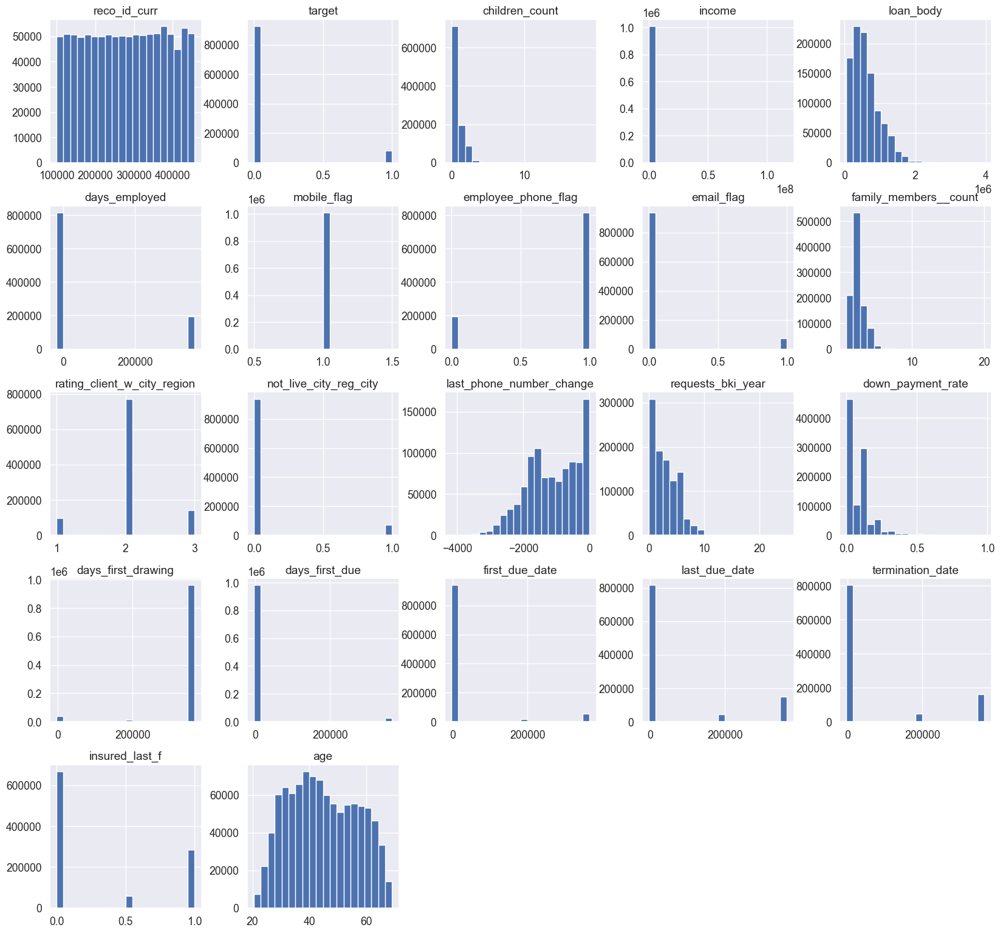

In [206]:
data_clean.hist(bins=20, figsize=(20, 19));

**Видим, что данные содержат выбросы.** Изучим описательные статистики, чтобы принять решение об ограничении значений, которые войдут с финальный датасет для анализа.

In [207]:
data_clean.columns

Index(['reco_id_curr', 'target', 'contract_type_name', 'gender',
       'own_car_flag', 'own_realty_flag', 'children_count', 'income',
       'loan_body', 'income_type_name', 'education_type_name',
       'family_status_name', 'housing_type_name', 'days_employed',
       'mobile_flag', 'employee_phone_flag', 'email_flag',
       'type_of_occupation', 'family_members__count',
       'rating_client_w_city_region', 'not_live_city_reg_city',
       'fondkapremon_mode', 'mode_house_type', 'emergency_state_mode',
       'last_phone_number_change', 'requests_bki_year', 'down_payment_rate',
       'contract_status_name', 'reject_reason_code', 'client_type_name',
       'channel_type', 'combination_of_product', 'days_first_drawing',
       'days_first_due', 'first_due_date', 'last_due_date', 'termination_date',
       'insured_last_f', 'age'],
      dtype='object')

### *Вывод:* Видим, что некоторые признаки нелогично отрицательные, удалим их.

```
'last_phone_number_change' 
```

### А также ряд признаков, на первый взгляд, содержат выбросы. Проверим их на этапе описательных статистик:

```
'external_source_3',
'median_years_building',
'last_phone_number_change',
'median_apartments',
'average_max_floors',
'average_living_apartments'
```

In [208]:
data_clean = data_clean.drop(columns=['last_phone_number_change'])

# 3 Исследовательский анализ данных

## 3.1 Описательные статистики

### Обрежем признаки, которые содержат выбросы.

In [220]:
data_clean.shape

(1010451, 38)

In [221]:
data_clean_final = data_clean.drop(data_clean[data_clean['income'] > 500000.].index)

In [222]:
data_clean_final = data_clean.drop(data_clean[data_clean['loan_body'] > 300000].index)

In [223]:
data_clean_final = data_clean.drop(data_clean[data_clean['family_members__count'] > 6].index)

In [224]:
data_clean_final = data_clean.drop(data_clean[data_clean['down_payment_rate'] > 0.3].index)

In [225]:
data_clean_final = data_clean.drop(data_clean[data_clean['requests_bki_year'] > 10].index)

In [226]:
data_clean_final = data_clean.drop(data_clean[data_clean['days_first_drawing'] > 300000].index)

In [227]:
data_clean_final = data_clean.drop(data_clean[data_clean['days_first_due'] > 180000].index)

In [228]:
data_clean_final = data_clean.drop(data_clean[data_clean['last_due_date'] > 50000].index)

In [229]:
data_clean_final = data_clean.drop(data_clean[data_clean['termination_date'] > 50000].index)

In [240]:
data_clean_final = data_clean.drop(data_clean[data_clean['children_count'] > 5].index)

In [241]:
data_clean_final.shape

(1010323, 38)

#### Н1 - Как относится количество детей и возврат кредита

In [242]:
children_count_grouped = data_clean_final.groupby('children_count').agg({'target': ['count', 'sum']})
children_count_quality = children_count_grouped['target']['sum'] / children_count_grouped['target']['count']
children_count_quality

children_count
0    0.078075
1    0.092961
2    0.089086
3    0.097413
4    0.135402
5    0.106061
dtype: float64

#### Н2 - Пол клиента ```gender```

In [310]:
gender_grouped = data_clean_final.groupby('gender').agg({'target': ['count', 'sum']})
gender_quality = round(gender_grouped['target']['sum'] / gender_grouped['target']['count'] * 100, 2)
gender_quality

gender
F     7.28
M    10.21
dtype: float64

#### Н3 - Семейное положение клиента ```family_status_name```

In [312]:
family_status_name_grouped = data_clean_final.groupby('family_status_name').agg({'target': ['count', 'sum']})
family_status_name_quality = round(family_status_name_grouped['target']['sum'] / family_status_name_grouped['target']['count'] * 100, 2)
family_status_name_quality

family_status_name
Civil marriage          9.83
Married                 7.93
Separated               8.08
Single / not married    9.67
Widow                   5.78
dtype: float64

#### Н4 - Уровень высшего образования ```education_type_name```

In [251]:
education_type_name_grouped['target']['count']

education_type_name
Academic degree                     438
Higher education                 227060
Incomplete higher                 31863
Lower secondary                   11711
Secondary / secondary special    739251
Name: count, dtype: int64

In [250]:
education_type_name_grouped['target']['sum']

education_type_name
Academic degree                     10
Higher education                 13454
Incomplete higher                 2698
Lower secondary                   1261
Secondary / secondary special    65685
Name: sum, dtype: int64

In [255]:
education_type_name_grouped = data_clean_final.groupby('education_type_name').agg({'target': ['count', 'sum']})
education_type_name_quality = round(education_type_name_grouped['target']['sum'] / education_type_name_grouped['target']['count'] * 100, 2)
education_type_name_quality

education_type_name
Academic degree                   2.28
Higher education                  5.93
Incomplete higher                 8.47
Lower secondary                  10.77
Secondary / secondary special     8.89
dtype: float64

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/1445745291.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  avg_income = data_clean_final.groupby('education_type_name').mean()


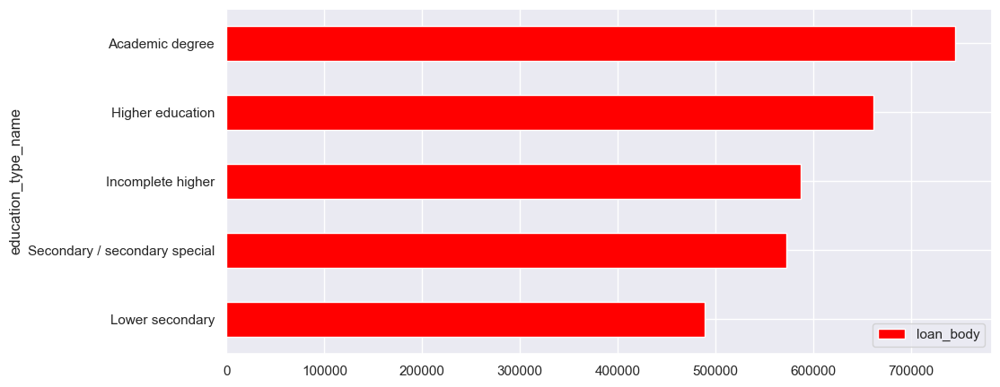

In [296]:
avg_income = data_clean_final.groupby('education_type_name').mean()
avg_income.sort_values(by='loan_body').plot(kind="barh", 
                                         y='loan_body', 
                                         color='red', 
                                         figsize=(11, 5));

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/740745445.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  avg_income = data_clean_final.groupby('education_type_name').mean()


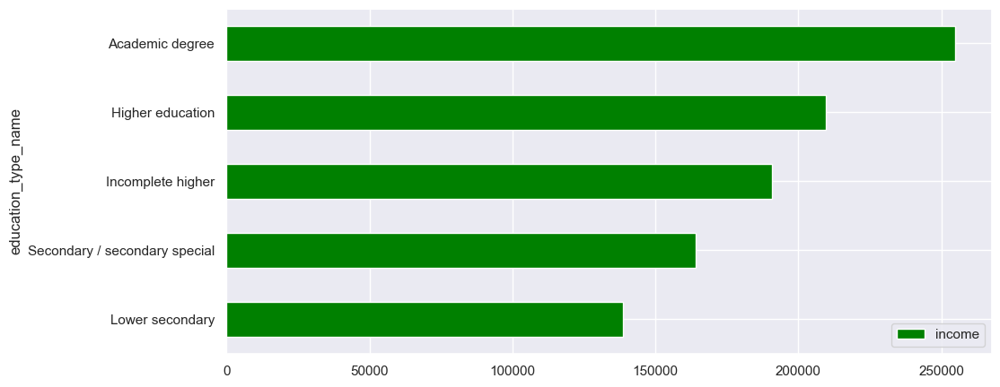

In [295]:
avg_income = data_clean_final.groupby('education_type_name').mean()
avg_income.sort_values(by='income').plot(kind="barh", 
                                         y='income', 
                                         color='green', 
                                         figsize=(11, 5));

#### H5 - Тип организации, в которой работает клиент ```type_of_organization```

In [264]:
type_of_organization_grouped = df_filled.groupby('type_of_organization').agg({'target': ['count', 'sum']})
type_of_organization_quality = round(type_of_organization_grouped['target']['sum'] / type_of_organization_grouped['target']['count'] * 100, 2)
type_of_organization_quality

type_of_organization
Advertising                6.06
Agriculture                8.42
Bank                       5.04
Business Entity Type 1     9.74
Business Entity Type 2     9.06
Business Entity Type 3     9.45
Cleaning                   9.00
Construction              10.96
Culture                    4.67
Electricity                7.29
Emergency                  7.21
Government                 7.12
Hotel                      7.34
Housing                    8.69
Industry: type 1          12.29
Industry: type 10          5.39
Industry: type 11          9.47
Industry: type 12          2.29
Industry: type 13          4.09
Industry: type 2           6.34
Industry: type 3          10.76
Industry: type 4           8.68
Industry: type 5           9.07
Industry: type 6           7.46
Industry: type 7           9.40
Industry: type 8           1.49
Industry: type 9           8.22
Insurance                  4.94
Kindergarten               7.08
Legal Services             4.50
Medicine           

#### H6 - Количество членов семьи у клиента ```family_members__count```

In [298]:
sns.set(rc={'figure.figsize':(9, 5)})

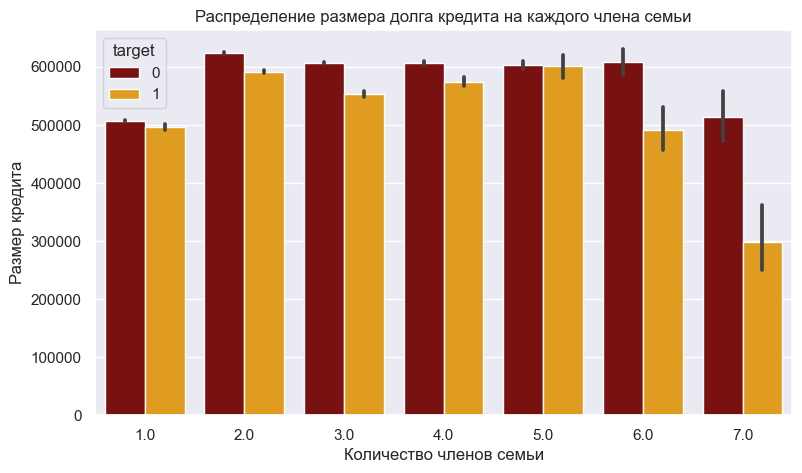

In [300]:
ax = sns.barplot(x='family_members__count',
            y='loan_body',
            hue="target",
            data=data_clean_final,
            palette=['darkred', 'orange'])

ax.set_title('Распределение размера долга кредита на каждого члена семьи')
ax.set(xlabel='Количество членов семьи', ylabel='Размер кредита');

#### H11 - Флаг, если постоянный адрес клиента не соответствует контактному адресу (1 = другой, 0 = то же, на уровне города) ```not_live_city_reg_city```

In [212]:
not_live_city_reg_city_grouped = data_clean.groupby('not_live_city_reg_city').agg({'target':['sum','count']})
not_live_city_reg_city_quality = not_live_city_reg_city_grouped['target']['sum'] / not_live_city_reg_city_grouped['target']['count']
not_live_city_reg_city_quality

not_live_city_reg_city
0    0.079307
1    0.120692
dtype: float64

In [201]:
data_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1010451 entries, 0 to 1215951
Data columns (total 38 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1010451 non-null  int64  
 1   target                       1010451 non-null  int64  
 2   contract_type_name           1010451 non-null  object 
 3   gender                       1010451 non-null  object 
 4   own_car_flag                 1010451 non-null  object 
 5   own_realty_flag              1010451 non-null  object 
 6   children_count               1010451 non-null  int64  
 7   income                       1010451 non-null  float64
 8   loan_body                    1010451 non-null  float64
 9   income_type_name             1010451 non-null  object 
 10  education_type_name          1010451 non-null  object 
 11  family_status_name           1010451 non-null  object 
 12  housing_type_name            1010451 non-n

Для описательной статтистики были выбраны следующие категории:

- **income** - Доход клиента
- **loan_body** - Сумма займа
- **type_of_occupation** - Профессия клиента
- **family_status_name** - Семейное положение клиента
- **education_type_name** - Уровень высшего образования



In [202]:
df[['income','loan_body', 'type_of_occupation', 'family_status_name', 'education_type_name']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 261384 entries, 0 to 261383
Data columns (total 5 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   income               261384 non-null  float64
 1   loan_body            261384 non-null  float64
 2   type_of_occupation   179421 non-null  object 
 3   family_status_name   261384 non-null  object 
 4   education_type_name  261384 non-null  object 
dtypes: float64(2), object(3)
memory usage: 10.0+ MB


In [203]:
data_clean.describe()

,reco_id_curr,target,children_count,income,loan_body,days_employed,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,not_live_city_reg_city,requests_bki_year,down_payment_rate,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f,age
count,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1010451.0,1.010451e+06,1.010451e+06,1.010451e+06,...,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06,1.010451e+06
mean,2.785594e+05,8.227415e-02,4.153155e-01,1.749105e+05,5.922592e+05,6.808417e+04,1.0,8.080263e-01,7.253791e-02,2.164766e+00,...,7.169967e-02,2.887879e+00,7.643563e-02,3.497265e+05,8.630007e+03,2.194410e+04,6.120544e+04,6.579161e+04,3.107098e-01,4.469907e+01
std,1.029224e+05,2.747821e-01,7.258380e-01,2.222998e+05,3.854595e+05,1.448408e+05,0.0,3.938527e-01,2.593766e-01,9.059862e-01,...,2.579901e-01,2.199156e+00,9.772951e-02,7.093461e+04,5.745985e+04,8.507138e+04,1.318594e+05,1.355444e+05,4.466068e-01,1.183211e+01
min,1.000020e+05,0.000000e+00,0.000000e+00,2.610000e+04,4.500000e+04,-1.791200e+04,1.0,0.000000e+00,0.000000e+00,1.000000e+00,...,0.000000e+00,0.000000e+00,-1.497876e-05,-2.921000e+03,-2.892000e+03,-2.801000e+03,-2.889000e+03,-2.874000e+03,0.000000e+00,2.051781e+01
25%,1.892920e+05,0.000000e+00,0.000000e+00,1.125000e+05,2.730240e+05,-2.898000e+03,1.0,1.000000e+00,0.000000e+00,2.000000e+00,...,0.000000e+00,1.000000e+00,0.000000e+00,3.652430e+05,-1.480000e+03,-1.052000e+03,-1.153000e+03,-1.105500e+03,0.000000e+00,3.497534e+01
50%,2.789420e+05,0.000000e+00,0.000000e+00,1.575000e+05,5.123385e+05,-1.324000e+03,1.0,1.000000e+00,0.000000e+00,2.000000e+00,...,0.000000e+00,3.000000e+00,5.445455e-02,3.652430e+05,-8.430000e+02,-3.580000e+02,-5.410000e+02,-5.015000e+02,0.000000e+00,4.380822e+01
75%,3.678325e+05,0.000000e+00,1.000000e+00,2.160000e+05,8.086500e+05,-2.980000e+02,1.0,1.000000e+00,0.000000e+00,3.000000e+00,...,0.000000e+00,4.000000e+00,1.089091e-01,3.652430e+05,-4.620000e+02,6.100000e+01,-1.260000e+02,-9.300000e+01,1.000000e+00,5.466301e+01
max,4.562550e+05,1.000000e+00,1.900000e+01,1.170000e+08,3.956274e+06,3.652430e+05,1.0,1.000000e+00,1.000000e+00,2.000000e+01,...,1.000000e+00,2.500000e+01,9.807153e-01,3.652430e+05,3.652430e+05,3.652430e+05,3.652430e+05,3.652430e+05,1.000000e+00,6.904384e+01


### *Вывод:* В представленных данных видны аномалии в колонках income, loan_body и days_employed. Максимальное значение признака слишком выбивается из всех других значений. Разберём каждый в отдельности

### - ```loan_body```

In [204]:
data_clean[['loan_body']].describe()

,loan_body
count,1.010451e+06
mean,5.922592e+05
std,3.854595e+05
min,4.500000e+04
25%,2.730240e+05
50%,5.123385e+05
75%,8.086500e+05
max,3.956274e+06


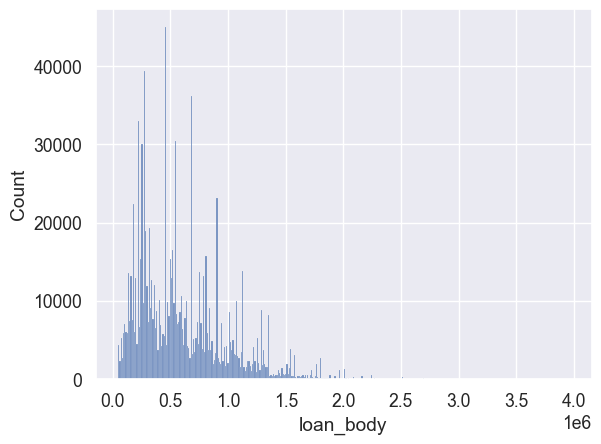

In [205]:
sns.histplot(data_clean, x='loan_body');

#### По гистограмме видно, что чаще всего берут кредит на сумму 500 000. Однако периодически повторяются различные выбросы. Выбросов довольно много, но в целом данные можно оставить. Создадим два подграфика 

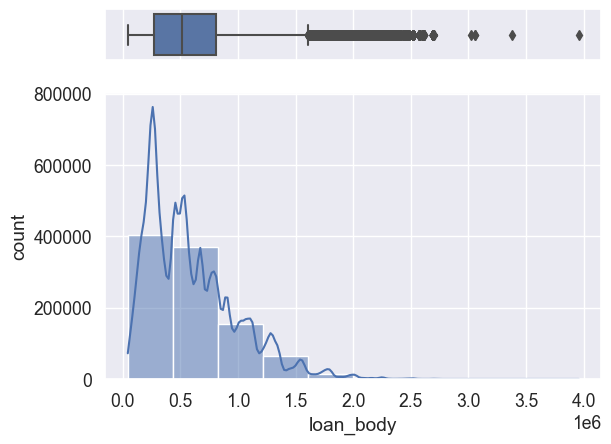

In [206]:

fig, (ax_box, ax_hist) = plt.subplots(2,
                                    sharex = True, 
                                    gridspec_kw = {'height_ratios': (.15, .85)}) 
 

sns.boxplot(x = data_clean['loan_body'], ax = ax_box)
sns.histplot(x = data_clean['loan_body'], ax = ax_hist, bins = 10, kde = True)
 

ax_box.set(xlabel = '')
ax_hist.set(xlabel = 'loan_body')
ax_hist.set(ylabel = 'count')
 

plt.show();

### - ```income```

In [207]:
data_clean[['income']].describe() 

,income
count,1.010451e+06
mean,1.749105e+05
std,2.222998e+05
min,2.610000e+04
25%,1.125000e+05
50%,1.575000e+05
75%,2.160000e+05
max,1.170000e+08


### Также видим максимальное значение на три порядка выше 3 квартиля.

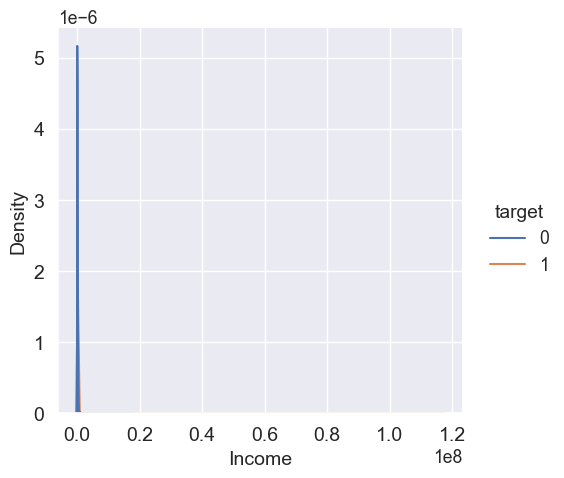

In [352]:
sns.displot(df, x='income', hue='target', kind="kde", common_norm=False)

plt.xlabel('Income', fontsize=14)
plt.ylabel('Density', fontsize=14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

#### Видим выброс, попытаемся поймать его на другом графике.

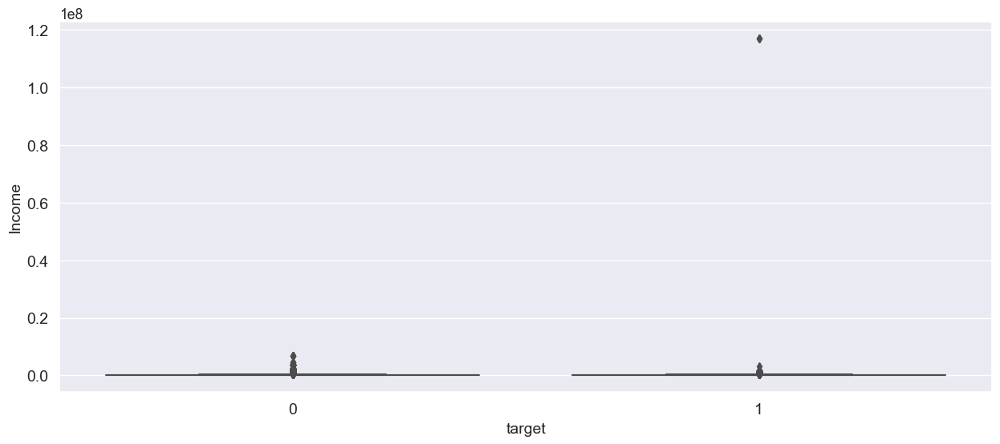

In [209]:
plt.figure(figsize=(15, 6))

sns.boxplot(x='target', y='income', data=data_clean)

plt.ylabel('Income', fontsize=14)
plt.xlabel('target', fontsize=14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

#### Хорошо виден выброс. Он очень сильно может повлиять на данные. В дальнейшем уберём это значение

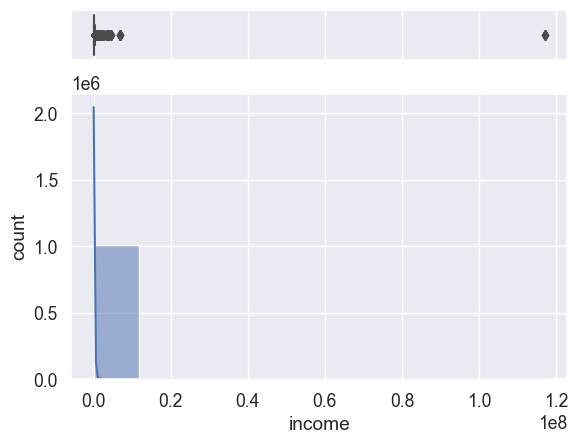

In [210]:
#Построим такие же графики 
fig, (ax_box, ax_hist) = plt.subplots(2, 
                                    sharex = True, 
                                    gridspec_kw = {'height_ratios': (.15, .85)}) 
 

sns.boxplot(x = data_clean['income'], ax = ax_box)
sns.histplot(x = data_clean['income'], ax = ax_hist, bins = 10, kde = True)
 

ax_box.set(xlabel = '') 
ax_hist.set(xlabel = 'income')
ax_hist.set(ylabel = 'count')
 

plt.show();

### Оценивать по графикам довольно тяжело, поэтому можно посмотреть ещё на сами значения. Отличия в медиане довольно существенные, значит этот признак влияет на целевой показатель.

In [211]:
data_clean[['income']].describe()

,income
count,1.010451e+06
mean,1.749105e+05
std,2.222998e+05
min,2.610000e+04
25%,1.125000e+05
50%,1.575000e+05
75%,2.160000e+05
max,1.170000e+08


In [351]:
df.groupby('target')['income'].mean()

target
0    169144.727621
1    166409.128351
Name: income, dtype: float64

In [350]:
df.groupby('target')['income'].median()

target
0    148500.0
1    135000.0
Name: income, dtype: float64

In [359]:
df.groupby('target')['age'].median()

target
0    43.480
1    39.115
Name: age, dtype: float64

In [358]:
df.groupby('target')['loan_body'].median()

target
0    517788.0
1    497520.0
Name: loan_body, dtype: float64

### - ```days_employed```

In [349]:
df[['days_employed']].describe()

,days_employed
count,261384.000000
mean,63867.624675
std,141317.267570
min,-17912.000000
25%,-2758.000000
50%,-1213.000000
75%,-289.000000
max,365243.000000


### Обратим внимание на положительное максимальное значение, но при этом 3-й квартиль отрицательный, т.е. по факту основная часть данных отрицательна. Скорее всего данные отрицательные, потомцу что банку удобнее было заполнить так, а положительный выброс возможно объяснить, что пропуски заполняли константой.

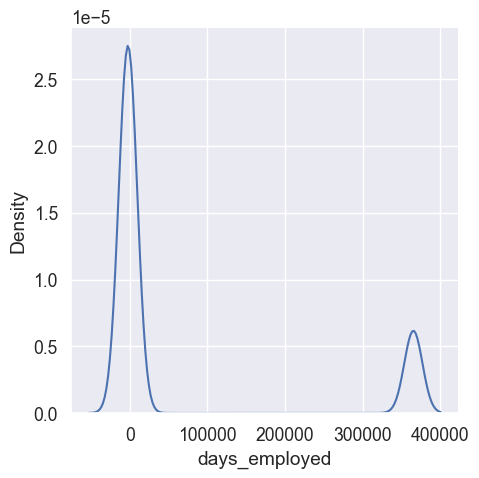

In [348]:
sns.displot(x=df['days_employed'],kind='kde');

### - ```date_of_birth и education_type_name```

In [343]:
df['age'] = round((df[['days_birth']] / -365), ndigits=2) 
# привели день рождения в правильный вид возраста
df[['age']]

,age
0,36.43
1,40.49
2,49.06
3,53.77
4,55.69
...,...
261379,43.84
261380,30.57
261381,56.00
261382,30.21


In [344]:
data_clean.education_type_name.unique()

array(['Secondary / secondary special', 'Higher education',
       'Lower secondary', 'Incomplete higher', 'Academic degree'],
      dtype=object)

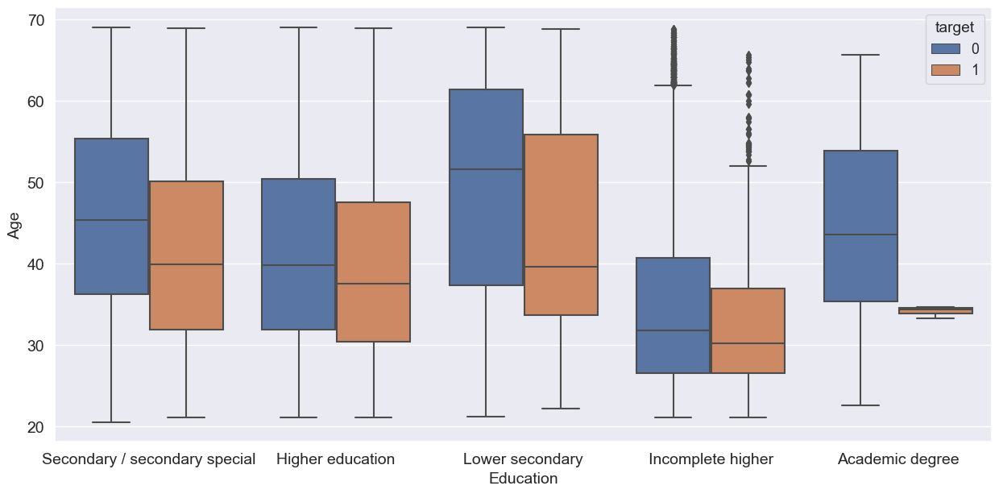

In [346]:
plt.figure(figsize=(15, 7))

sns.boxplot(x='education_type_name', y='age', hue='target', 
            data=df)

plt.ylabel('Age', fontsize=14)
plt.xlabel('Education', fontsize=14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

#### По боксплоту видно, что если мы берем уровень образования, то среднее значение возраста у клиентов без трудностей оплаты выше, чем у тех, у кого трудности, но сам разброс значений и у тех и у тех также высокий. Возможно, если мы берем какой то предел возраст, например, от 30 до 50 лет, то внутри этой группы данный показатель не сильно будет влиять на полную выплату кредита.

In [ ]:
data_clean.groupby('education_type_name')['age'].median()

In [ ]:
plt.figure(figsize=(15, 7))

educ_def = (data_clean.groupby(['target'])['education_type_name']
            .value_counts(normalize=True)
            .rename('percentage')
            .mul(100)
            .reset_index()
            .sort_values('education_type_name'))

ax = sns.barplot(x="education_type_name", y="percentage", 
                 hue="target", data=educ_def)

for p in ax.patches:
    percentage = '{:.1f}%'.format(p.get_height())
    ax.annotate(percentage,  # текст
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center',  # центрирование
                va='center',
                xytext=(0, 10),
                textcoords='offset points', 
                fontsize=14)

plt.ylabel('Count', fontsize=14)
plt.xlabel('default', fontsize=14)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14);

#### По этим данным видно, что чаще всего кредит берут люди с образованием Secondary, и этот признак будет вляить на модель больше, чем все остальные. Причём в этом классе трудностей с оплатой больше, чем успешных. У образования Нigher наоборот, процент успешных выплат больше, чем неуспешных, и этот признак тоже вносит вклад в модель. Остальные признаки составляют меньше 5%. Так что, скорее в данном случае влияет не сам возраст, а уровень образования.

### - ```type_of_occupation```

In [223]:
df['type_of_occupation'].unique()

array(['Sales staff', 'Managers', 'High skill tech staff', 'Laborers',
       nan, 'Core staff', 'Accountants', 'Low-skill Laborers', 'Drivers',
       'Medicine staff', 'Secretaries', 'Security staff', 'Cooking staff',
       'Cleaning staff', 'IT staff', 'Private service staff',
       'Waiters/barmen staff', 'HR staff', 'Realty agents'], dtype=object)

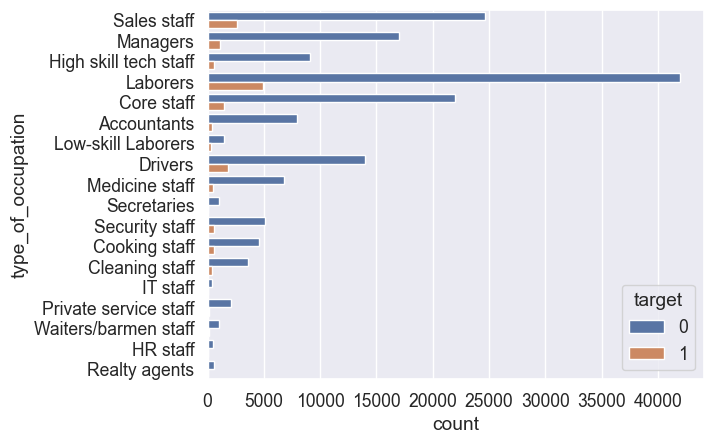

In [224]:
sns.countplot(y = 'type_of_occupation', hue = 'target', data = df);

In [225]:
df['type_of_occupation'].describe()

count       179421
unique          18
top       Laborers
freq         46865
Name: type_of_occupation, dtype: object

#### По этим данным можно сказать, что все клиенты всех профессий хорошо отдают кредиты. Однако больше всего их берут Laborers, причём почти в два раза больше, sales staff, идущий за ним. Так как это первые два места по количеству кредитов, то среди этих двух классов больше клиентов с затруднением платежей. Однако в других профессиях невыплаты по кредиту сложно анализировать в виду их несистемности.

### - ```family_status_name```

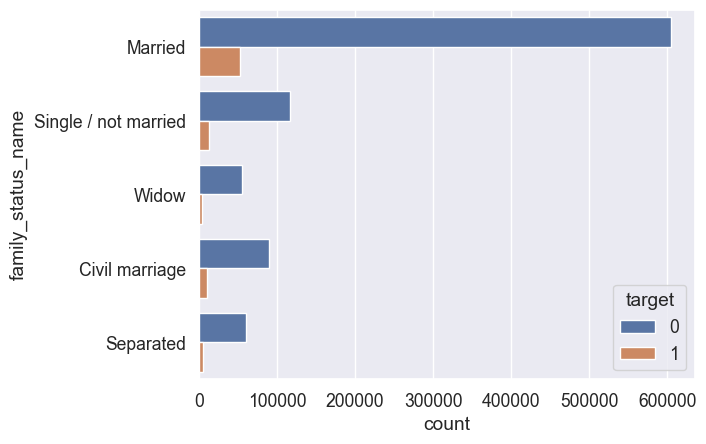

In [226]:
sns.countplot(y = 'family_status_name', 
              hue='target', 
              data = data_clean);

In [227]:
data_clean['family_status_name'].describe()

count     1010451
unique          5
top       Married
freq       657524
Name: family_status_name, dtype: object

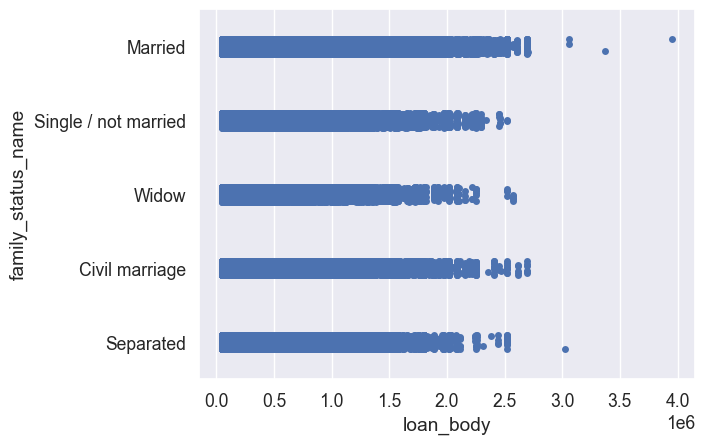

In [228]:
sns.stripplot(x = 'loan_body', 
              y = 'family_status_name', 
              data = data_clean, 
              jitter=0.1);

#### Как видно по этим данным, самые большие кредиты берут женатые люди, а меньше всего вдовы. В целом есть небольшие выбросы, но они скомпенсированы тем, что находятся во всех группах, и на модель эти данные должны оказывать примерно одинаковое влияние. Есть группа неизвестных, но она не оказывает существенного влияния, поэтому ей можно пренебречь 

### *Выводы*: Были выявлены сильные выбросы в признаках income, days_employed и loan_body. В дальнейшем обрежем эти данные, чтобы они так сильно не влияли на качество модели. Также было отмечено, что сильнее всего из просмотренных признаков на целевое значение влияет образование, а возраст людей, берущих кредиты, находится в среднем диапазоне 30-50 лет. 


## 3.2 Работа с выбросами

In [229]:
data_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1010451 entries, 0 to 1215951
Data columns (total 38 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1010451 non-null  int64  
 1   target                       1010451 non-null  int64  
 2   contract_type_name           1010451 non-null  object 
 3   gender                       1010451 non-null  object 
 4   own_car_flag                 1010451 non-null  object 
 5   own_realty_flag              1010451 non-null  object 
 6   children_count               1010451 non-null  int64  
 7   income                       1010451 non-null  float64
 8   loan_body                    1010451 non-null  float64
 9   income_type_name             1010451 non-null  object 
 10  education_type_name          1010451 non-null  object 
 11  family_status_name           1010451 non-null  object 
 12  housing_type_name            1010451 non-n

In [230]:
def desc_stat(data, column):
    # descriptive statistics
    print(data[column].describe())
    data.boxplot(column=column, figsize=(3,7));
    plt.title('Descriptive Statistics')
    plt.show()
    data[column].hist(bins=30, range=(0, 110), figsize=(15, 5));

count    1.010451e+06
mean     4.469907e+01
std      1.183211e+01
min      2.051781e+01
25%      3.497534e+01
50%      4.380822e+01
75%      5.466301e+01
max      6.904384e+01
Name: age, dtype: float64


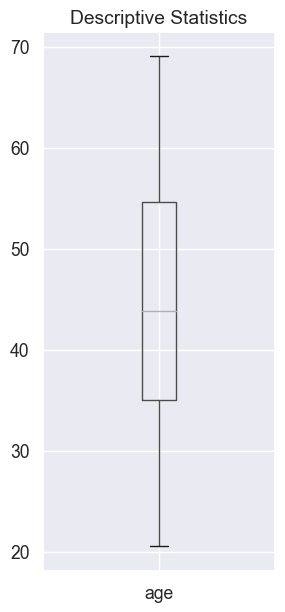

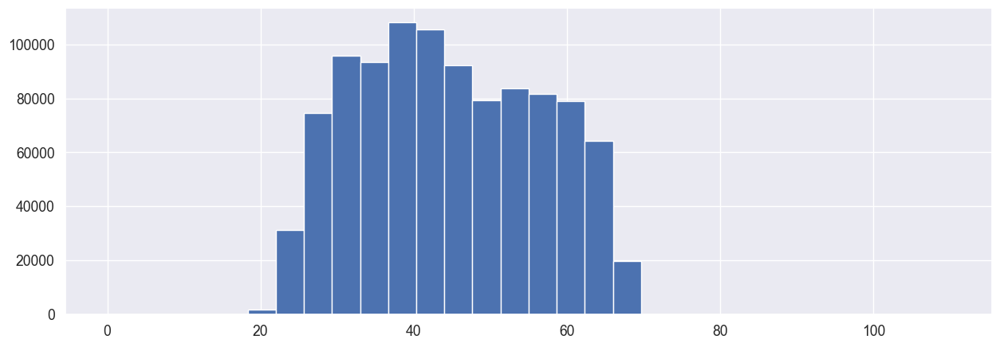

In [231]:
desc_stat(data_clean, 'age')

count    1.010451e+06
mean     3.107098e-01
std      4.466068e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      1.000000e+00
max      1.000000e+00
Name: insured_last_f, dtype: float64


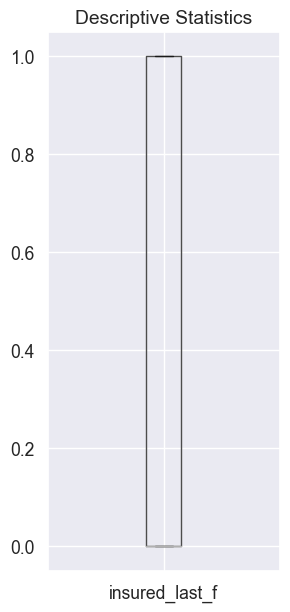

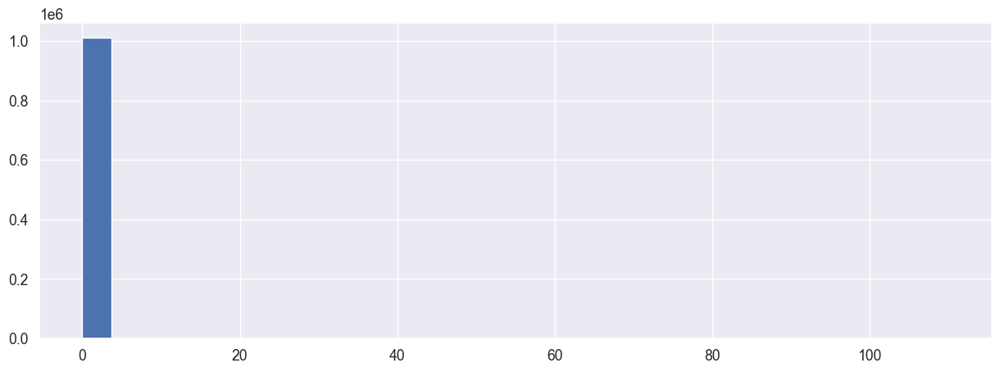

In [232]:
desc_stat(data_clean, 'insured_last_f')

count    1.010451e+06
mean     6.579161e+04
std      1.355444e+05
min     -2.874000e+03
25%     -1.105500e+03
50%     -5.015000e+02
75%     -9.300000e+01
max      3.652430e+05
Name: termination_date, dtype: float64


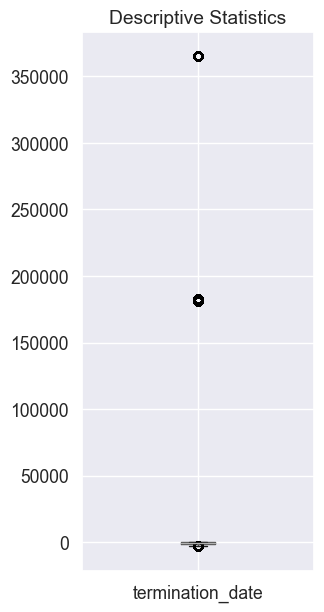

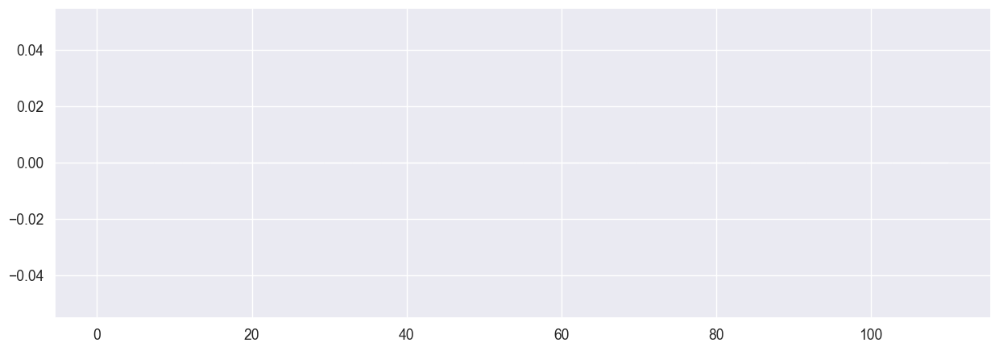

In [233]:
desc_stat(data_clean, 'termination_date')

count    1.010451e+06
mean     6.120544e+04
std      1.318594e+05
min     -2.889000e+03
25%     -1.153000e+03
50%     -5.410000e+02
75%     -1.260000e+02
max      3.652430e+05
Name: last_due_date, dtype: float64


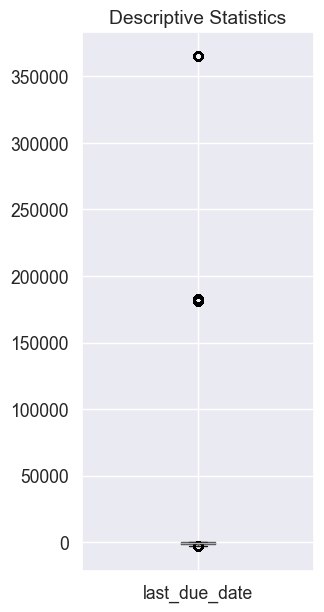

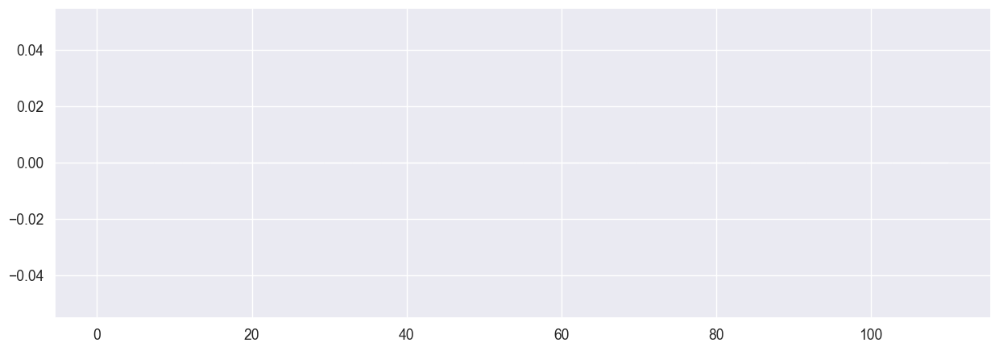

In [234]:
desc_stat(data_clean, 'last_due_date')

count    1.010451e+06
mean     8.630007e+03
std      5.745985e+04
min     -2.892000e+03
25%     -1.480000e+03
50%     -8.430000e+02
75%     -4.620000e+02
max      3.652430e+05
Name: days_first_due, dtype: float64


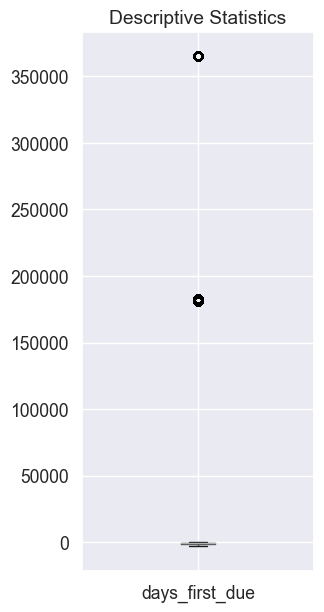

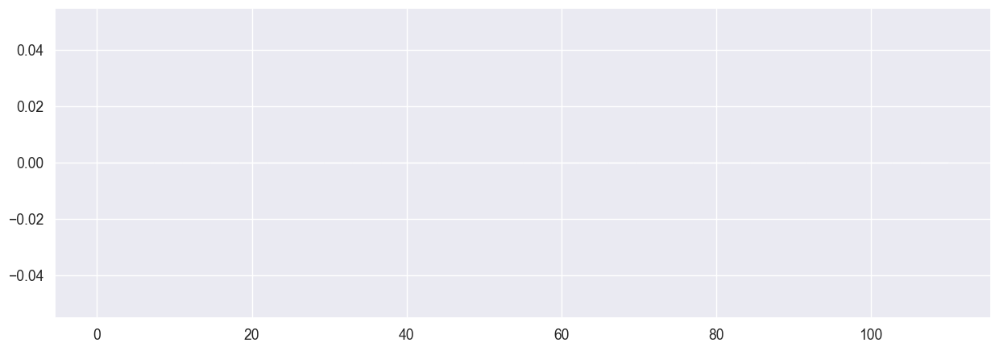

In [235]:
desc_stat(data_clean, 'days_first_due')

count    1.010451e+06
mean     3.497265e+05
std      7.093461e+04
min     -2.921000e+03
25%      3.652430e+05
50%      3.652430e+05
75%      3.652430e+05
max      3.652430e+05
Name: days_first_drawing, dtype: float64


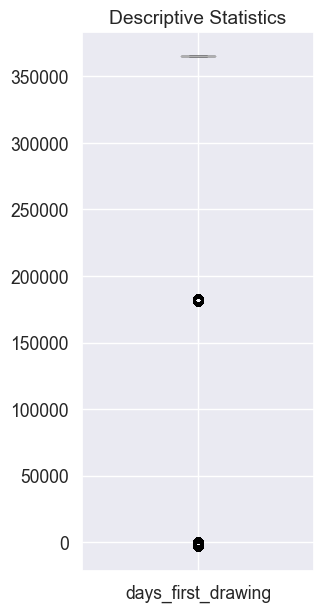

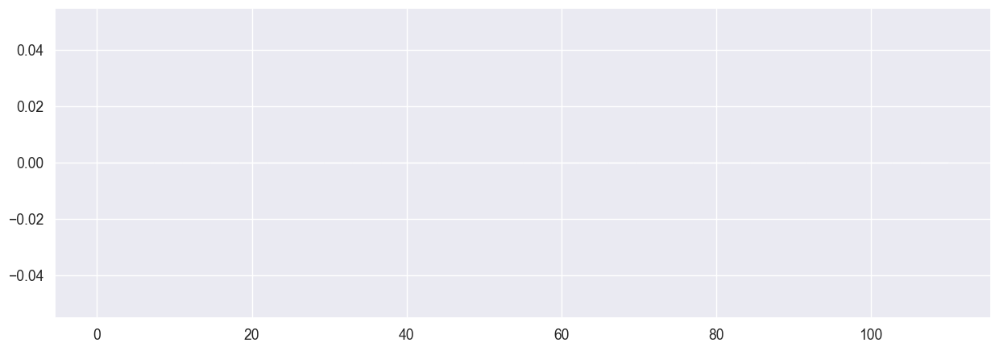

In [236]:
desc_stat(data_clean, 'days_first_drawing')

count    1.010451e+06
mean     7.169967e-02
std      2.579901e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      1.000000e+00
Name: not_live_city_reg_city, dtype: float64


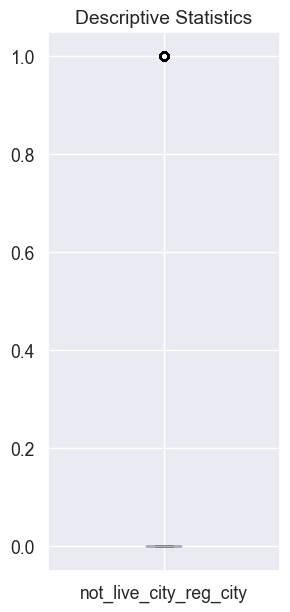

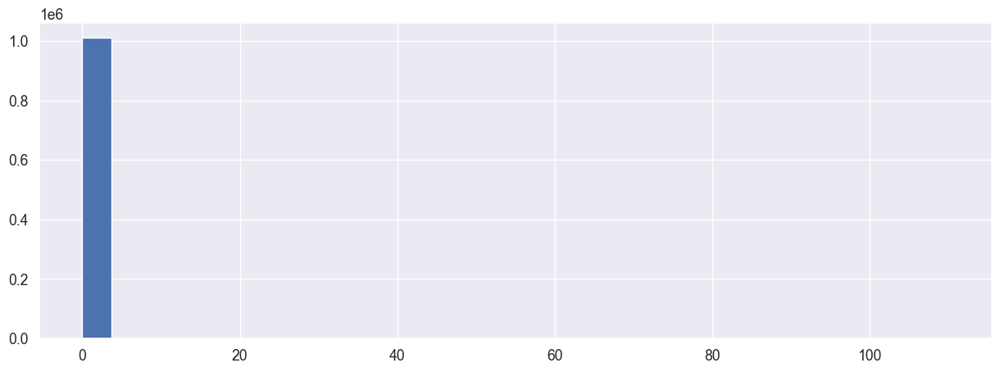

In [237]:
desc_stat(data_clean, 'not_live_city_reg_city')

count    1.010451e+06
mean     2.164766e+00
std      9.059862e-01
min      1.000000e+00
25%      2.000000e+00
50%      2.000000e+00
75%      3.000000e+00
max      2.000000e+01
Name: family_members__count, dtype: float64


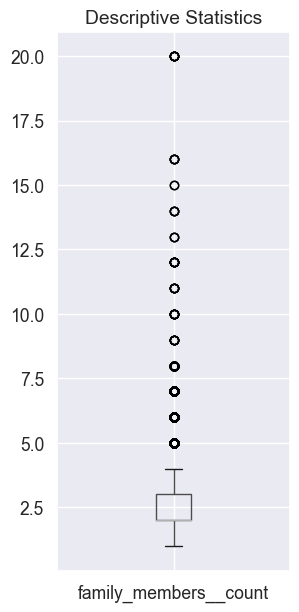

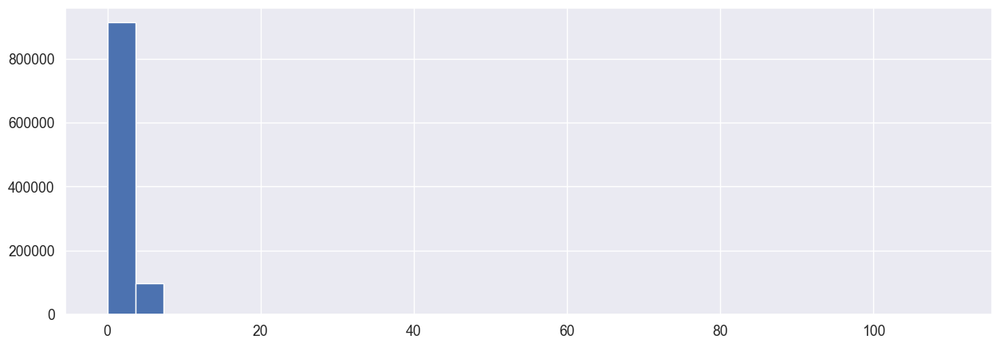

In [238]:
desc_stat(data_clean, 'family_members__count')

count    1.010451e+06
mean     5.922592e+05
std      3.854595e+05
min      4.500000e+04
25%      2.730240e+05
50%      5.123385e+05
75%      8.086500e+05
max      3.956274e+06
Name: loan_body, dtype: float64


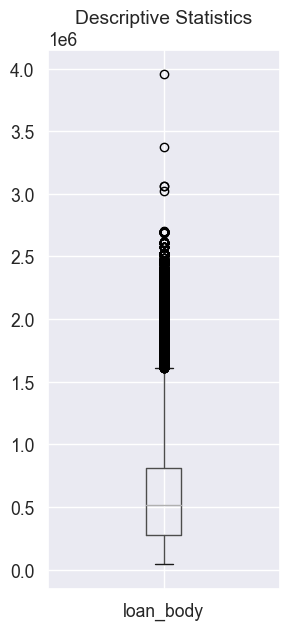

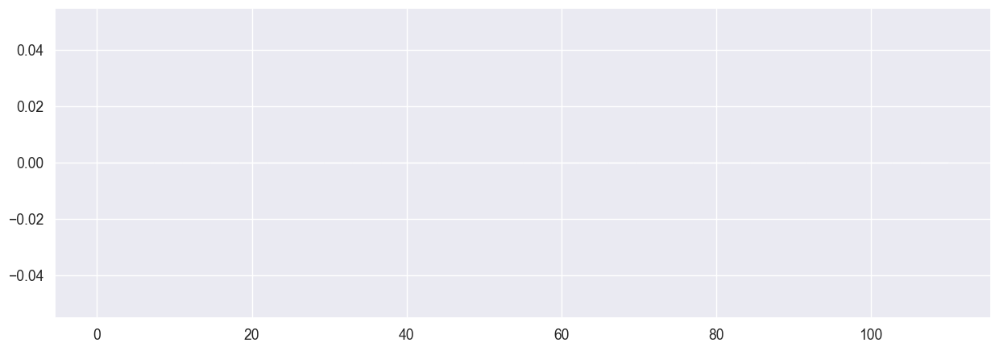

In [239]:
desc_stat(data_clean, 'loan_body')

count    1.010451e+06
mean     6.808417e+04
std      1.448408e+05
min     -1.791200e+04
25%     -2.898000e+03
50%     -1.324000e+03
75%     -2.980000e+02
max      3.652430e+05
Name: days_employed, dtype: float64


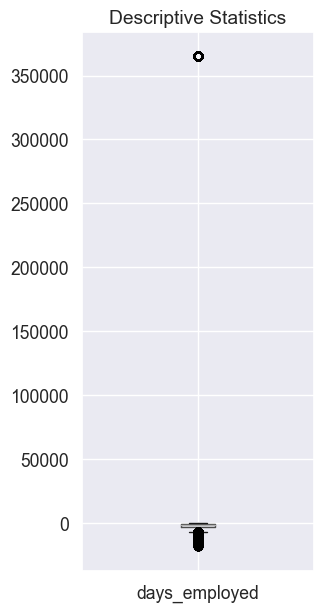

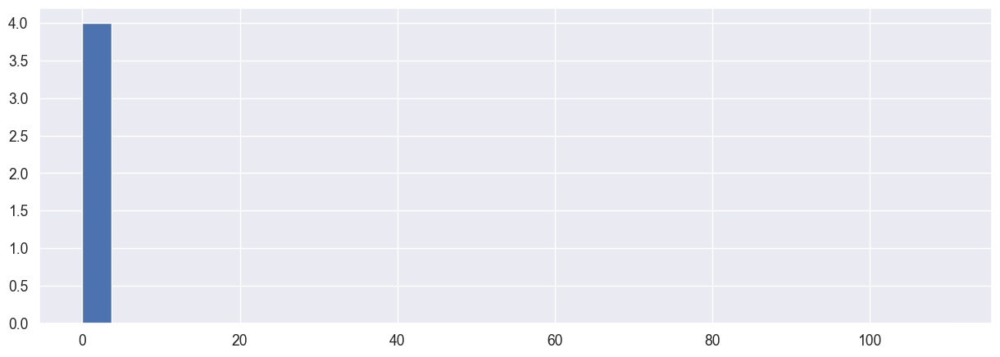

In [240]:
desc_stat(data_clean, 'days_employed')

count    1.010451e+06
mean     2.887879e+00
std      2.199156e+00
min      0.000000e+00
25%      1.000000e+00
50%      3.000000e+00
75%      4.000000e+00
max      2.500000e+01
Name: requests_bki_year, dtype: float64


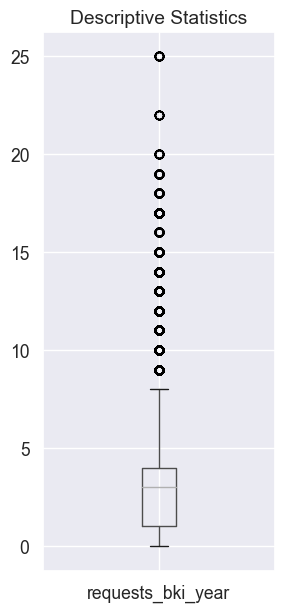

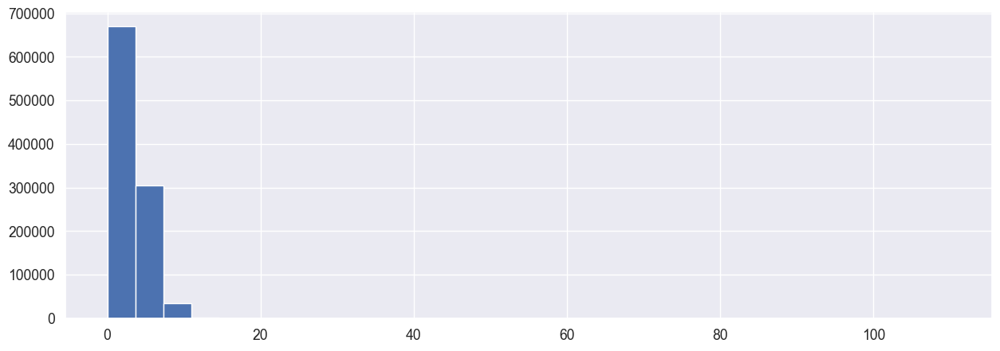

In [241]:
desc_stat(data_clean, 'requests_bki_year')  

count    1.010451e+06
mean     7.643563e-02
std      9.772951e-02
min     -1.497876e-05
25%      0.000000e+00
50%      5.445455e-02
75%      1.089091e-01
max      9.807153e-01
Name: down_payment_rate, dtype: float64


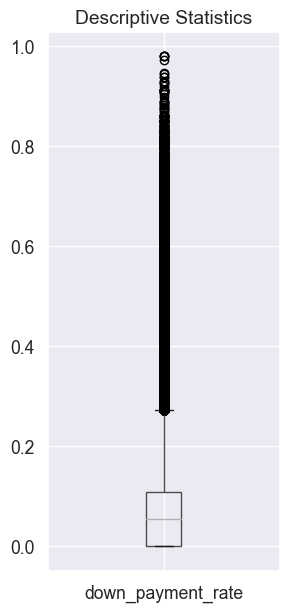

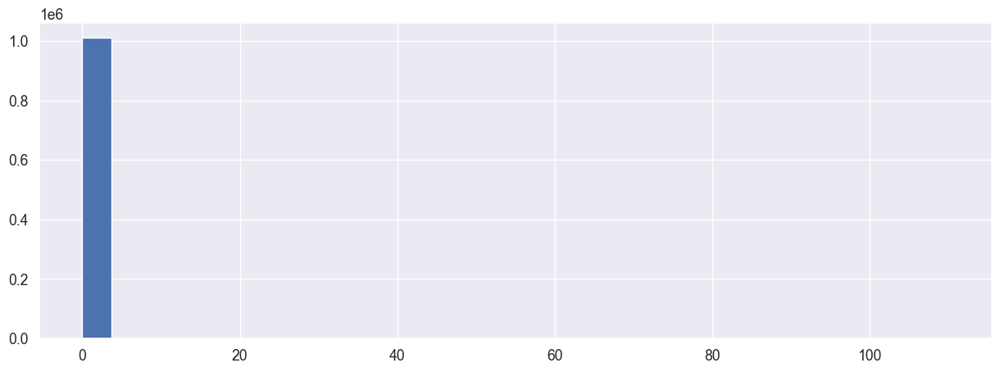

In [242]:
desc_stat(data_clean, 'down_payment_rate')

count    1.010451e+06
mean     1.749105e+05
std      2.222998e+05
min      2.610000e+04
25%      1.125000e+05
50%      1.575000e+05
75%      2.160000e+05
max      1.170000e+08
Name: income, dtype: float64


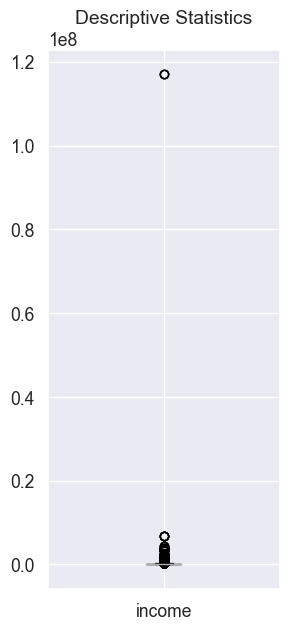

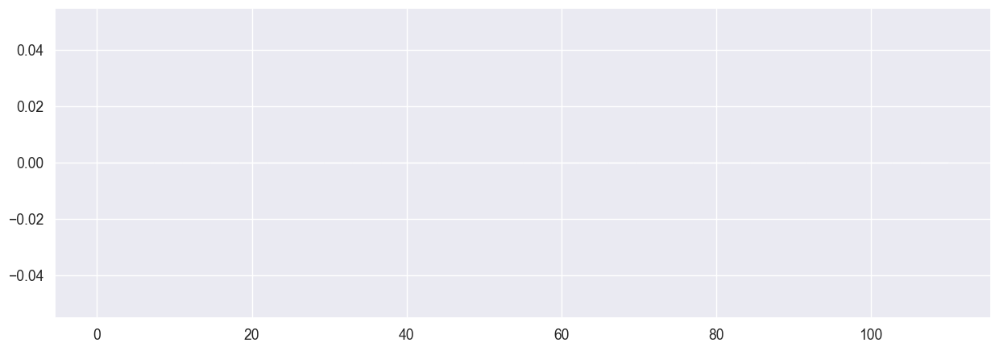

In [243]:
desc_stat(data_clean, 'income')

In [244]:
data_clean['income'].min()

26100.0

In [245]:
data_clean['income'].max()

117000000.0

In [246]:
data_clean['income'].mean()

174910.4826125017

### Обрежем признаки, которые содержат выбросы.

In [ ]:
data_clean.shape

In [247]:
data_clean_final = data_clean.drop(data_clean[data_clean['income'] > 500000].index)

In [248]:
data_clean_final = data_clean.drop(data_clean[data_clean['loan_body'] > 300000].index)

In [249]:
data_clean_final = data_clean.drop(data_clean[data_clean['family_members__count'] > 6].index)

In [250]:
data_clean_final = data_clean.drop(data_clean[data_clean['down_payment_rate'] > 0.3].index)

In [251]:
data_clean_final = data_clean.drop(data_clean[data_clean['requests_bki_year'] > 10].index)

In [252]:
data_clean_final = data_clean.drop(data_clean[data_clean['days_first_drawing'] > 300000].index)

In [253]:
data_clean_final = data_clean.drop(data_clean[data_clean['days_first_due'] > 180000].index)

In [254]:
data_clean_final = data_clean.drop(data_clean[data_clean['last_due_date'] > 50000].index)

In [255]:
data_clean_final = data_clean.drop(data_clean[data_clean['termination_date'] > 50000].index)

In [322]:
data_clean_final.shape

(1010323, 38)

In [328]:
d_clean = data_clean_final.groupby('reco_id_curr').mean()

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_4957/1137511908.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  d_clean = data_clean_final.groupby('reco_id_curr').mean()


In [339]:
d_clean = d_clean.drop(columns=['target'])

In [340]:
d_clean.shape

(200835, 19)

In [347]:
data_clean_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1010323 entries, 0 to 1215951
Data columns (total 38 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   reco_id_curr                 1010323 non-null  int64  
 1   target                       1010323 non-null  int64  
 2   contract_type_name           1010323 non-null  object 
 3   gender                       1010323 non-null  object 
 4   own_car_flag                 1010323 non-null  object 
 5   own_realty_flag              1010323 non-null  object 
 6   children_count               1010323 non-null  int64  
 7   income                       1010323 non-null  float64
 8   loan_body                    1010323 non-null  float64
 9   income_type_name             1010323 non-null  object 
 10  education_type_name          1010323 non-null  object 
 11  family_status_name           1010323 non-null  object 
 12  housing_type_name            1010323 non-n

In [348]:
d_heat = data_clean_final[[
    'children_count',
    'income',
    'loan_body',
    'days_employed',
    'mobile_flag',
    'employee_phone_flag',
    'email_flag',
    'family_members__count',
    'rating_client_w_city_region',
    'not_live_city_reg_city',
    'requests_bki_year',
    'down_payment_rate',
    'days_first_drawing',
    'days_first_due',
    'first_due_date',
    'last_due_date',
    'termination_date',
    'insured_last_f',
        'age'
]]

In [ ]:
# plot the heatmap
sns.heatmap(d_heat.corr(), annot=True)
plt.show();

## 3.2 Изучение таргетного значения

In [319]:
data_clean_final['target'].unique()

array([0, 1])

In [318]:
print(len(data_clean_final['target']))

1010323


#### Пропусков в целевом значении нет.

### Проверка таргета на дисбаланс

In [259]:
data_clean_final['target'].value_counts()

0    738372
1     64009
Name: target, dtype: int64

In [260]:
train_yes = data_clean_final[data_clean_final['target']==1]
train_no = data_clean_final[data_clean_final['target']==0]

print("Кредит выдавать стоит:", len(train_yes))
print("Кредит выдавать НЕ стоит:", len(train_no))

Кредит выдавать стоит: 64009
Кредит выдавать НЕ стоит: 738372


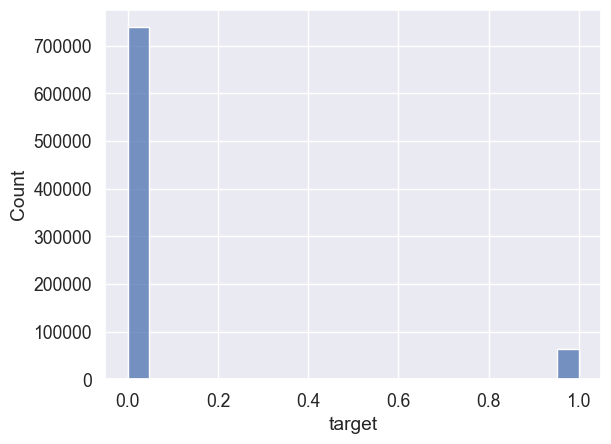

In [261]:
# df['target'].hist(bins=100);
sns.histplot(data_clean_final, x='target');

### *Вывод*: Целевое значение не сбалансировано, мажоритарный класс со значением "0" означает, что в основном представленные метки говорят о том, что кредит выдавать не стоит. Однако, объем данных позволяет нам пренебречь данным сведением, и обучить модели на таком целевом признаке.

Явных дубликатов в данных нет. После выбора стратегии заполнения данных данные будут проверены еще раз на наличие *неявных* аномалий.

## 3.3 Корреляционная матрица

Проверим, что после удаления пропусков и корректировки признаков, данные для последующего анализа получились более высокого качества без мультиколлинеарности с коэффициентом Пирсона выш 0.8.

In [263]:
data_clean_final.corr()

/var/folders/f0/6n5cj1pd2td3sgkgfsl766lr0000gn/T/ipykernel_940/3022084400.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_clean_final.corr()


,reco_id_curr,target,children_count,income,loan_body,days_employed,mobile_flag,employee_phone_flag,email_flag,family_members__count,...,not_live_city_reg_city,requests_bki_year,down_payment_rate,days_first_drawing,days_first_due,first_due_date,last_due_date,termination_date,insured_last_f,age
reco_id_curr,1.000000,-0.004462,-0.005820,0.002195,0.001010,0.002650,NaN,-0.002531,0.001320,-0.005163,...,-0.003727,0.005908,0.002545,-0.000350,-0.000433,-0.000146,-0.000045,0.001357,0.001177,0.004956
target,-0.004462,1.000000,0.020349,-0.001037,-0.016166,-0.047321,NaN,0.048200,0.004103,0.015821,...,0.036274,0.016239,-0.023789,-0.001715,-0.003411,0.000020,-0.004707,0.027811,-0.001926,-0.077589
children_count,-0.005820,0.020349,1.000000,0.013897,0.001730,-0.250223,NaN,0.251315,0.025048,0.881927,...,0.031482,-0.076734,0.014827,0.000329,-0.003585,-0.002522,-0.005564,-0.004066,-0.067024,-0.367491
income,0.002195,-0.001037,0.013897,1.000000,0.203823,-0.084490,NaN,0.084279,0.062731,0.016707,...,0.006436,0.024567,0.021166,-0.004170,0.001131,0.004278,0.000485,0.000751,0.001935,-0.037949
loan_body,0.001010,-0.016166,0.001730,0.203823,1.000000,-0.070441,NaN,0.069277,0.009764,0.061792,...,-0.023230,-0.059886,0.029919,-0.000892,0.001955,0.002555,-0.002437,-0.037943,-0.013292,0.039196
days_employed,0.002650,-0.047321,-0.250223,-0.084490,-0.070441,1.000000,NaN,-0.999752,-0.070374,-0.253510,...,-0.090276,0.104219,-0.046671,0.010713,-0.003134,-0.010126,-0.000791,0.003470,0.109330,0.631566
mobile_flag,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
employee_phone_flag,-0.002531,0.048200,0.251315,0.084279,0.069277,-0.999752,NaN,1.000000,0.070933,0.254198,...,0.091772,-0.104136,0.046536,-0.010764,0.003214,0.010198,0.000914,-0.002423,-0.110106,-0.635253
email_flag,0.001320,0.004103,0.025048,0.062731,0.009764,-0.070374,NaN,0.070933,1.000000,0.023370,...,0.014833,0.044463,0.003776,-0.009475,0.004882,0.010339,0.005183,0.010614,0.013031,-0.100074
family_members__count,-0.005163,0.015821,0.881927,0.016707,0.061792,-0.253510,NaN,0.254198,0.023370,1.000000,...,0.025910,-0.066439,0.013647,-0.001284,-0.003200,-0.000692,-0.004557,-0.011637,-0.059672,-0.335557


## 3.4 Profiling Report

In [316]:
report = ProfileReport(data_clean_final)

In [317]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 4 Строим различные модели и выбираем наилучшую из них по метрике качества

## 4.1 Делим данные на подвыборки
```
- 75% train_data
- 15% test_data
```

In [266]:
data_clean_final.isna().sum()

reco_id_curr                   0
target                         0
contract_type_name             0
gender                         0
own_car_flag                   0
own_realty_flag                0
children_count                 0
income                         0
loan_body                      0
income_type_name               0
education_type_name            0
family_status_name             0
housing_type_name              0
days_employed                  0
mobile_flag                    0
employee_phone_flag            0
email_flag                     0
type_of_occupation             0
family_members__count          0
rating_client_w_city_region    0
not_live_city_reg_city         0
fondkapremon_mode              0
mode_house_type                0
emergency_state_mode           0
requests_bki_year              0
down_payment_rate              0
contract_status_name           0
reject_reason_code             0
client_type_name               0
channel_type                   0
combinatio

In [267]:
train_data, test_data = train_test_split(data_clean_final, test_size=0.15, random_state=5)

print('Размер обучающей выборки:', train_data.shape[0])
print('Размер тестовой выборки:', test_data.shape[0])

Размер обучающей выборки: 682023
Размер тестовой выборки: 120358


## 4.2 Кодирование признаков

### Кодирование признаков проводим после разбиения датасета на подвыборки для обучения и теста, чтобы избежать утечки данных.

Есть несколько способов, как кодировать переменные:

- get_dummies()
- OHE
- OrdinalEncoding
- LabelEncoding

### Мы *не* хотим увеличивать количество колонок в данных, поэтому в рамках данного проекта выбираем способ кодирования *OrdinalEncoding()*.

In [268]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 682023 entries, 45931 to 451862
Data columns (total 38 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   reco_id_curr                 682023 non-null  int64  
 1   target                       682023 non-null  int64  
 2   contract_type_name           682023 non-null  object 
 3   gender                       682023 non-null  object 
 4   own_car_flag                 682023 non-null  object 
 5   own_realty_flag              682023 non-null  object 
 6   children_count               682023 non-null  int64  
 7   income                       682023 non-null  float64
 8   loan_body                    682023 non-null  float64
 9   income_type_name             682023 non-null  object 
 10  education_type_name          682023 non-null  object 
 11  family_status_name           682023 non-null  object 
 12  housing_type_name            682023 non-null  object 


### Кодированию подлежат категориальные переменные:

```
 2   contract_type_name           997909 non-null  object 
 3   gender                       997909 non-null  object 
 4   own_car_flag                 997909 non-null  object 
 5   own_realty_flag              997909 non-null  object
 9   type_suite_name              997909 non-null  object 
 10  income_type_name             997909 non-null  object 
 11  education_type_name          997909 non-null  object 
 12  family_status_name           997909 non-null  object 
 13  housing_type_name            997909 non-null  object
 19  type_of_occupation           997909 non-null  object 
 24  fondkapremon_mode            997909 non-null  object 
 25  mode_house_type              997909 non-null  object 
 26  emergency_state_mode         997909 non-null  object
 30  contract_status_name         997909 non-null  object 
 31  reject_reason_code           997909 non-null  object 
 32  client_type_name             997909 non-null  object 
 33  channel_type                 997909 non-null  object 
 34  combination_of_product       997909 non-null  object 

```

In [271]:
a = train_data[['contract_type_name','gender',
                                                      'own_car_flag',
                                                      'own_realty_flag',
                                                      'income_type_name',
                                                      'education_type_name',
                                                      'family_status_name',
                                                      'housing_type_name',
                                                      'type_of_occupation',
                                                      'fondkapremon_mode',
                                                      'mode_house_type',
                                                      'emergency_state_mode',
                                                      'contract_status_name',
                                                      'reject_reason_code',
                                                      'client_type_name',
                                                      'channel_type',
                                                      'combination_of_product']]

a

,contract_type_name,gender,own_car_flag,own_realty_flag,income_type_name,education_type_name,family_status_name,housing_type_name,type_of_occupation,fondkapremon_mode,mode_house_type,emergency_state_mode,contract_status_name,reject_reason_code,client_type_name,channel_type,combination_of_product
45931,Revolving loans,M,N,Y,Working,Secondary / secondary special,Married,House / apartment,Laborers,reg oper account,block of flats,No,Approved,XAP,Repeater,Regional / Local,POS household with interest
79420,Cash loans,F,N,Y,Working,Secondary / secondary special,Widow,House / apartment,Laborers,not specified,block of flats,No,Approved,XAP,Repeater,Country-wide,POS mobile with interest
733062,Cash loans,F,Y,Y,Commercial associate,Secondary / secondary special,Married,House / apartment,Laborers,reg oper account,block of flats,No,Approved,XAP,Refreshed,Stone,POS industry with interest
220358,Cash loans,F,N,Y,Commercial associate,Secondary / secondary special,Married,House / apartment,Managers,not specified,block of flats,No,Refused,SCOFR,Repeater,Credit and cash offices,Cash
1122103,Cash loans,F,Y,Y,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,Cleaning staff,not specified,block of flats,No,Refused,LIMIT,Repeater,AP+ (Cash loan),Card Street
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1146472,Cash loans,F,Y,Y,State servant,Higher education,Married,House / apartment,Laborers,not specified,block of flats,No,Approved,XAP,New,Country-wide,POS mobile without interest
188947,Cash loans,M,N,N,Working,Secondary / secondary special,Married,Municipal apartment,Drivers,not specified,block of flats,No,Refused,HC,Repeater,Contact center,Cash
825512,Cash loans,F,Y,N,Working,Secondary / secondary special,Married,House / apartment,Managers,not specified,block of flats,No,Refused,HC,Repeater,Stone,POS mobile with interest
28381,Cash loans,F,Y,N,State servant,Higher education,Married,House / apartment,Core staff,not specified,block of flats,No,Approved,XAP,Repeater,Country-wide,POS household with interest


In [272]:
# define ordinal encoding
ordinalencoder = OrdinalEncoder()

In [273]:
result_train = ordinalencoder.set_params(encoded_missing_value=-1).fit_transform(train_data)

In [274]:
result_test = ordinalencoder.set_params(encoded_missing_value=-1).fit_transform(test_data)

In [275]:
result_train = pd.DataFrame(result_train)

In [276]:
result_test = pd.DataFrame(result_test)

In [277]:
# объединим закодированные колонки и наш основной датасет (с удаленными категориальными признаками)
train = train_data.join(result_train)
train.head(30)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,28,29,30,31,32,33,34,35,36,37
45931,210148,0,Revolving loans,M,N,Y,2,247500.0,270000.0,Working,...,1.0,0.0,7.0,2237.0,4981.0,7253.0,4906.0,4789.0,0.0,12679.0
79420,193870,0,Cash loans,F,N,Y,0,157500.0,717003.0,Working,...,2.0,6.0,11.0,2237.0,2350.0,2826.0,2934.0,2823.0,0.0,9885.0
733062,282828,0,Cash loans,F,Y,Y,1,180000.0,719860.5,Commercial associate,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
220358,383611,0,Cash loans,F,N,Y,0,171000.0,1125000.0,Commercial associate,...,2.0,0.0,4.0,2237.0,3918.0,6218.0,4622.0,4511.0,0.0,7973.0
1122103,114355,0,Cash loans,F,Y,Y,2,180000.0,590337.0,Commercial associate,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
186391,387768,0,Cash loans,M,N,N,0,76500.0,450000.0,Working,...,0.0,4.0,14.0,2237.0,3942.0,3698.0,3746.0,3639.0,0.0,7238.0
544919,135670,0,Cash loans,M,N,Y,0,180000.0,938304.0,Commercial associate,...,0.0,4.0,9.0,2237.0,4516.0,4632.0,4680.0,4567.0,0.0,5353.0
943058,198922,0,Cash loans,M,Y,Y,0,202500.0,327024.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
360354,233048,1,Cash loans,M,Y,Y,0,112500.0,450000.0,Working,...,2.0,4.0,15.0,2237.0,4722.0,4838.0,4946.0,4828.0,0.0,14490.0
241890,332442,0,Cash loans,F,N,Y,2,270000.0,1660428.0,Commercial associate,...,2.0,7.0,9.0,2237.0,181.0,368.0,433.0,379.0,2.0,8643.0


In [278]:
train = train.dropna()

In [279]:
train.head()

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,28,29,30,31,32,33,34,35,36,37
45931,210148,0,Revolving loans,M,N,Y,2,247500.0,270000.0,Working,...,1.0,0.0,7.0,2237.0,4981.0,7253.0,4906.0,4789.0,0.0,12679.0
79420,193870,0,Cash loans,F,N,Y,0,157500.0,717003.0,Working,...,2.0,6.0,11.0,2237.0,2350.0,2826.0,2934.0,2823.0,0.0,9885.0
220358,383611,0,Cash loans,F,N,Y,0,171000.0,1125000.0,Commercial associate,...,2.0,0.0,4.0,2237.0,3918.0,6218.0,4622.0,4511.0,0.0,7973.0
186391,387768,0,Cash loans,M,N,N,0,76500.0,450000.0,Working,...,0.0,4.0,14.0,2237.0,3942.0,3698.0,3746.0,3639.0,0.0,7238.0
544919,135670,0,Cash loans,M,N,Y,0,180000.0,938304.0,Commercial associate,...,0.0,4.0,9.0,2237.0,4516.0,4632.0,4680.0,4567.0,0.0,5353.0


In [280]:
# объединим закодированные колонки и наш основной датасет (с удаленными категориальными признаками)
test = test_data.join(result_test)
test.head(30)

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,28,29,30,31,32,33,34,35,36,37
819181,106786,0,Cash loans,M,Y,Y,0,202500.0,675000.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1128215,363600,0,Cash loans,M,N,N,0,202500.0,781920.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
154783,337435,0,Cash loans,F,N,Y,0,211500.0,307818.0,Pensioner,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
808205,423365,0,Cash loans,F,N,N,0,297000.0,900000.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
834685,378516,0,Cash loans,F,N,Y,0,112500.0,450000.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
299311,315686,0,Cash loans,F,Y,N,0,135000.0,508495.5,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1196045,330872,0,Cash loans,F,N,Y,0,225000.0,533668.5,State servant,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
191239,173502,0,Cash loans,M,Y,N,0,112500.0,71955.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
805455,307110,0,Cash loans,F,Y,Y,2,157500.0,900000.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
156400,353408,0,Revolving loans,F,N,Y,1,135000.0,405000.0,Working,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [281]:
test = test.dropna()

In [282]:
test

,reco_id_curr,target,contract_type_name,gender,own_car_flag,own_realty_flag,children_count,income,loan_body,income_type_name,...,28,29,30,31,32,33,34,35,36,37
88100,100974,0,Cash loans,F,N,N,0,135000.0,219042.0,Pensioner,...,2.0,5.0,8.0,756.0,4285.0,6067.0,4263.0,4127.0,2.0,6231.0
94312,256911,0,Cash loans,F,N,N,0,180000.0,254700.0,Pensioner,...,2.0,4.0,13.0,756.0,3196.0,3372.0,3292.0,3162.0,1.0,6514.0
44136,173170,0,Revolving loans,M,Y,Y,1,180000.0,540000.0,Pensioner,...,0.0,4.0,13.0,756.0,1453.0,1650.0,1569.0,1457.0,0.0,3788.0
6323,200418,0,Cash loans,F,N,Y,0,274500.0,1278594.0,Pensioner,...,2.0,4.0,9.0,756.0,4041.0,3855.0,3957.0,3829.0,0.0,718.0
97409,119372,0,Revolving loans,F,N,N,0,225000.0,202500.0,Working,...,2.0,4.0,14.0,756.0,3383.0,3080.0,3000.0,2874.0,0.0,3866.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17298,172269,0,Cash loans,M,N,N,0,135000.0,497520.0,Working,...,0.0,6.0,9.0,756.0,2289.0,2824.0,2863.0,2733.0,0.0,14298.0
23145,124261,0,Cash loans,F,Y,N,0,112500.0,755190.0,Commercial associate,...,0.0,6.0,9.0,756.0,3519.0,3335.0,3315.0,3194.0,0.0,10095.0
19264,283454,0,Cash loans,F,N,N,0,247500.0,1467612.0,Pensioner,...,2.0,4.0,13.0,756.0,1689.0,1876.0,1961.0,1835.0,0.0,6402.0
17268,178779,0,Cash loans,M,Y,Y,0,90000.0,255960.0,Working,...,1.0,5.0,8.0,756.0,3937.0,4465.0,4153.0,4019.0,2.0,9233.0


In [287]:
# удалим колонки, которые закодировали
train_dropped = train.drop(columns=['contract_type_name',
                                                      'gender',
                                                      'own_car_flag',
                                                      'own_realty_flag',
                                                      'income_type_name',
                                                      'education_type_name',
                                                      'family_status_name',
                                                      'housing_type_name',
                                                      'type_of_occupation',
                                                      'fondkapremon_mode',
                                                      'mode_house_type',
                                                      'emergency_state_mode',
                                                      'contract_status_name',
                                                      'reject_reason_code',
                                                      'client_type_name',
                                                      'channel_type',
                                                      'combination_of_product'], axis=1)

In [288]:
# удалим колонки, которые закодировали
test_dropped = test.drop(columns=['contract_type_name',
                                                      'gender',
                                                      'own_car_flag',
                                                      'own_realty_flag',
                                                      'income_type_name',
                                                      'education_type_name',
                                                      'family_status_name',
                                                      'housing_type_name',
                                                      'type_of_occupation',
                                                      'fondkapremon_mode',
                                                      'mode_house_type',
                                                      'emergency_state_mode',
                                                      'contract_status_name',
                                                      'reject_reason_code',
                                                      'client_type_name',
                                                      'channel_type',
                                                      'combination_of_product'], axis=1)

### После кодирования категориальных переменных выделяем `X, y` для обучения и тестирования моделей.

In [289]:
X_train = train_dropped.drop(['target'], axis=1)
y_train = train_dropped['target']

X_test = test_dropped.drop(['target'], axis=1)
y_test = test_dropped['target']

print('Обучающая выборка (признаки):', X_train.shape[0])
print('Обучающая выборка (таргет)', y_train.shape[0])
print()
print('Тестовая выборка (признаки):', X_test.shape[0])
print('Тестовая выборка (таргет)', y_test.shape[0])

Обучающая выборка (признаки): 382014
Обучающая выборка (таргет) 382014

Тестовая выборка (признаки): 11997
Тестовая выборка (таргет) 11997


## 4.3 Масштабирование признаков

In [290]:
from sklearn.preprocessing import MinMaxScaler

In [291]:
# вычисляем минимум и максимум по обучающим данным
scaler = MinMaxScaler().fit(X_train)

/Users/yuliabezginova/Library/Python/3.10/lib/python/site-packages/sklearn/utils/validation.py:1858: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


In [292]:
# масштабируем обучающие данные
X_train_scaled = scaler.transform(X_train)

/Users/yuliabezginova/Library/Python/3.10/lib/python/site-packages/sklearn/utils/validation.py:1858: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


In [293]:
# масштабируем тестовые данные и оцениваем качество на масштабированных данных
X_test_scaled = scaler.transform(X_test)

/Users/yuliabezginova/Library/Python/3.10/lib/python/site-packages/sklearn/utils/validation.py:1858: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  warnings.warn(


## 4.4 Модели

### 4.4.1 Decision Tree
https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html

In [294]:
%%time
# Initiating and building Decision Tree model
parameters_dt = {
    'max_depth': [2, 3, 4, 5],
    'splitter': ['best', 'random'],
    'criterion': ['gini'] # , 'entropy', 'log_loss']
}

dt = DecisionTreeClassifier()
grid_DT = GridSearchCV(dt, param_grid=parameters_dt)
best_decision_tree_model = grid_DT.fit(X_train_scaled, y_train)
print('Наилучшие параметры для Decision Tree: {}'.format(best_decision_tree_model.best_params_))

Наилучшие параметры для Decision Tree: {'criterion': 'gini', 'max_depth': 5, 'splitter': 'best'}
CPU times: user 1min 52s, sys: 6.29 s, total: 1min 59s
Wall time: 2min 13s


### 4.4.2 Random Forest
https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html

In [295]:
%%time
# Initiating and building Random Forest Regressor model
parameters_rf = {
    'n_estimators': [5, 10, 20],
    'max_depth': [3, 7, 9],
    'criterion': ['gini'] #, 'entropy', 'log_loss'],
}

rf_model = RandomForestClassifier()
grid_RF = GridSearchCV(estimator=rf_model, param_grid=parameters_rf)
best_random_forest_model = grid_RF.fit(X_train_scaled, y_train)
print('Наилучшие параметры для Random Forest: {}'.format(best_random_forest_model.best_params_))

Наилучшие параметры для Random Forest: {'criterion': 'gini', 'max_depth': 9, 'n_estimators': 5}
CPU times: user 5min 49s, sys: 10.8 s, total: 5min 59s
Wall time: 6min 22s


### 4.4.3 Gradient Boosting

https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingClassifier.html

https://medium.com/all-things-ai/in-depth-parameter-tuning-for-gradient-boosting-3363992e9bae


In [296]:
%%time
param_grid={'n_estimators':[5,10], 
            'learning_rate': [0.1,0.05,0.02],
            'max_depth':[4], 
            'min_samples_leaf':[3], 
            'max_features':[1.0] } 
n_jobs=4

estimator = GradientBoostingClassifier() 
gb_classifier = GridSearchCV(estimator=estimator, 
                          cv=5, 
                          param_grid=param_grid, 
                          n_jobs=n_jobs)
    
best_gb_model = gb_classifier.fit(X_train_scaled, y_train)
print('Наилучшие параметры для Gradient Descent: {}'.format(best_gb_model.best_params_))

Наилучшие параметры для Gradient Descent: {'learning_rate': 0.1, 'max_depth': 4, 'max_features': 1.0, 'min_samples_leaf': 3, 'n_estimators': 5}
CPU times: user 22 s, sys: 1.03 s, total: 23 s
Wall time: 10min 9s


In [297]:
print(best_gb_model.best_estimator_)
print(best_gb_model.get_params())

GradientBoostingClassifier(max_depth=4, max_features=1.0, min_samples_leaf=3,
                           n_estimators=5)
{'cv': 5, 'error_score': nan, 'estimator__ccp_alpha': 0.0, 'estimator__criterion': 'friedman_mse', 'estimator__init': None, 'estimator__learning_rate': 0.1, 'estimator__loss': 'log_loss', 'estimator__max_depth': 3, 'estimator__max_features': None, 'estimator__max_leaf_nodes': None, 'estimator__min_impurity_decrease': 0.0, 'estimator__min_samples_leaf': 1, 'estimator__min_samples_split': 2, 'estimator__min_weight_fraction_leaf': 0.0, 'estimator__n_estimators': 100, 'estimator__n_iter_no_change': None, 'estimator__random_state': None, 'estimator__subsample': 1.0, 'estimator__tol': 0.0001, 'estimator__validation_fraction': 0.1, 'estimator__verbose': 0, 'estimator__warm_start': False, 'estimator': GradientBoostingClassifier(), 'n_jobs': 4, 'param_grid': {'n_estimators': [5, 10], 'learning_rate': [0.1, 0.05, 0.02], 'max_depth': [4], 'min_samples_leaf': [3], 'max_features'

### Сравнение качества моделей по кросс-валидации: 

In [ ]:
best_score_dt = round(best_decision_tree_model.best_score_, 5)
print('Best score Decision Tree: {}'.format(best_score_dt))

In [ ]:
best_score_rf = round(best_random_forest_model.best_score_, 5)
print('Best score Random Forest: {}'.format(best_score_rf))

In [ ]:
best_score_gb = round(best_gb_model.best_score_, 5)
print('Best score Gradient Boosting: {}'.format(best_score_gb))

#### Decision Tree
```
Наилучшие параметры для Decision Tree: {'criterion': 'gini', 'max_depth': 5, 'splitter': 'best'}
CPU times: user 1min 52s, sys: 6.29 s, total: 1min 59s
Wall time: 2min 13s
```

#### Random Forest

```
Наилучшие параметры для Random Forest: {'criterion': 'gini', 'max_depth': 9, 'n_estimators': 5}
CPU times: user 5min 49s, sys: 10.8 s, total: 5min 59s
Wall time: 6min 22s
```

#### Gradient Boosting Classifier
```
Наилучшие параметры для Gradient Descent: {'learning_rate': 0.1, 'max_depth': 4, 'max_features': 1.0, 'min_samples_leaf': 3, 'n_estimators': 5}
CPU times: user 22 s, sys: 1.03 s, total: 23 s
Wall time: 10min 9s
```

# 5 Тестируем модель на тестовой выборке, предсказываем целевое значение на тестовых данных

## 5.1 Оценка качества моделей

In [301]:
from sklearn.metrics import fbeta_score, make_scorer, classification_report, roc_curve, confusion_matrix, roc_auc_score, accuracy_score, f1_score

- **Decision Tree**

In [302]:
test_predicted_dt = best_decision_tree_model.predict(X_test_scaled)
print("TEST Decision Tree Model, F1:", f1_score(y_test, test_predicted_dt))

TEST Decision Tree Model, F1: 0.0019801980198019802


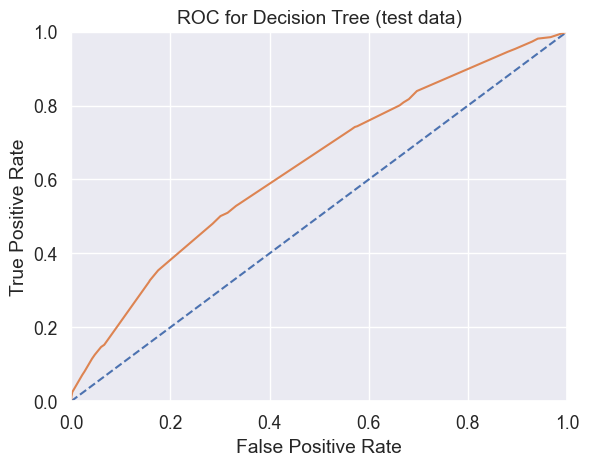

In [303]:
probabilities_test_dt = best_decision_tree_model.predict_proba(X_test_scaled)
probabilities_one_test_dt = probabilities_test_dt[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, probabilities_one_test_dt)

plt.figure()

# ROC-кривая случайной модели (выглядит как прямая)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.plot(fpr, tpr)

# < применим функции plt.xlim() и plt.ylim(), чтобы
#   установим границы осей от 0 до 1 >
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# < применим функции plt.xlabel() и plt.ylabel(), чтобы
#   подпишем оси "False Positive Rate" и "True Positive Rate" >
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# добавим к графику заголовок "ROC-кривая" функцией plt.title() >
plt.title('ROC for Decision Tree (test data)')
plt.show()

In [304]:
auc_roc_dt = roc_auc_score(y_test, probabilities_one_test_dt)
print(f'Decision Tree // model 1 AUC score: {auc_roc_dt}')

Decision Tree // model 1 AUC score: 0.6340088735922069


- **Random Forest**

In [305]:
test_predicted_rf = best_random_forest_model.predict(X_test_scaled)
print("TEST Random Forest Model, F1:", f1_score(y_test, test_predicted_rf))

TEST Random Forest Model, F1: 0.0


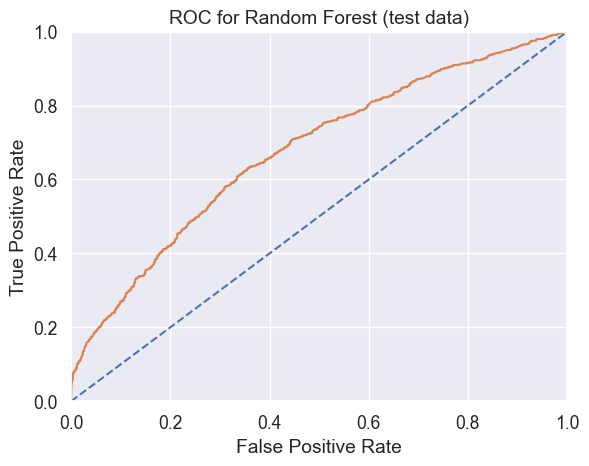

In [306]:
probabilities_test_rf = best_random_forest_model.predict_proba(X_test_scaled)
probabilities_one_test_rf = probabilities_test_rf[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, probabilities_one_test_rf)

plt.figure()

# ROC-кривая случайной модели (выглядит как прямая)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.plot(fpr, tpr)

# < применим функции plt.xlim() и plt.ylim(), чтобы
#   установим границы осей от 0 до 1 >
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# < применим функции plt.xlabel() и plt.ylabel(), чтобы
#   подпишем оси "False Positive Rate" и "True Positive Rate" >
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# добавим к графику заголовок "ROC-кривая" функцией plt.title() >
plt.title('ROC for Random Forest (test data)')
plt.show()

In [307]:
auc_roc_rf = roc_auc_score(y_test, probabilities_one_test_rf)
print(f'Random Forest // model 1 AUC score: {auc_roc_rf}')

Random Forest // model 1 AUC score: 0.6761782525671415


- **Gradient Boosting**

In [308]:
test_predicted_gb = best_gb_model.predict(X_test_scaled)
print("TEST Gradient Boosting Model, F1:", f1_score(y_test, test_predicted_gb))

TEST Gradient Boosting Model, F1: 0.0


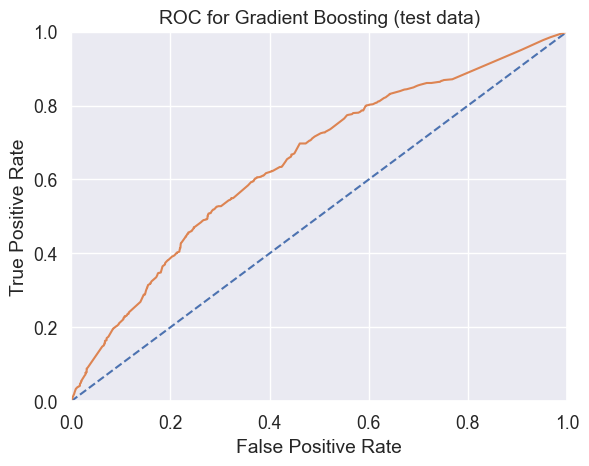

In [309]:
probabilities_test_gb = best_gb_model.predict_proba(X_test_scaled)
probabilities_one_test_gb = probabilities_test_gb[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, probabilities_one_test_gb)

plt.figure()

# ROC-кривая случайной модели (выглядит как прямая)
plt.plot([0, 1], [0, 1], linestyle='--')
plt.plot(fpr, tpr)

# < применим функции plt.xlim() и plt.ylim(), чтобы
#   установим границы осей от 0 до 1 >
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# < применим функции plt.xlabel() и plt.ylabel(), чтобы
#   подпишем оси "False Positive Rate" и "True Positive Rate" >
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# добавим к графику заголовок "ROC-кривая" функцией plt.title() >
plt.title('ROC for Gradient Boosting (test data)')
plt.show()

In [310]:
auc_roc_gb = roc_auc_score(y_test, probabilities_one_test_gb)
print(f'Gradient Boosting // model 1 AUC score: {auc_roc_gb}')

Gradient Boosting // model 1 AUC score: 0.6483676136453913


### *Вывод:* По метрике качества AUC-ROC победил случайный лес, выполним предсказания на модели случайного леса.

## 5.2 Предсказания вероятности на модели случайного леса

In [319]:
X_test.shape

(11997, 58)

In [320]:
# Random Forest
y_pred_rf = best_random_forest_model.predict(X_test_scaled)
y_pred_rf

array([0, 0, 0, ..., 0, 0, 0])

In [321]:
X_test_df = test_dropped.drop(columns=['target'])
acual_test_pred = X_test_df[['reco_id_curr', 'children_count', 'income', 'loan_body']]

In [322]:
best_random_forest_model.predict_proba(X_test_scaled)[:, 1]

array([0.02334046, 0.0461283 , 0.07545578, ..., 0.04303323, 0.04961519,
       0.23285188])

In [323]:
acual_test_pred['predictions'] = best_random_forest_model.predict(X_test_scaled)

In [331]:
acual_test_pred['target'] = np.round(best_random_forest_model.predict_proba(X_test_scaled),3)[:, 1]
acual_test_pred

,reco_id_curr,children_count,income,loan_body,predictions,target
88100,100974,0,135000.0,219042.0,0,0.023
94312,256911,0,180000.0,254700.0,0,0.046
44136,173170,1,180000.0,540000.0,0,0.075
6323,200418,0,274500.0,1278594.0,0,0.049
97409,119372,0,225000.0,202500.0,0,0.058
...,...,...,...,...,...,...
17298,172269,0,135000.0,497520.0,0,0.075
23145,124261,0,112500.0,755190.0,0,0.081
19264,283454,0,247500.0,1467612.0,0,0.043
17268,178779,0,90000.0,255960.0,0,0.050


In [332]:
answer = acual_test_pred[['reco_id_curr', 'target']]

In [333]:
answer.to_csv('/Users/yuliabezginova/PycharmProjects/00_files-for_NLP/shift_ml_winter_2023/answer.csv', index=False)

## 5.3 Определим, какие из признаков больше всего влияют на целевой признак

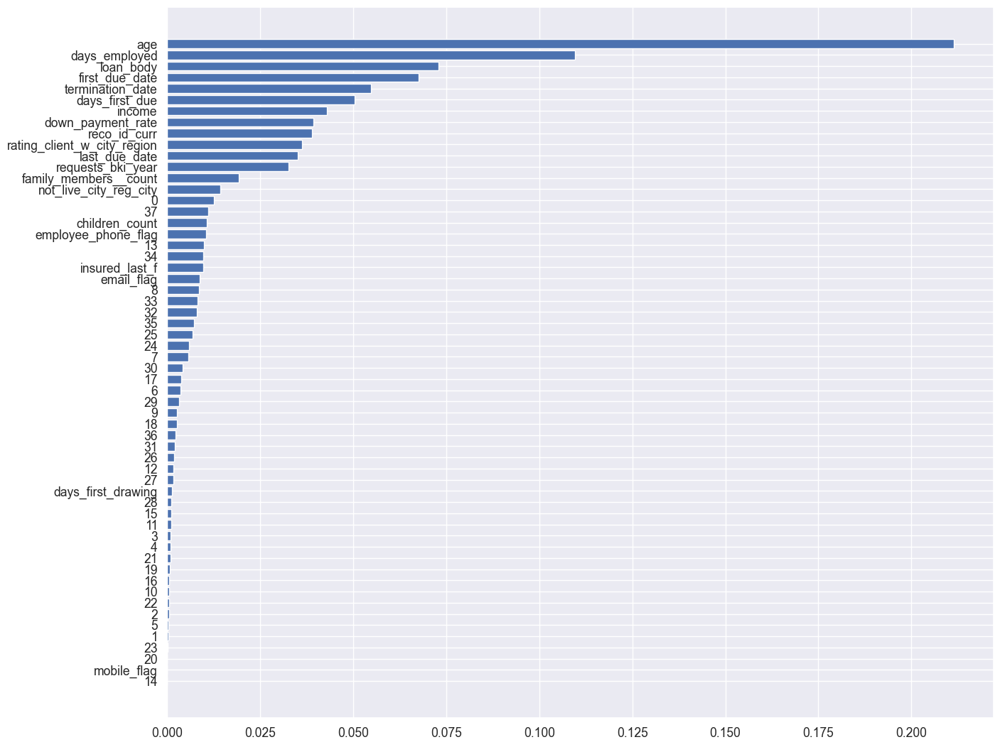

In [354]:
importance = best_random_forest_model.best_estimator_.feature_importances_
indices = np.argsort(importance)

fig, ax = plt.subplots(figsize=(15, 13))
ax.barh(range(len(importance)), importance[indices])
ax.set_yticks(range(len(importance)))
_ = ax.set_yticklabels(np.array(X_test.columns)[indices])

### *Вывод:* Больше всего на целевой признак - *вернет ли клиент кредит банку* - влияют следующие признаки:
- **Возраст заемщика** ```age``` - средний возраст в выборке составляет 44.6 лет; описательные статистики показывают, после 40 лет люди скорее возвращают, чем не возвращают кредиты:

```
0    43.480 лет
1    39.115 лет
```

- **Размер кредита** ```loan_body``` - средний размер займа 603717 руб.; описательные статистики показывают, что меньшие по размеру кредиты (менее 500 тыс. руб) возвращаются хуже, чем займы свыше 500 тыс. руб.
```
0    517788.0 руб
1    497520.0 руб
```

- **Тип занятости** ```type_of_occupation``` - описательные статистики показывают, что активнее всего берут кредиты рядовые специалисты, среди них же - больше всего невозвратов; в целом, по выборке число заемщиков, которые НЕ вернули кредит составляет не более 5-7%;
- **Доход клиента** ```income``` - средний доход заемщика - 168-175 тыс. руб в год; также изучение описательных статистик показывает, что клиенты с меньшим доходом скорее НЕ возвращают кредиты:
```
0    148500.0 руб
1    135000.0 руб
```

Также на вероятность возврата кредита банку влияют следующие признаки:
- **Тип дохода клиента (businessman, working, maternity leave,…)** ```income_type_name```
- **Ставка первоначального взноса, нормированная по предыдущему займу** ```down_payment_rate```;
- **За сколько дней до оформления займа человек начал текущую работу** - ```days_employed```;
- **Когда была первая и последняя выплаты по предыдущему займу относительно даты оформления текущего займа** ```first_due_date```, ```last_due_date```;
- **Когда было ожидаемое закрытие предыдущего займа относительно даты оформления текущего займа** ```termination_date```;
- **Когда должна была быть первая выплата по предыдущему займу относительно даты оформления текущего займа** ```days_first_due```

#### Влияние в меньшей степени на возврат кредита оказывают количество детей, тип образования, лояльность клиента к банку, согласие получать маркетинговые материалы по электронной почте.

### Опираясь на результаты данного исследования, банку может быть рекомендовано учитывать наиболее важные признаки при разработке системы кредитного скоринга.
